**1) skforecast : Libreria orientada al forecasting, basado en el uso de la libreria sklearn**

**2)statsmodel: Libreria orientada al analisis estadístico, incluido modelos en series de tiempo**

Los codigos ejemplos desarrollados tienen como base los codigos ejemplo de las siguientes paginas (y paginas vinculadas):<br>
- https://joaquinamatrodrigo.github.io/skforecast/0.5.1/examples/examples.html
- https://www.statsmodels.org/stable/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html#statsmodels.tsa.statespace.sarimax.SARIMAX

# Librerias y Datasets

In [1]:
# (Ejecutar!!) librerias

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import grid_search_forecaster

from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

from catboost import CatBoostRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

from statsmodels.tsa.seasonal import seasonal_decompose

# Guardar/cargar modelos
from joblib import dump, load

import warnings
warnings.filterwarnings('ignore')

In [2]:
# (Ejecutar!!) Funciones a utilizar 

# Funcion para visualizar las autocorrelaciones
def autocorrela(df1,n_lags=10,figx=7,figy=3,col_fecha="datetime",col_valores="y"):
    # copia dataframe
    df = df1.copy()
    
    fig,ax = plt.subplots(1,1,figsize=(figx,figy))
    plot_acf(df[col_valores],lags=n_lags,ax=ax)
    plt.ylim([-1.1,1.1])
    plt.title('Autocorrelacion')
    plt.xlabel('Atraso [lag]')
    plt.show()

    fig,ax = plt.subplots(1,1,figsize=(figx,figy))
    plot_pacf(df[col_valores],lags=n_lags,method='ywm',ax=ax)
    plt.ylim([-1.1,1.1])
    plt.title('Autocorrelacion Parcial')
    plt.xlabel('Atraso [lag]')
    plt.show()
    
    # grafico de linea
    df[col_fecha] = df.index
    df.plot(col_fecha,col_valores,figsize=(figx,figy))
    plt.show()

##########################################################
# Diferencia e integracion en tiempo discreto

## NOTA: Ambas funciones dependen entre si. Porque diferencia
## genera una lista de "valores iniciales", el cual debe ser
## indicado a integracion para poder recrear los datos iniciales

def diferencia(df1,orden,col_valores="y"):
    # copia dataframe
    dff = df1.copy()
    
    # almacenar valores iniciales para la integracion
    valor_inicio = []
    for i in range(orden):    
        valor_inicio.append(dff.iloc[i][col_valores])
        dff[col_valores] = dff[col_valores] - dff[col_valores].shift(+1)
    return dff,valor_inicio

def integracion(df1,valor_inicio=[],col_valores="y"):
    # copia dataframe
    dff = df1.copy()
    
    for i in list(range(len(valor_inicio)))[::-1]:    
        dff.iloc[i][col_valores] = valor_inicio[i] 
        dff[col_valores] = dff[col_valores].cumsum()
    return dff

#########################################################

def grafica_delta(df1,orden=0,figx=7,figy=3,col_fecha="datetime",col_valores="y"):
    # copia dataframe
    df = df1.copy()
    
    # grafico de linea
    df[col_fecha] = df.index
    
    # Calcular diferencias segun columna
    df,_ = diferencia(df.copy(),orden=orden,col_valores=col_valores)  
    
    # Graficar
    df.plot(col_fecha,col_valores,figsize=(figx,figy))
    plt.title('Diferencial de orden:' + str(orden))
    plt.show()

## Teoria: Diferenciación e integración en tiempo discreto

En muchas situaciones los datos en series de tiempo se deben diferenciar, con esto nos referimos a aplicar una derivada pero usando tiempos discretos, dado que no poseemos datos continuos. Primero, esta derivada no es "puntual" en el sentido continuo, sino que es una aproximacion como dy(k) = y(k) - y(k-1). Por el otro lado, con dicha señal diferenciada se busca poder retornar a sus valores originales mediante la integración. Para lograr integrar debemos guardar los "offsets iniciales", ya que al diferenciar perdemos rastro de los offsets iniciales que nos permitiran recrear. 

In [103]:
# datos ejemplo
df

,y
datetime,
1985-01-01,72.5052
1985-02-01,70.6720
1985-03-01,62.4502
1985-04-01,57.4714
1985-05-01,55.3151
...,...
2017-09-01,98.6154
2017-10-01,93.6137
2017-11-01,97.3359


In [104]:
# Obtener la diferencial orden 3
u,vi = diferencia(df,orden=3,col_valores="y")
print("Valores iniciales (offset):",vi)
u

Valores iniciales (offset): [72.5052, -1.833200000000005, -6.38859999999999]


,y
datetime,
1985-01-01,NaN
1985-02-01,NaN
1985-03-01,NaN
1985-04-01,9.6316
1985-05-01,-0.4205
...,...
2017-09-01,6.1300
2017-10-01,12.4073
2017-11-01,3.4098


In [105]:
# integracion segun valores diferenciados
integracion(u,vi,col_valores="y")

,y
datetime,
1985-01-01,72.5052
1985-02-01,70.6720
1985-03-01,62.4502
1985-04-01,57.4714
1985-05-01,55.3151
...,...
2017-09-01,98.6154
2017-10-01,93.6137
2017-11-01,97.3359


## Conjunto de datos ejemplo

Aqui se dejan algunos datasets que se obtuvieron de Kaggle. Tener cuidado que los datos al ser raw, requieren un tratamiento de perfilamiento (tipo de variable, nombres, etc) y limpieza previos a ser usados.

Nota: La teoria de indicar la frecuencia del periodo de tiempo es: https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases

Algunos codigos de frecuencia:
- B: business day
- D: calendar day
- W: weekly
- M: month end
- SM: semi-month end (15th and end of month)
- BM: business month
- MS: month start
- SMS: semi-month start (1st and 15th)
- A,Y: year
- H: hourly
- T: minutely
- S: scondly
- L: miliseconds
- U: microseconds
- N: nanoseconds

Cantidad registros inicio raw : 36
Cantidad registros seteo freq : 36
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


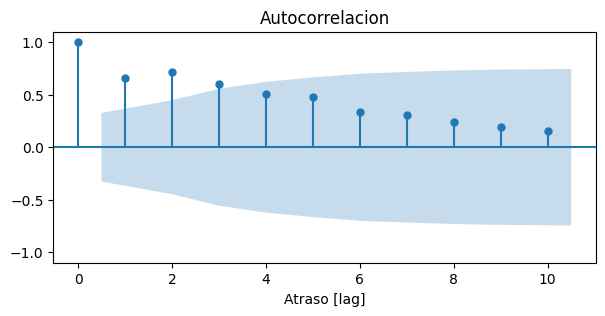

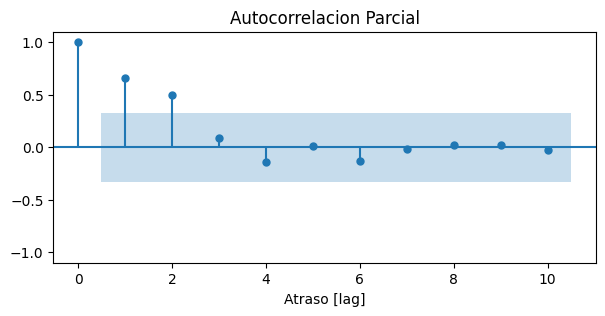

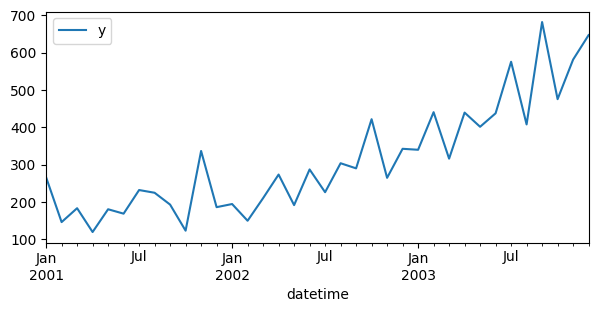

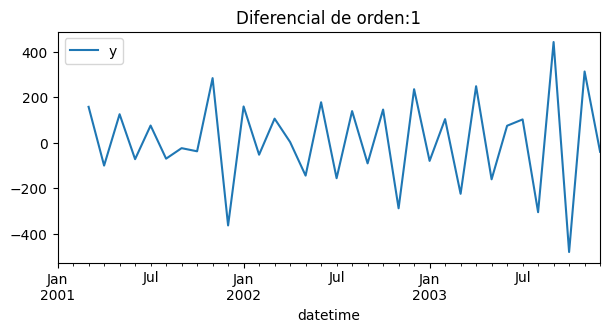

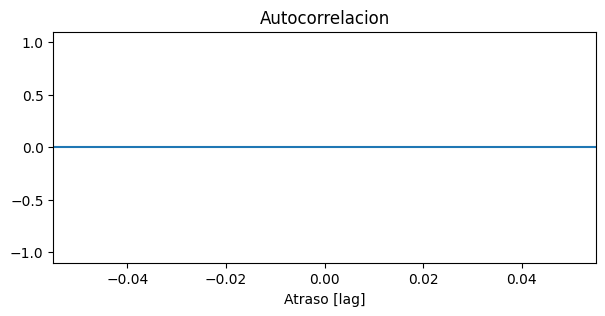

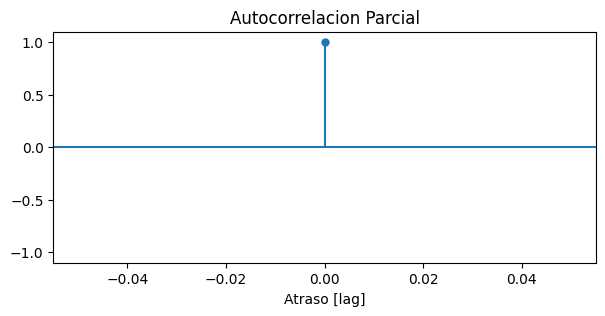

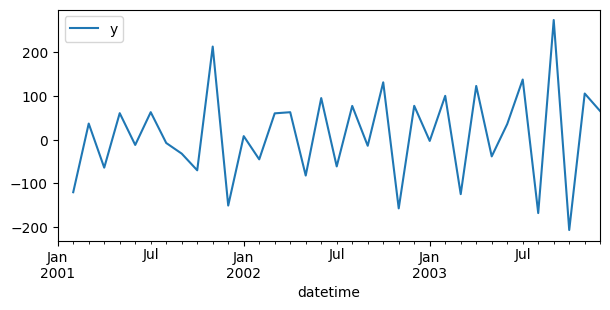

Cantidad registros: 36


,y
datetime,
2001-01-01,266.0
2001-02-01,145.9
2001-03-01,183.1
2001-04-01,119.3
2001-05-01,180.3
2001-06-01,168.5
2001-07-01,231.8
2001-08-01,224.5
2001-09-01,192.8


In [33]:
# Datos 1 - venta de shampo de 3 años

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/sales-of-shampoo-over-a-three-ye.csv"
df = pd.read_csv(url)

###################################
year_set = 2000

def fecha(x):
    global year_set
    cadena = x.split("-")
    return str(int(cadena[0])+year_set) + "-" + cadena[1]
####################################

# Columna de tiempo
var_tiempo = "Month"

# Correccion de tiempo (AUXILIAR !!!!)
df[var_tiempo] = df[var_tiempo].apply(fecha)

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y-%m'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Sales of shampoo over a three year period":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=10,figx=7)

# Ver valores en diferencia (derivada en tiempo discreto)
dff1,_ = diferencia(df,orden=1,col_valores="y")
grafica_delta(dff1,orden=1,figx=7,figy=3)
autocorrela(dff1,n_lags=10,figx=7)

print('Cantidad registros:',df.shape[0])
df # ver df

Descomposición segun modelo aditivo


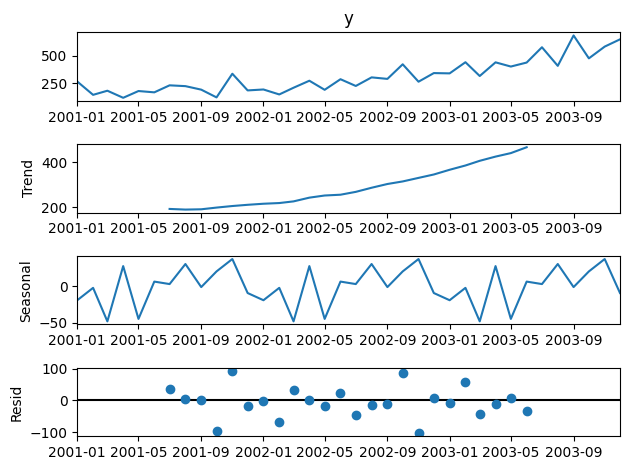

Descomposición segun modelo multiplicativo


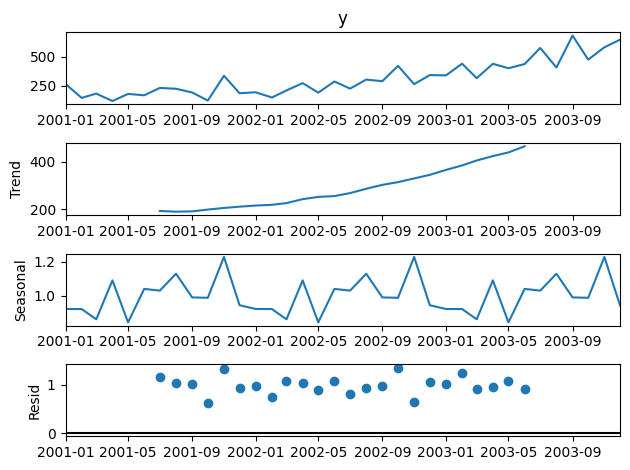

In [34]:
## Descomposicion de señal

############################################
# [modelo Aditivo] Descomposicion de señal

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

############################################
decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

Cantidad registros inicio raw : 397
Cantidad registros seteo freq : 397
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


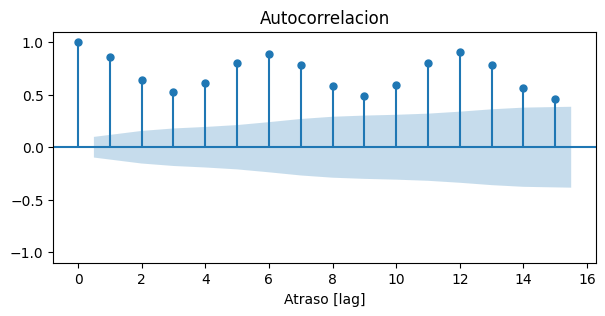

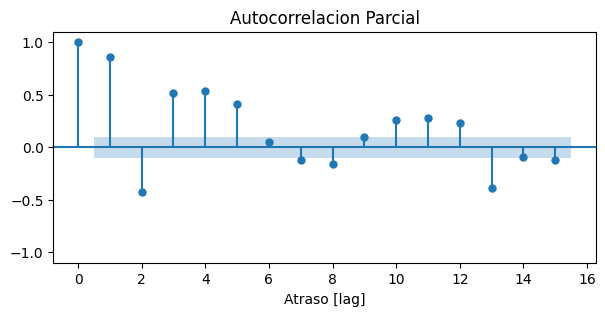

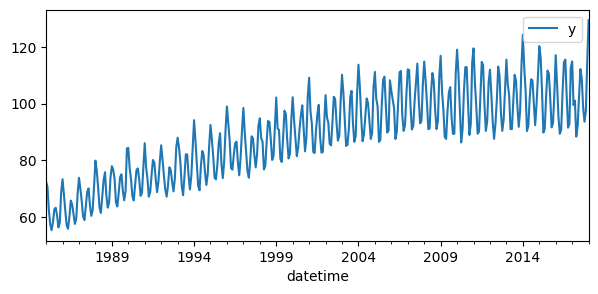

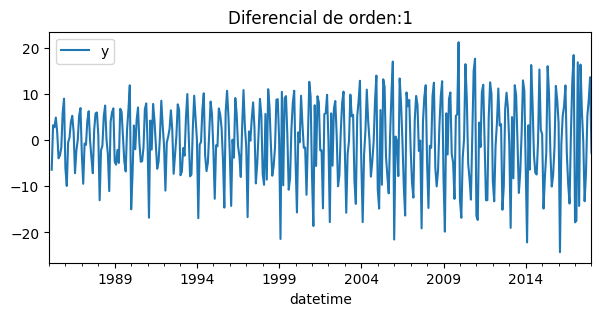

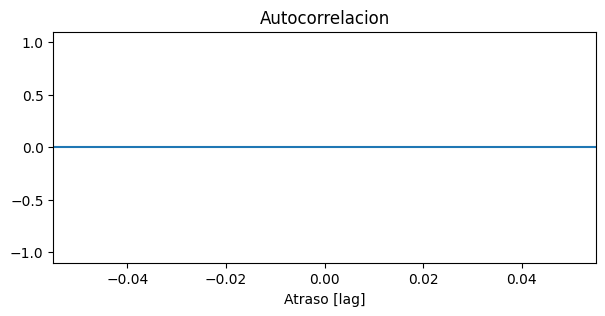

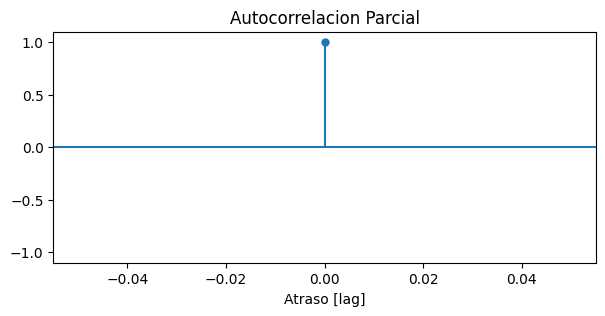

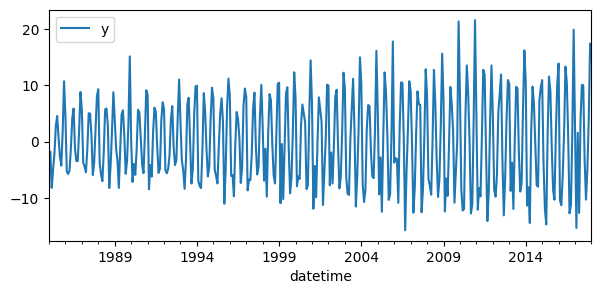

Cantidad registros: 397


,y
datetime,
1985-01-01,72.5052
1985-02-01,70.6720
1985-03-01,62.4502
1985-04-01,57.4714
1985-05-01,55.3151
...,...
2017-09-01,98.6154
2017-10-01,93.6137
2017-11-01,97.3359


In [35]:
# Datos 2 - produccion de electricidad

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/Electric_Production.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "DATE"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%d-%m-%Y'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"IPG2211A2N":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=15) 

# Ver valores en diferencia (derivada en tiempo discreto)
dff1,_ = diferencia(df,orden=1,col_valores="y")
grafica_delta(dff1,orden=1,figx=7,figy=3)
autocorrela(dff1,n_lags=15,figx=7)

print('Cantidad registros:',df.shape[0])
df # ver df

Descomposición segun modelo aditivo


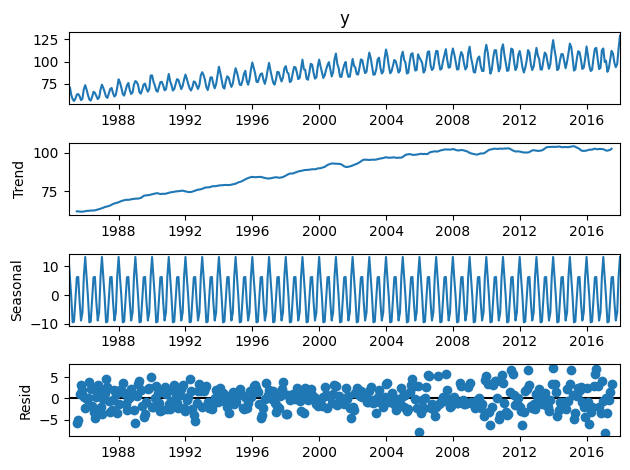

Descomposición segun modelo multiplicativo


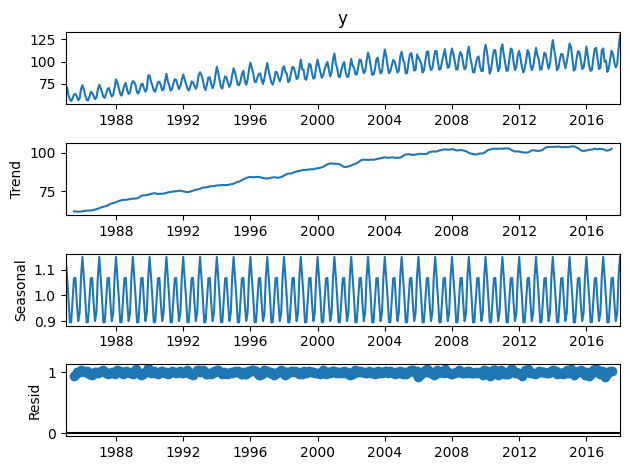

In [36]:
## Descomposicion de señal

############################################
# [modelo Aditivo] Descomposicion de señal

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

############################################
decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

Cantidad registros inicio raw : 476
Cantidad registros seteo freq : 476
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


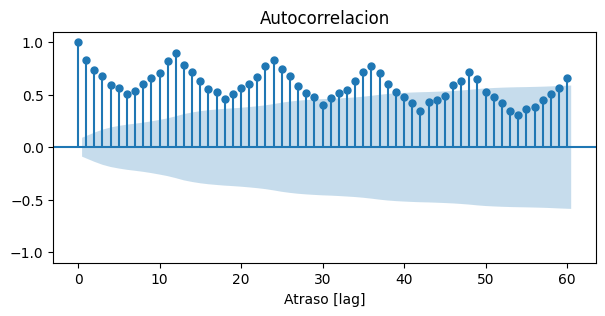

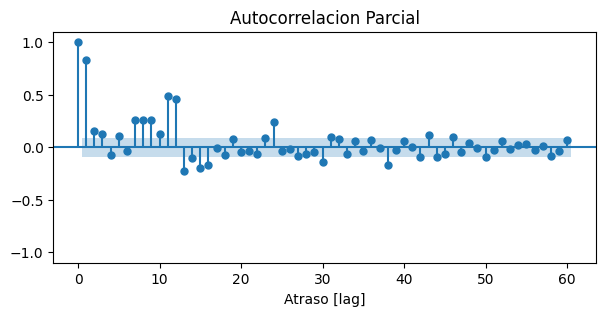

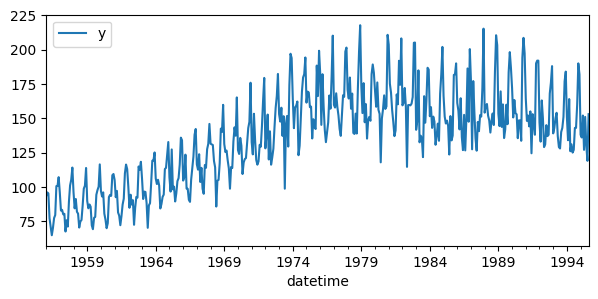

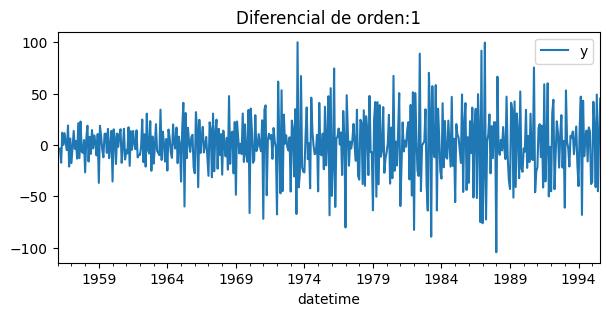

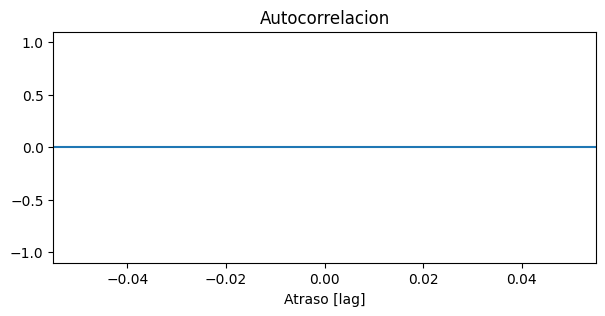

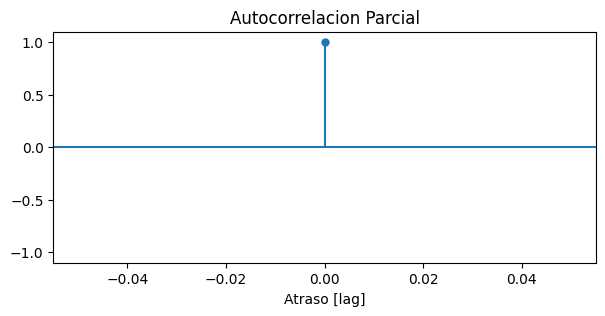

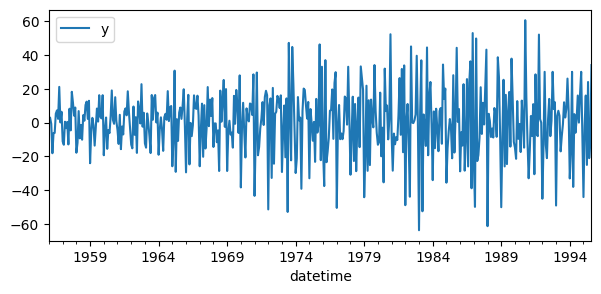

Cantidad registros: 476


,y
datetime,
1956-01-01,93.2
1956-02-01,96.0
1956-03-01,95.2
1956-04-01,77.1
1956-05-01,70.9
...,...
1995-04-01,127.0
1995-05-01,151.0
1995-06-01,130.0


In [37]:
# Datos 3 - produccion de cerveza en australia

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/monthly-beer-production-in-austr.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "Month"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo],format="%Y-%m")

# Dar formato a estampa de tiempo
formato = '%Y-%m'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Monthly beer production":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=60) 

# Ver valores en diferencia (derivada en tiempo discreto)
dff1,_ = diferencia(df,orden=1,col_valores="y")
grafica_delta(dff1,orden=1,figx=7,figy=3)
autocorrela(dff1,n_lags=60,figx=7)

print('Cantidad registros:',df.shape[0])
df # ver df

Descomposición segun modelo aditivo


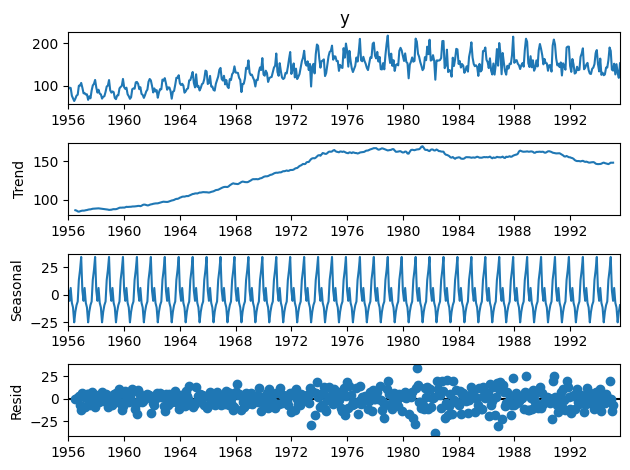

Descomposición segun modelo multiplicativo


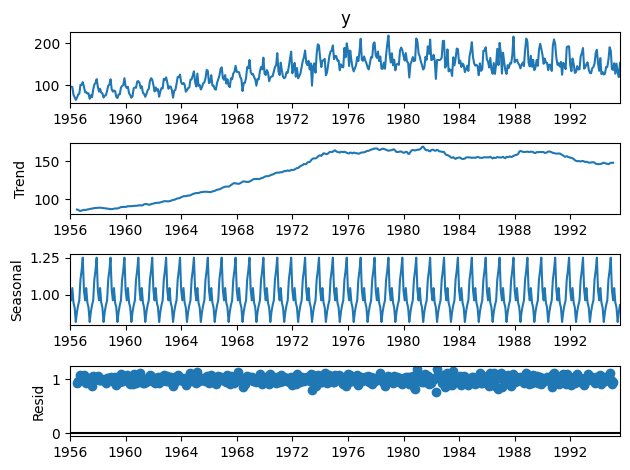

In [38]:
## Descomposicion de señal

############################################
# [modelo Aditivo] Descomposicion de señal

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

############################################
decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

Cantidad registros inicio raw : 3650
Cantidad registros seteo freq : 3652
Datos con NaN - pre datos raw : 5
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


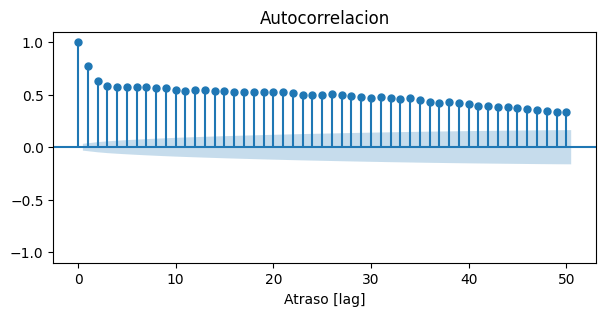

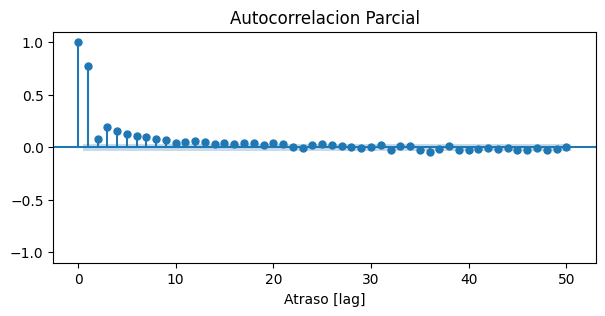

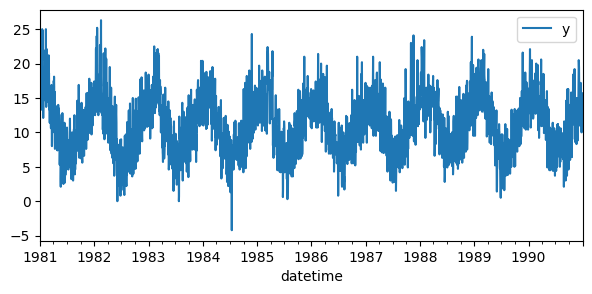

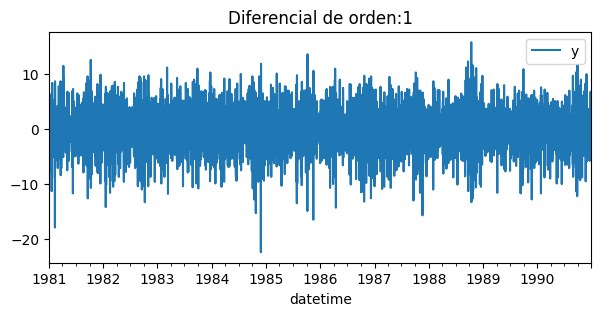

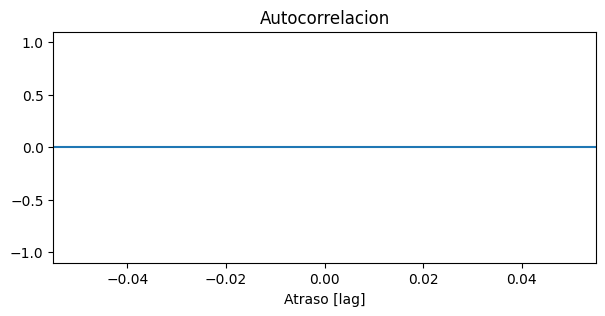

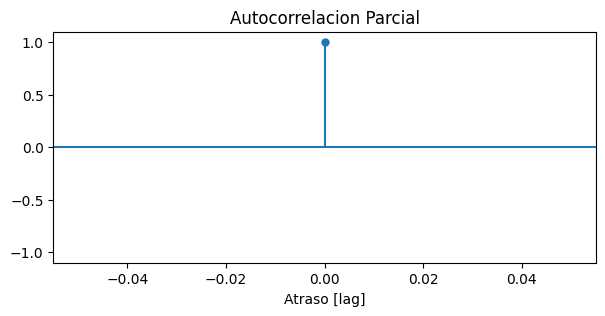

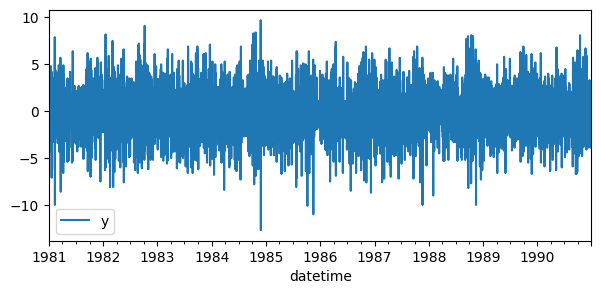

Cantidad registros: 3652


,y
datetime,
1981-01-01,20.7
1981-01-02,17.9
1981-01-03,18.8
1981-01-04,14.6
1981-01-05,15.8
...,...
1990-12-27,14.0
1990-12-28,13.6
1990-12-29,13.5


In [39]:
# Datos 4 - temperaturas minimas

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/daily-minimum-temperatures-in-me.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "Date"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y-%m-%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="D")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=50) 

# Ver valores en diferencia (derivada en tiempo discreto)
dff1,_ = diferencia(df,orden=1,col_valores="y")
grafica_delta(dff1,orden=1,figx=7,figy=3)
autocorrela(dff1,n_lags=50,figx=7)

print('Cantidad registros:',df.shape[0])
df # ver df

Descomposición segun modelo aditivo


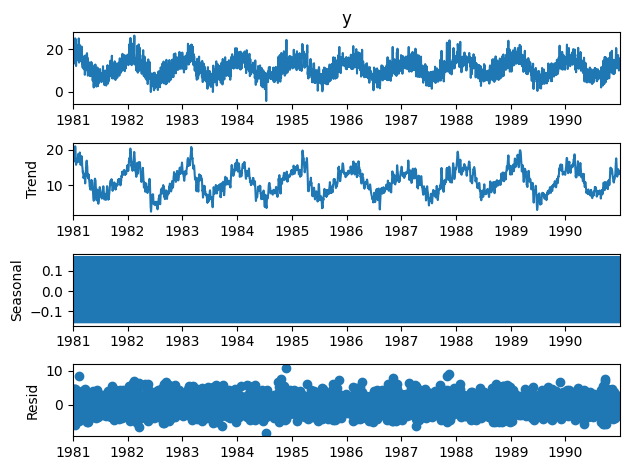

In [40]:
## Descomposicion de señal

############################################
# [modelo Aditivo] Descomposicion de señal

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


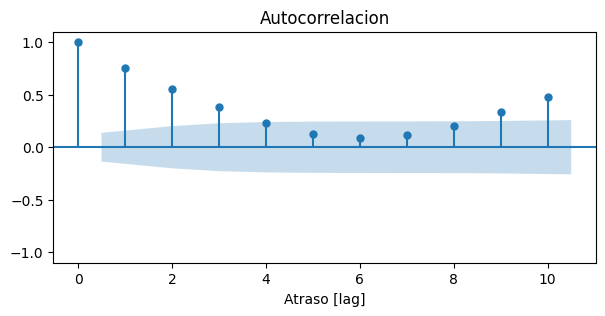

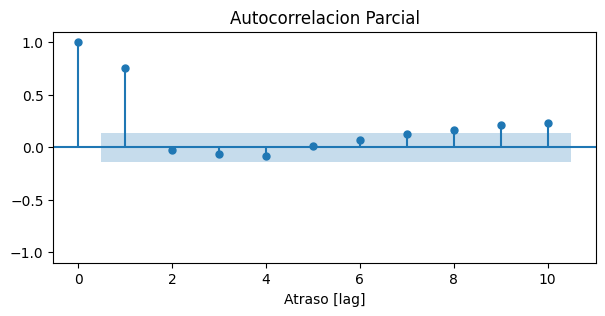

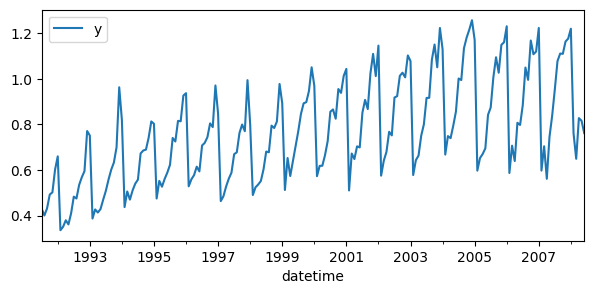

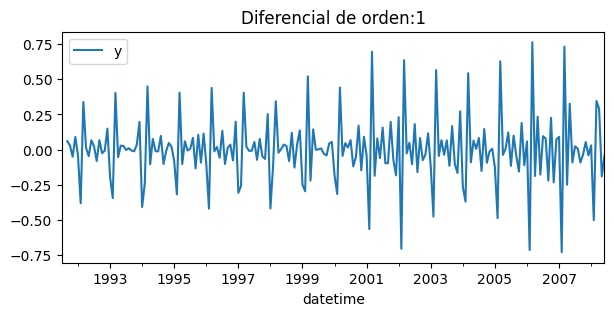

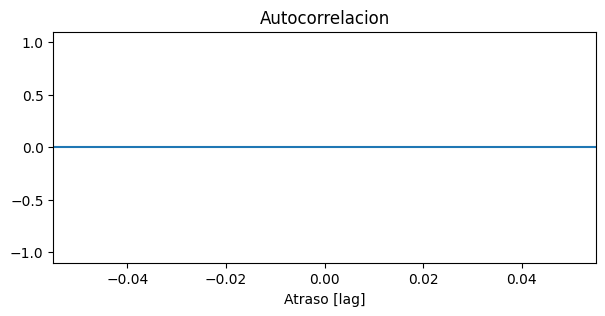

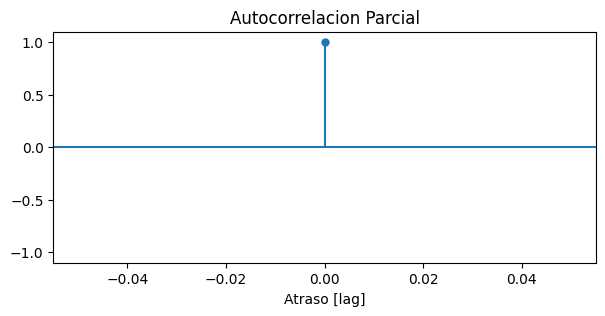

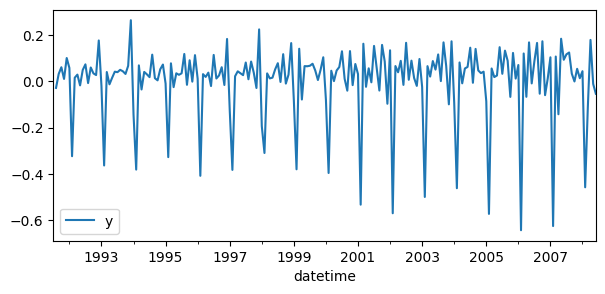

Cantidad registros: 204


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


In [41]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=10) 

# Ver valores en diferencia (derivada en tiempo discreto)
dff1,_ = diferencia(df,orden=1,col_valores="y")
grafica_delta(dff1,orden=1,figx=7,figy=3)
autocorrela(dff1,n_lags=10,figx=7)

print('Cantidad registros:',df.shape[0])
df # ver df

Descomposición segun modelo aditivo


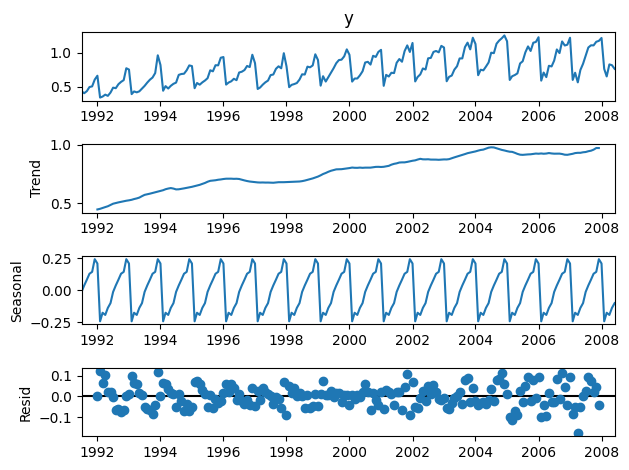

Descomposición segun modelo multiplicativo


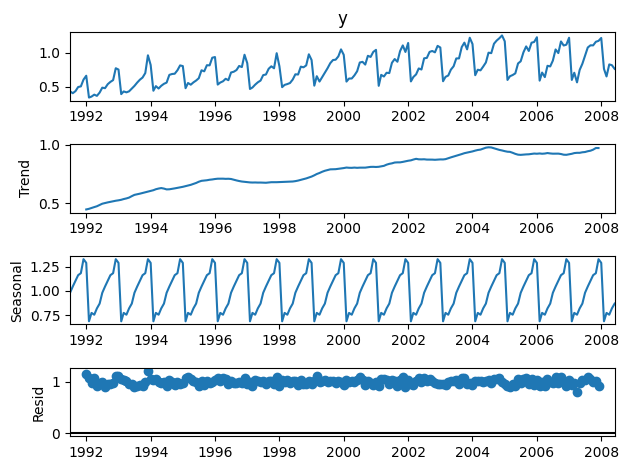

In [42]:
## Descomposicion de señal

############################################
# [modelo Aditivo] Descomposicion de señal

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

############################################
decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

# Parte 1 - Modelo simple - (Puesta en Producción)

Este bloque incluye desde la lectura y preparación de datos, hasta el empaquetado (serializado de modelo) para la puesta en producción. Con el modelo serializado en un archivo, el cual sirve para la productivización, se mostrará ejemplos de predicción con diferentes datos de entrada.

In [26]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


In [27]:
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

train_df.shape, test_df.shape

((184, 1), (20, 1))

## Ejemplo con CatboostRegressor

In [28]:
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=True,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])
forecaster

0:	learn: 0.2023876	total: 134ms	remaining: 1m 7s
1:	learn: 0.1974660	total: 135ms	remaining: 33.6s
2:	learn: 0.1926002	total: 136ms	remaining: 22.5s
3:	learn: 0.1881466	total: 136ms	remaining: 16.9s
4:	learn: 0.1840410	total: 137ms	remaining: 13.5s
5:	learn: 0.1795834	total: 137ms	remaining: 11.3s
6:	learn: 0.1753131	total: 138ms	remaining: 9.72s
7:	learn: 0.1713040	total: 139ms	remaining: 8.53s
8:	learn: 0.1675726	total: 139ms	remaining: 7.59s
9:	learn: 0.1639595	total: 140ms	remaining: 6.85s
10:	learn: 0.1602111	total: 140ms	remaining: 6.24s
11:	learn: 0.1566861	total: 141ms	remaining: 5.73s
12:	learn: 0.1532521	total: 142ms	remaining: 5.3s
13:	learn: 0.1496952	total: 142ms	remaining: 4.93s
14:	learn: 0.1463874	total: 143ms	remaining: 4.61s
15:	learn: 0.1430791	total: 143ms	remaining: 4.33s
16:	learn: 0.1398230	total: 144ms	remaining: 4.09s
17:	learn: 0.1365806	total: 144ms	remaining: 3.87s
18:	learn: 0.1334421	total: 145ms	remaining: 3.67s
19:	learn: 0.1305031	total: 146ms	remainin

336:	learn: 0.0136716	total: 337ms	remaining: 163ms
337:	learn: 0.0136129	total: 337ms	remaining: 162ms
338:	learn: 0.0135359	total: 338ms	remaining: 161ms
339:	learn: 0.0134611	total: 339ms	remaining: 160ms
340:	learn: 0.0134045	total: 340ms	remaining: 158ms
341:	learn: 0.0133519	total: 340ms	remaining: 157ms
342:	learn: 0.0132689	total: 341ms	remaining: 156ms
343:	learn: 0.0132031	total: 342ms	remaining: 155ms
344:	learn: 0.0131674	total: 342ms	remaining: 154ms
345:	learn: 0.0131344	total: 343ms	remaining: 153ms
346:	learn: 0.0130617	total: 344ms	remaining: 152ms
347:	learn: 0.0129862	total: 344ms	remaining: 150ms
348:	learn: 0.0129230	total: 345ms	remaining: 149ms
349:	learn: 0.0128660	total: 346ms	remaining: 148ms
350:	learn: 0.0128092	total: 346ms	remaining: 147ms
351:	learn: 0.0127183	total: 347ms	remaining: 146ms
352:	learn: 0.0126452	total: 348ms	remaining: 145ms
353:	learn: 0.0125837	total: 348ms	remaining: 144ms
354:	learn: 0.0125249	total: 349ms	remaining: 143ms
355:	learn: 

ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280FA96F700> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'iterations': 500, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': True, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:14:34 
Last fit date: 2022-11-13 10:14:35 
Skforecast version: 0.5.1 
Python version: 3.9.13 

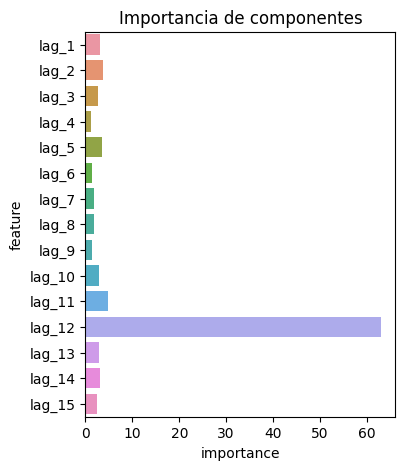

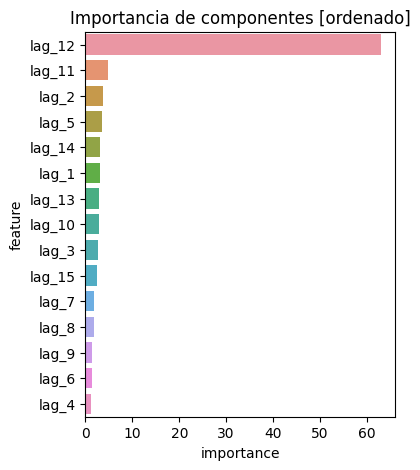

In [29]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [30]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

2006-11-01    1.122600
2006-12-01    1.203323
2007-01-01    1.155518
2007-02-01    0.633177
2007-03-01    0.688657
2007-04-01    0.681756
2007-05-01    0.789109
2007-06-01    0.835968
2007-07-01    0.936569
2007-08-01    1.006442
2007-09-01    1.085628
2007-10-01    1.097511
2007-11-01    1.149490
2007-12-01    1.194484
2008-01-01    1.194621
2008-02-01    0.647792
2008-03-01    0.695562
2008-04-01    0.700434
2008-05-01    0.774123
2008-06-01    0.836448
Freq: MS, Name: pred, dtype: float64

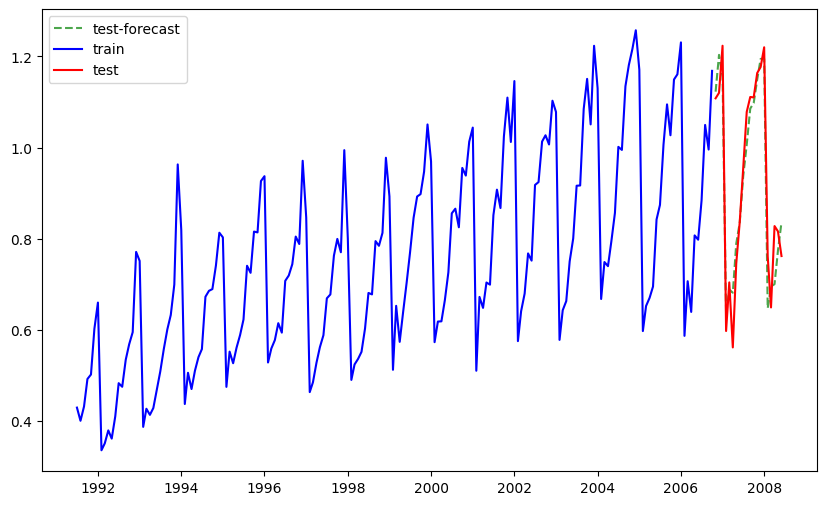

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.242


In [31]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

Guardar y leer modelo

In [32]:
# Guardar modelo en archivo

nombre_archivo = "modelo_catboost.py"
dump(forecaster,nombre_archivo)
print('Se guardo modelo en:',nombre_archivo)

Se guardo modelo en: modelo_catboost.py


In [33]:
# leer modelo de archivo

nombre_archivo = "modelo_catboost.py"
forecaster = load(nombre_archivo)

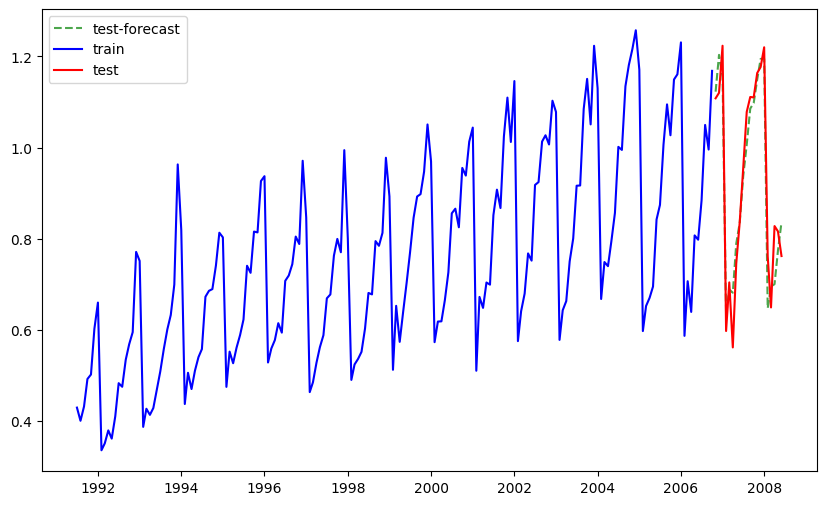

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.242


In [34]:
# Prediccion con modelo leido

pred_df_new = forecaster.predict(steps=test_df.shape[0])

##############################

# Visualizar prediccion
v3 = pred_df_new.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

Prediccion en otros valores y variación de valores input

---------------------------------------------


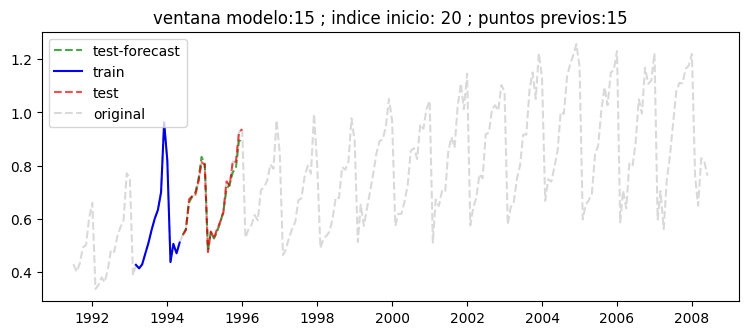

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.013


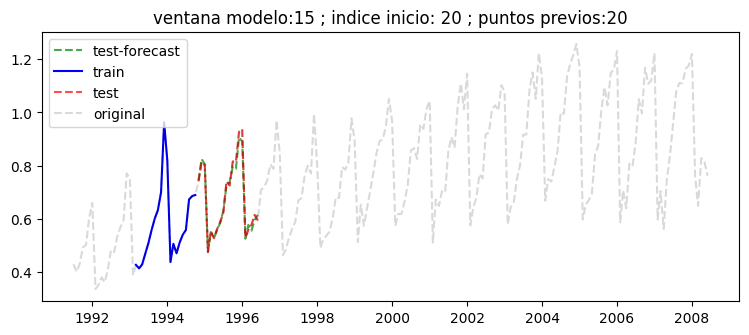

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.013


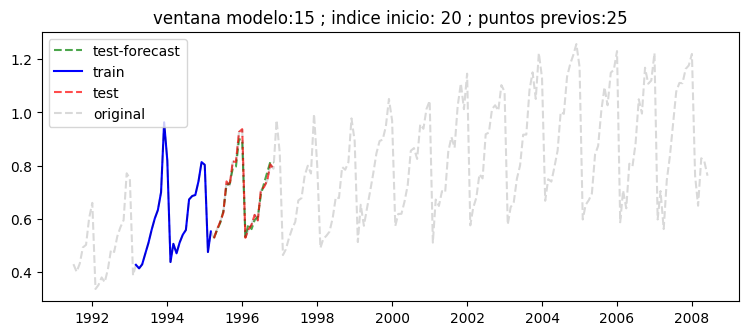

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015
---------------------------------------------


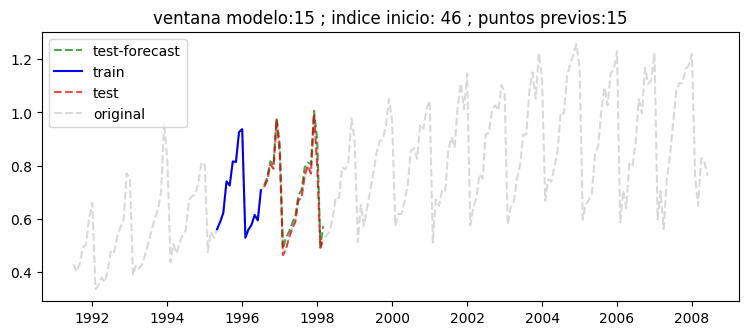

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


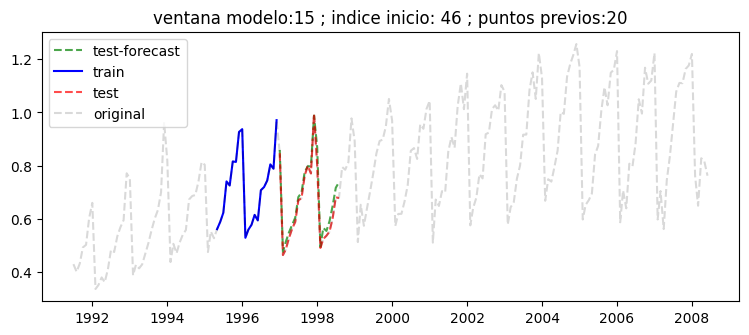

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


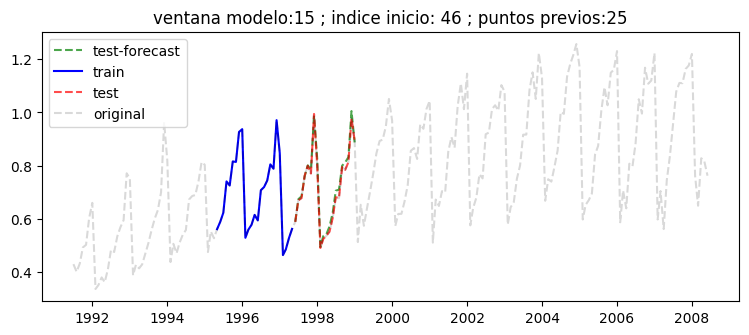

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.013
---------------------------------------------


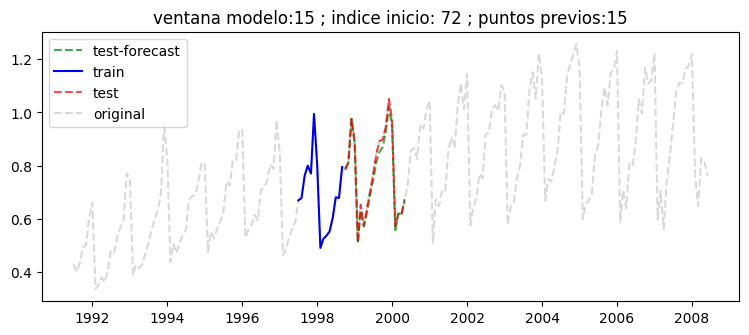

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016


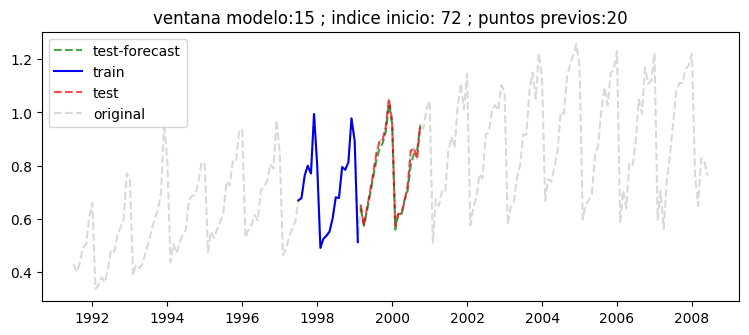

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016


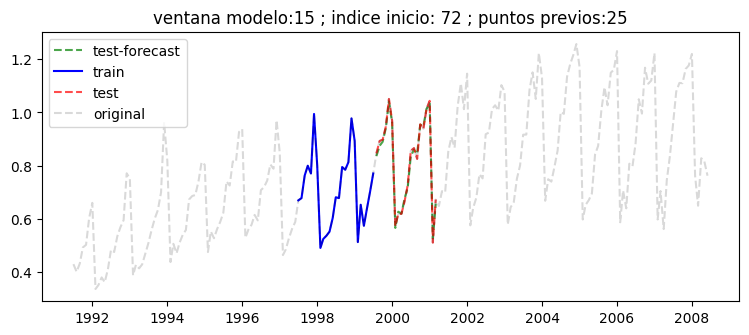

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.010
---------------------------------------------


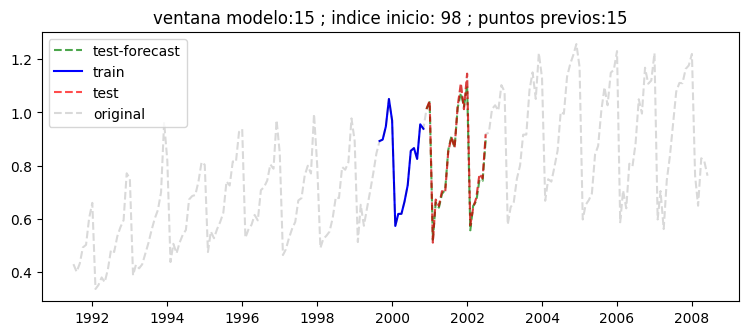

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.013


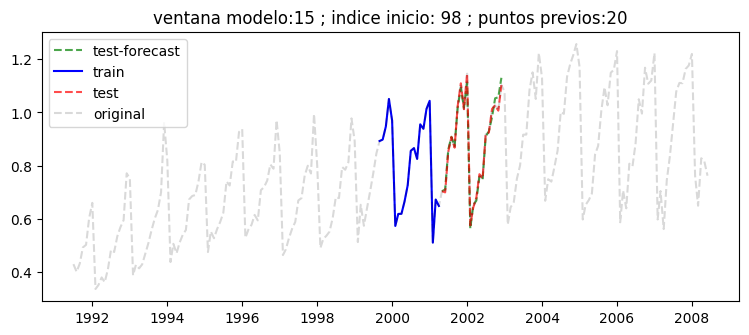

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.014


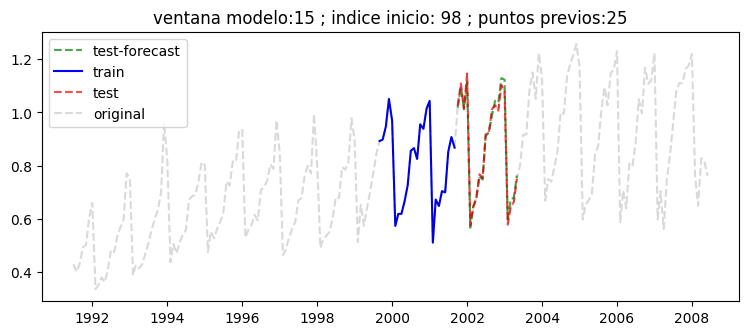

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016
---------------------------------------------


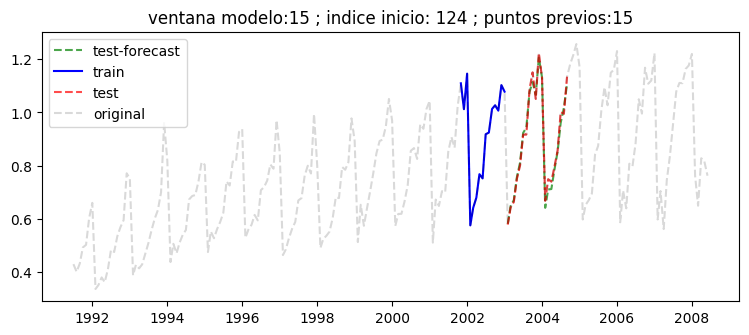

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017


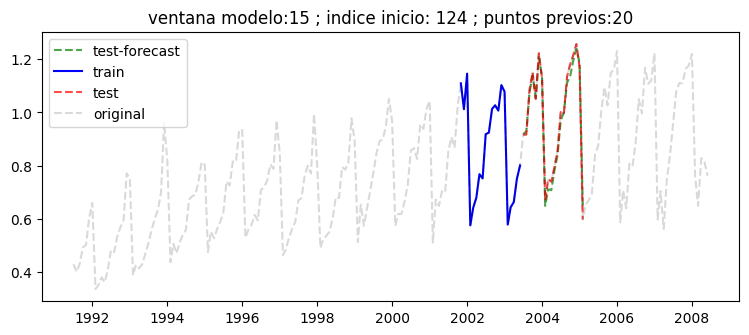

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.020


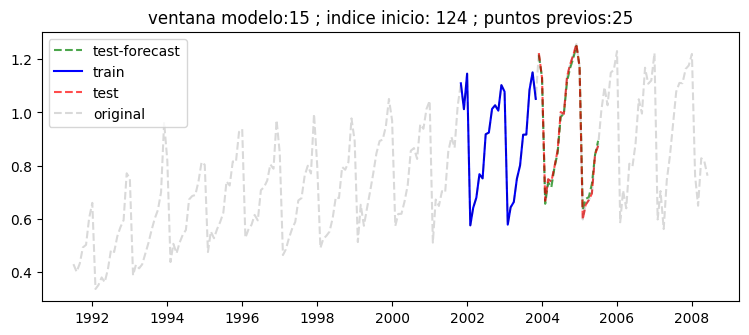

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.013
---------------------------------------------


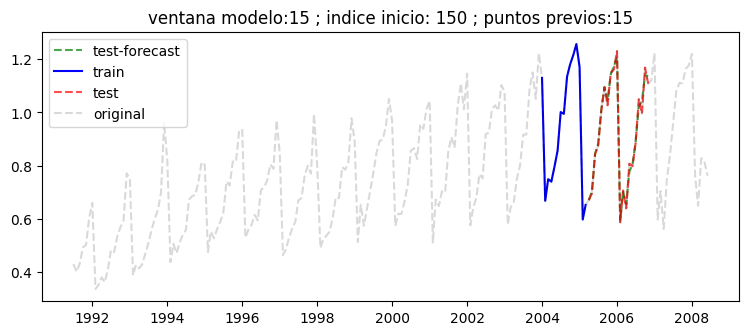

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015


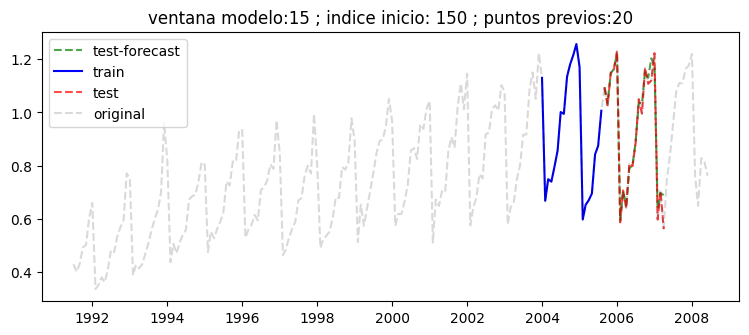

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.023


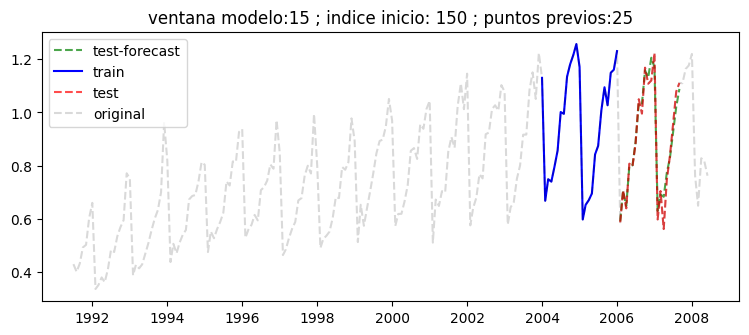

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.028


In [35]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        
        try:
            # extraer datos input al modelo
            df_previos = df.iloc[ii:ii+largo]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()
            
            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

---------------------------------------------


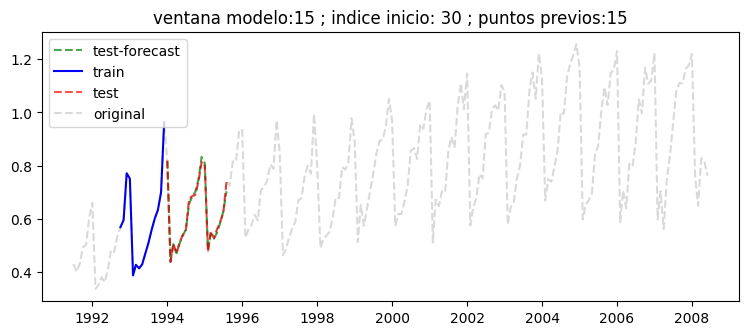

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008


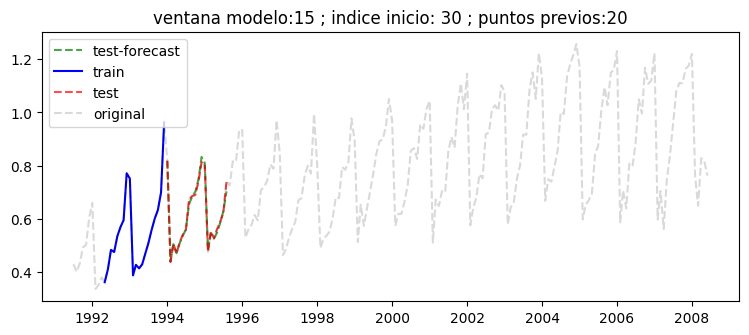

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008


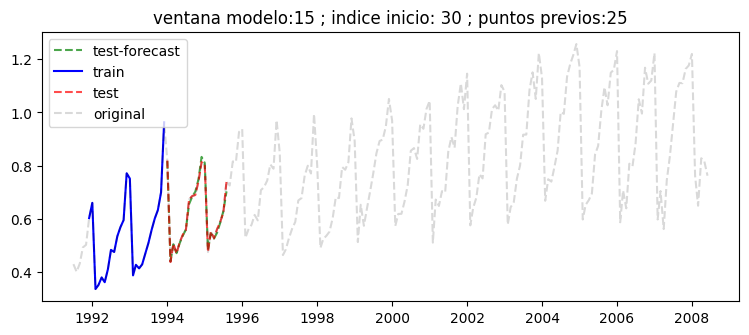

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008
---------------------------------------------


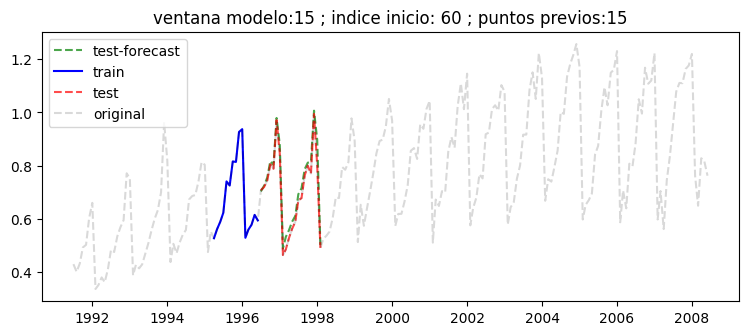

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


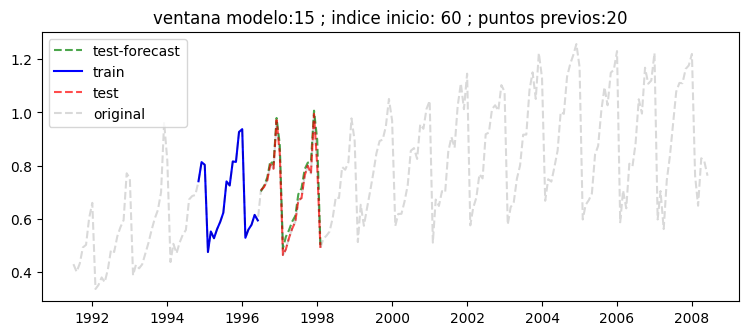

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


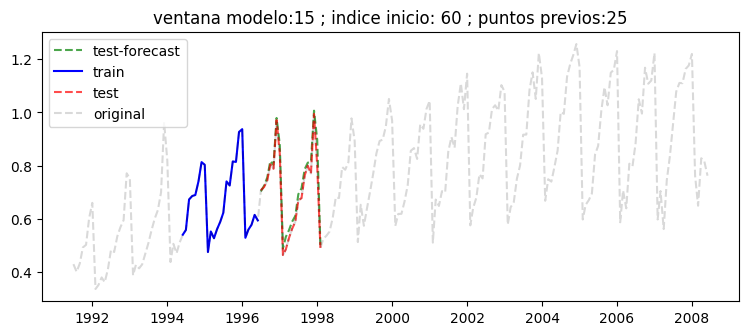

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025
---------------------------------------------


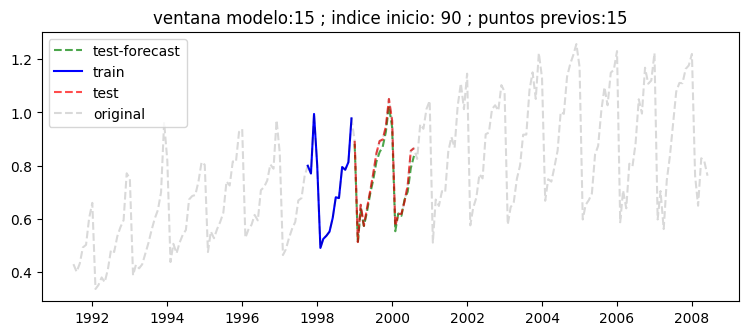

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.020


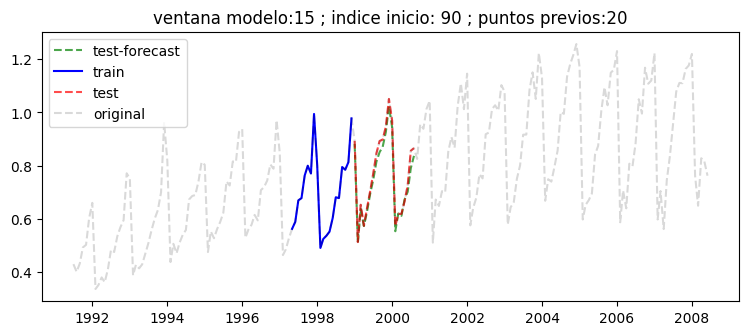

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.020


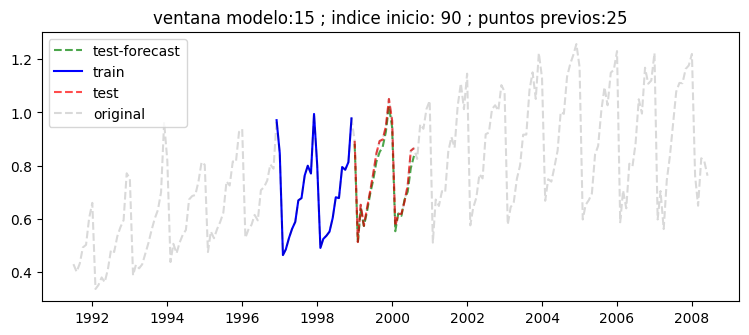

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.020
---------------------------------------------


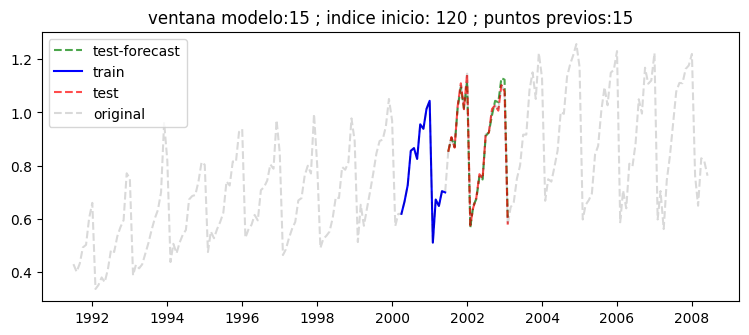

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.014


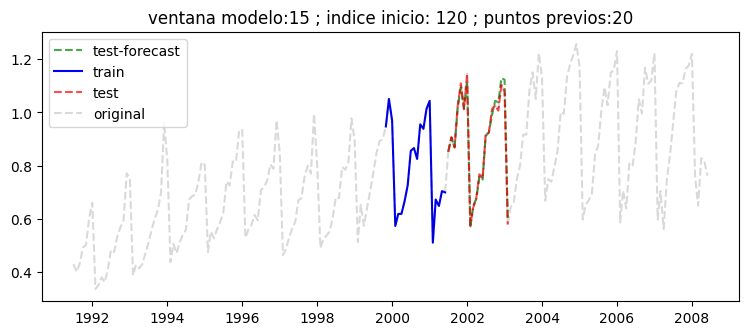

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.014


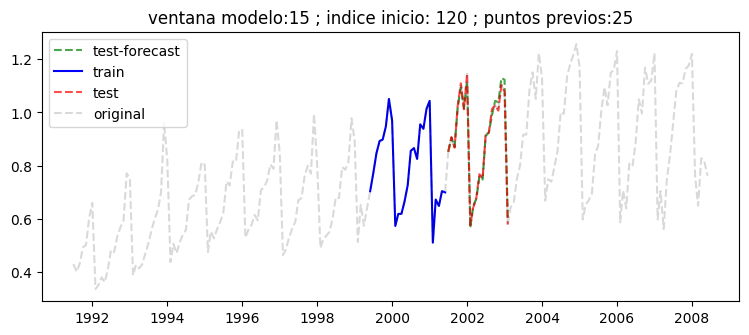

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.014
---------------------------------------------


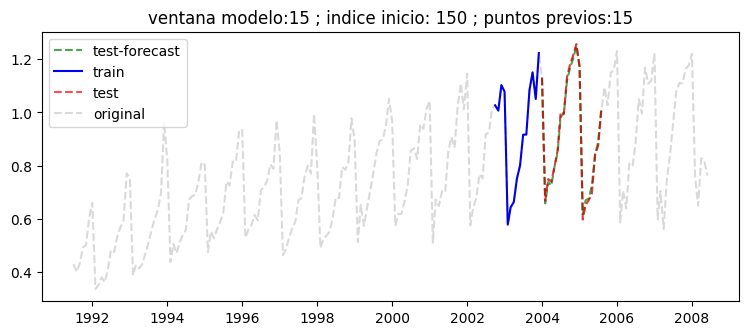

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011


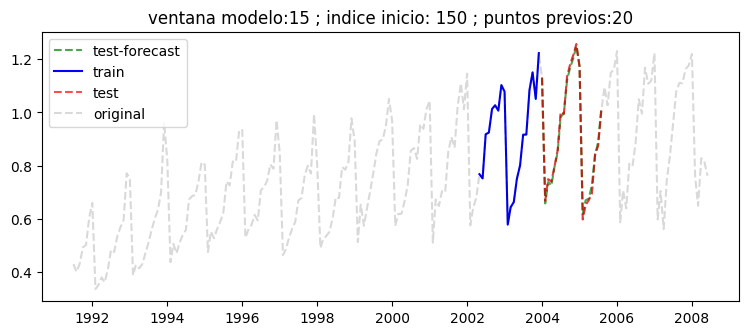

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011


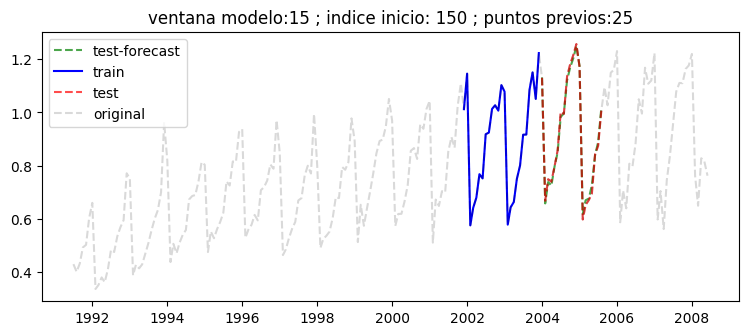

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011
---------------------------------------------


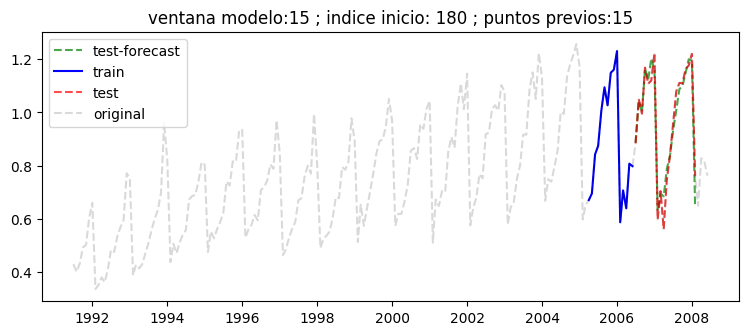

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.035


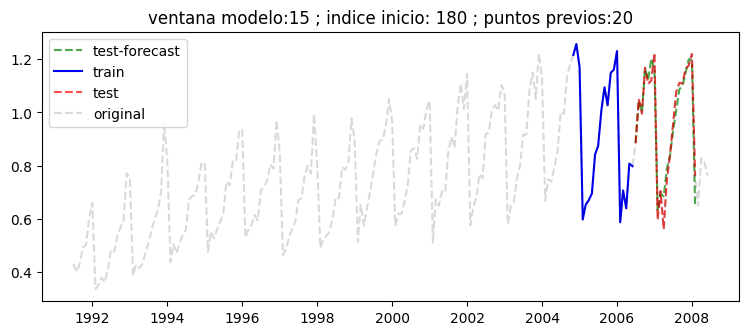

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.035


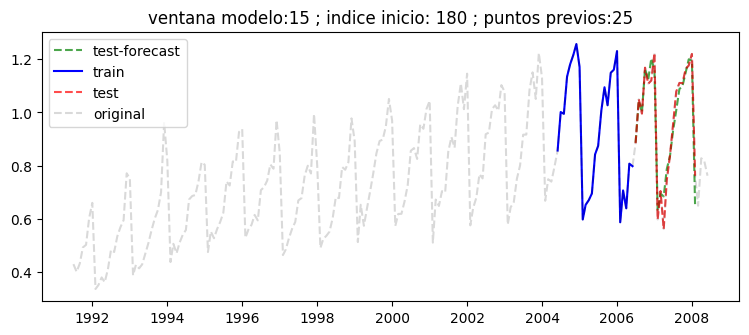

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.035


In [36]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

## Ejemplo con RandomForest

In [37]:
# Entrenar modelo - RandomForest

forecaster = ForecasterAutoreg(
    regressor = RandomForestRegressor(random_state=123),
    lags = 15)

forecaster.fit(y=train_df["y"])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
Creation date: 2022-11-13 10:14:55 
Last fit date: 2022-11-13 10:14:55 
Skforecast version: 0.5.1 
Python version: 3.9.13 

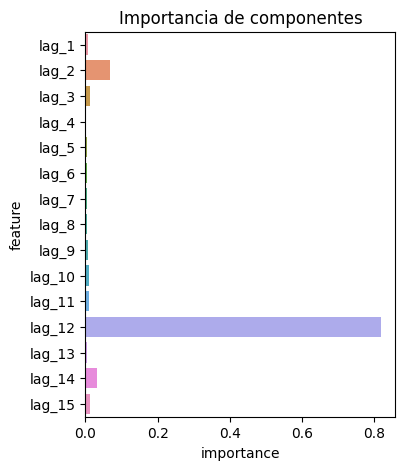

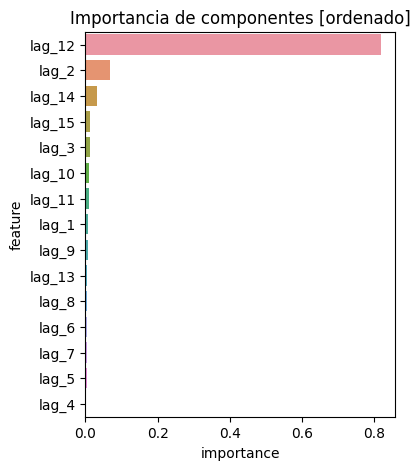

In [38]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [39]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

2006-11-01    1.132498
2006-12-01    1.201832
2007-01-01    1.209193
2007-02-01    0.622030
2007-03-01    0.683463
2007-04-01    0.709265
2007-05-01    0.819407
2007-06-01    0.830490
2007-07-01    0.907816
2007-08-01    0.993028
2007-09-01    1.039360
2007-10-01    1.086890
2007-11-01    1.143597
2007-12-01    1.157186
2008-01-01    1.207474
2008-02-01    0.680979
2008-03-01    0.693186
2008-04-01    0.721921
2008-05-01    0.827668
2008-06-01    0.841010
Freq: MS, Name: pred, dtype: float64

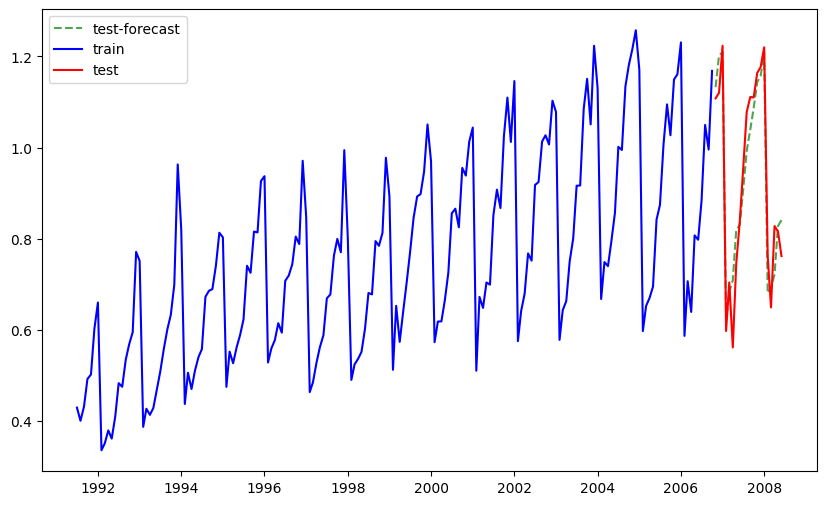

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.240


In [40]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

Guardar y leer modelo

In [41]:
# Guardar modelo en archivo

nombre_archivo = "modelo_randomforest.py"
dump(forecaster,nombre_archivo)
print('Se guardo modelo en:',nombre_archivo)

Se guardo modelo en: modelo_randomforest.py


In [42]:
# leer modelo de archivo

nombre_archivo = "modelo_randomforest.py"
forecaster = load(nombre_archivo)

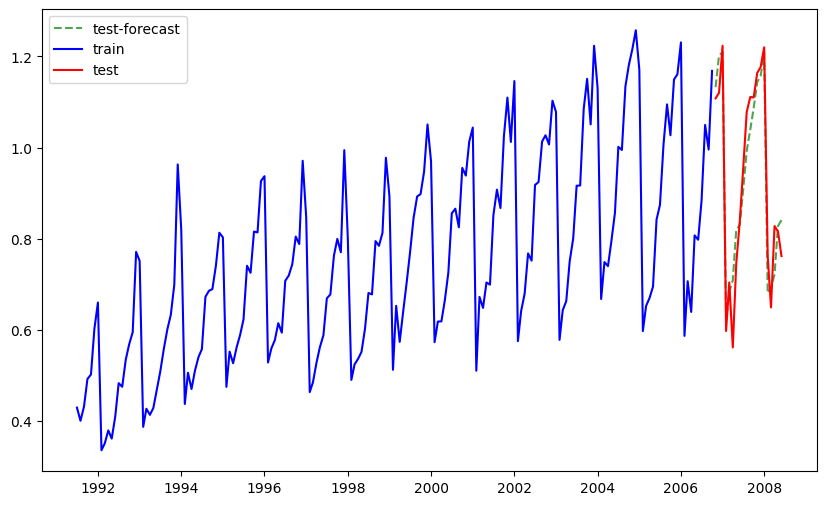

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.240


In [43]:
# Prediccion con modelo leido

pred_df_new = forecaster.predict(steps=test_df.shape[0])

##############################

# Visualizar prediccion
v3 = pred_df_new.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

Prediccion en otros valores y variación de valores input

---------------------------------------------


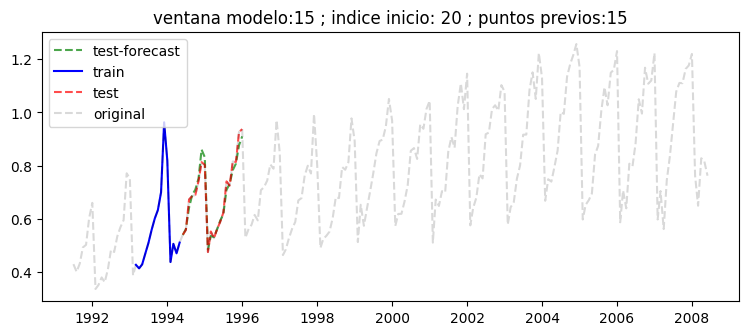

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017


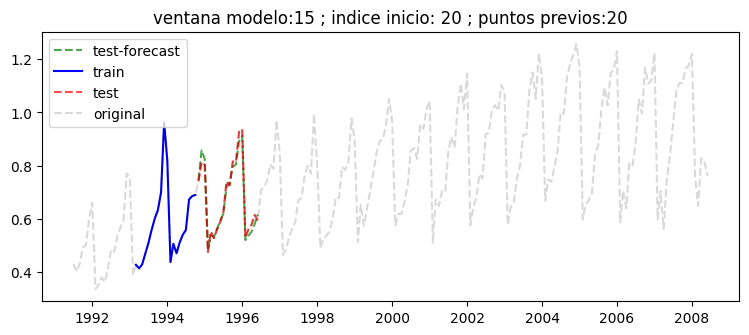

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017


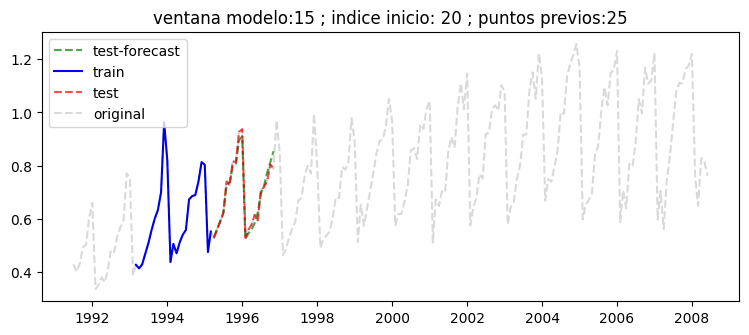

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017
---------------------------------------------


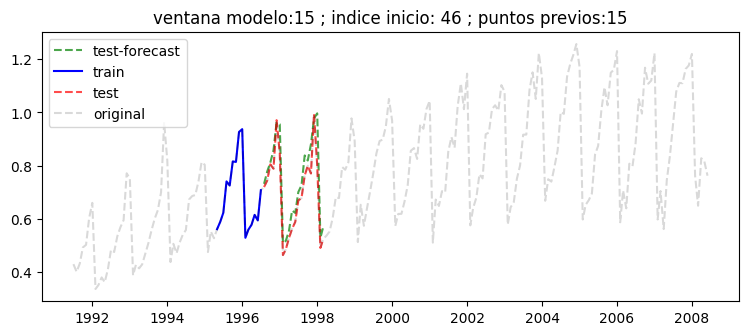

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.051


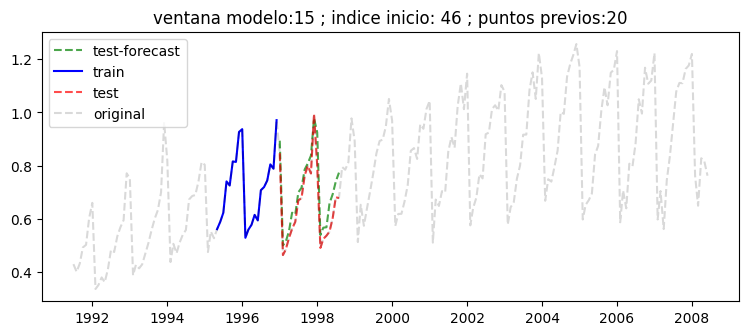

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.051


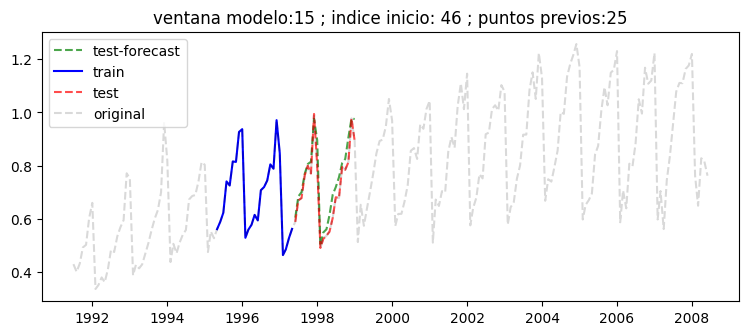

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.039
---------------------------------------------


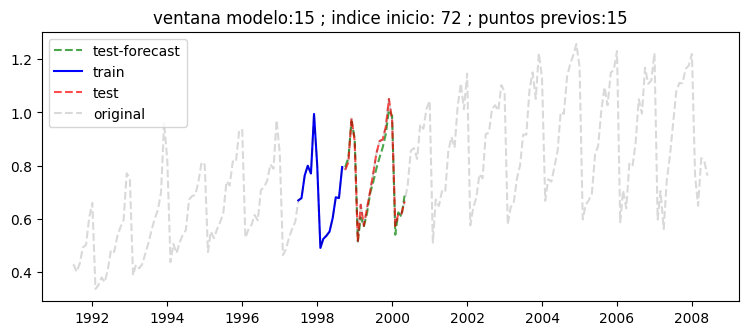

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.023


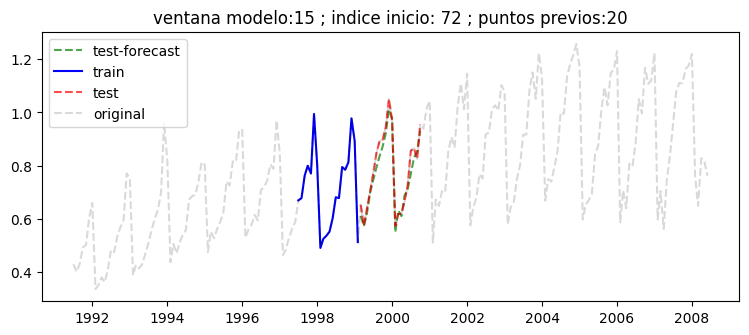

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.028


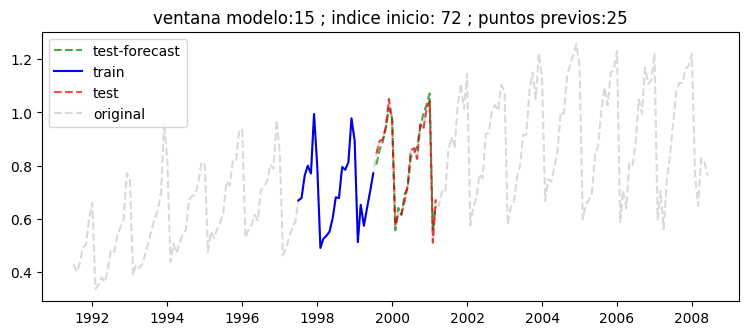

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025
---------------------------------------------


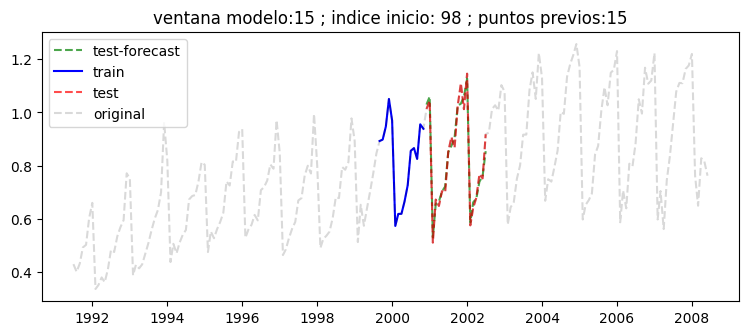

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.023


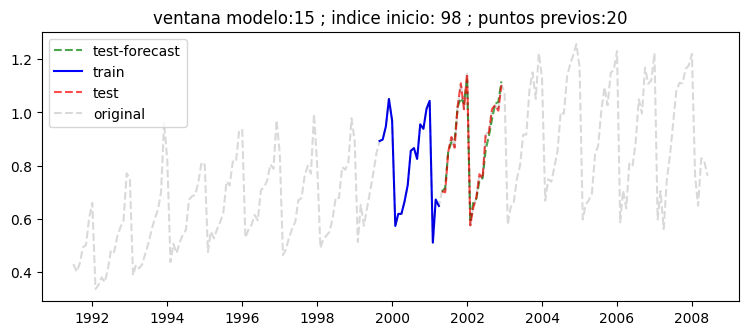

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.019


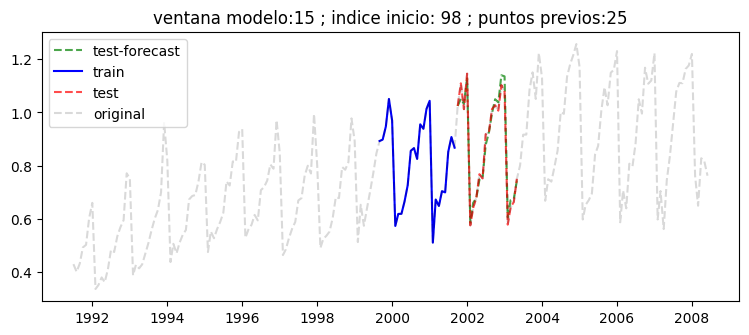

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.021
---------------------------------------------


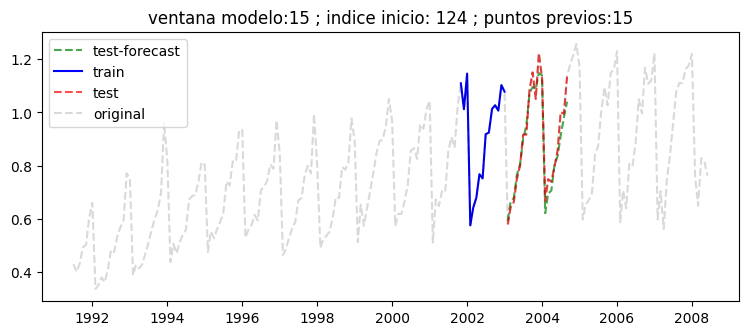

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.033


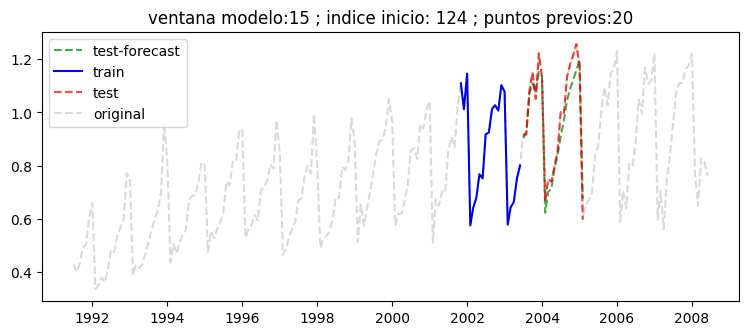

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.046


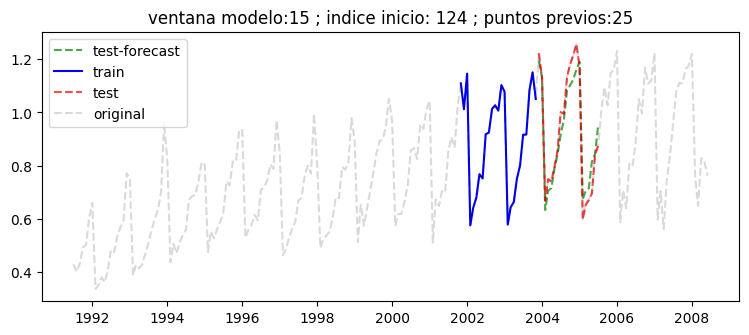

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.049
---------------------------------------------


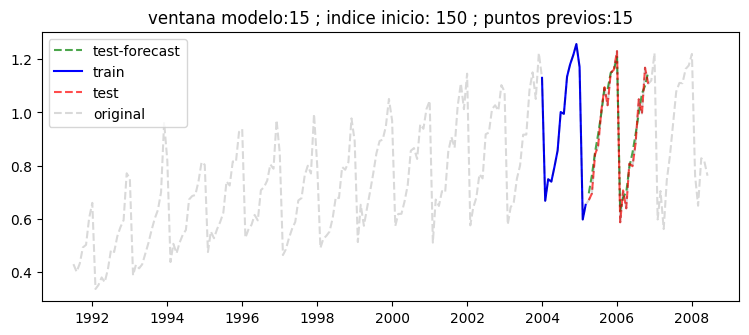

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.036


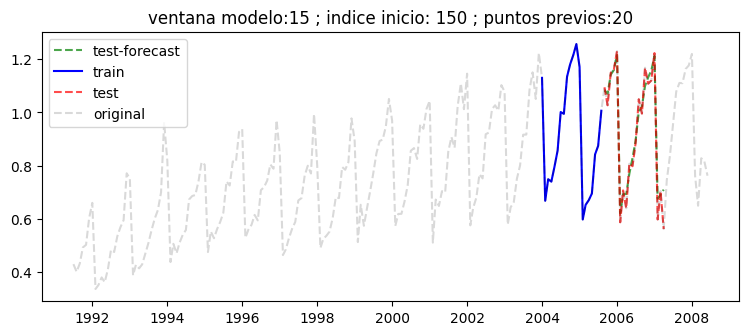

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.036


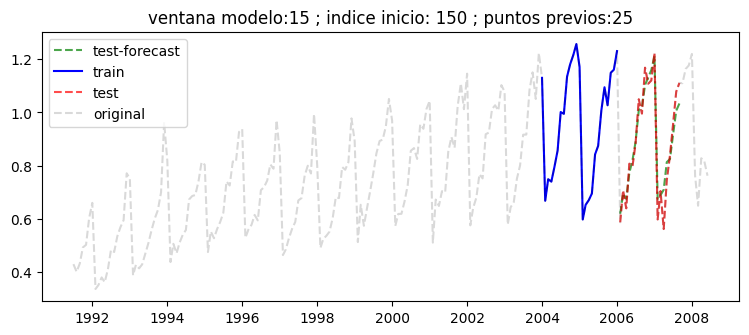

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.043


In [44]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        
        try:
            # extraer datos input al modelo
            df_previos = df.iloc[ii:ii+largo]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()
            
            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

---------------------------------------------


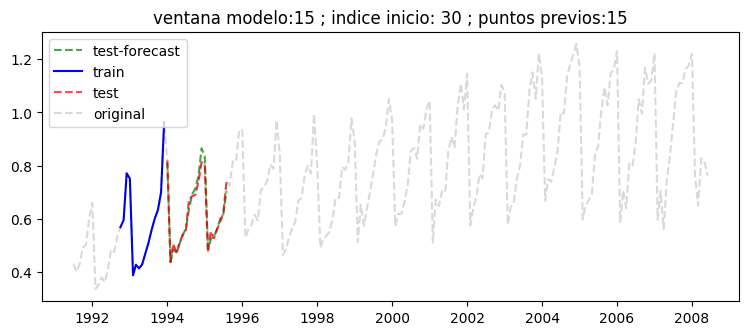

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016


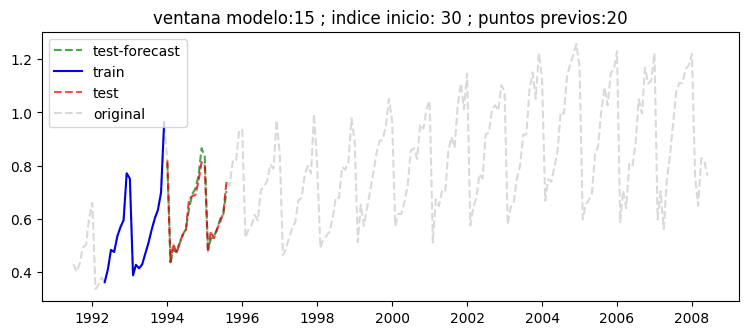

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016


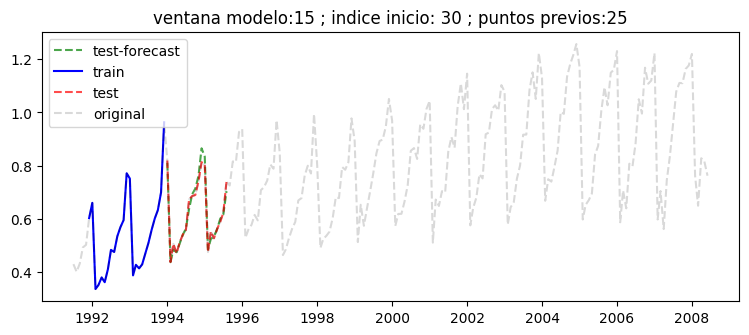

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016
---------------------------------------------


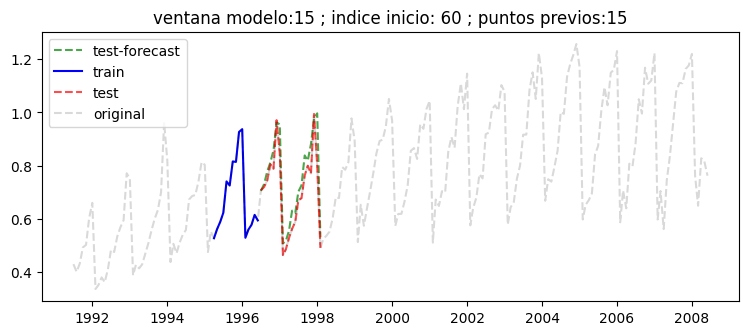

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.049


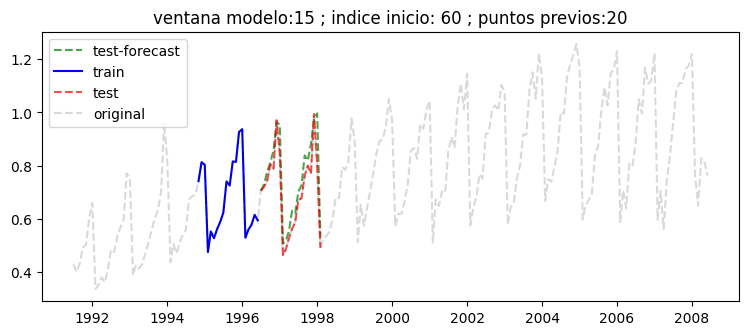

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.049


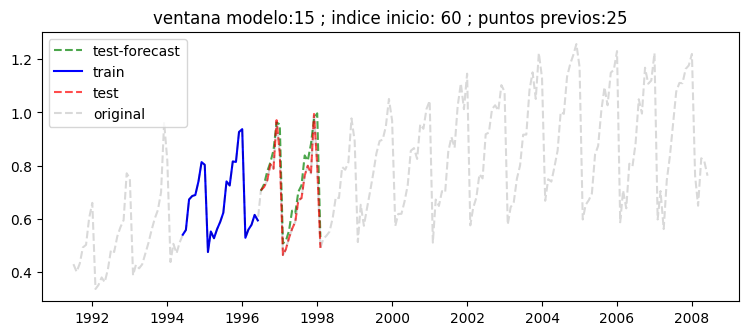

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.049
---------------------------------------------


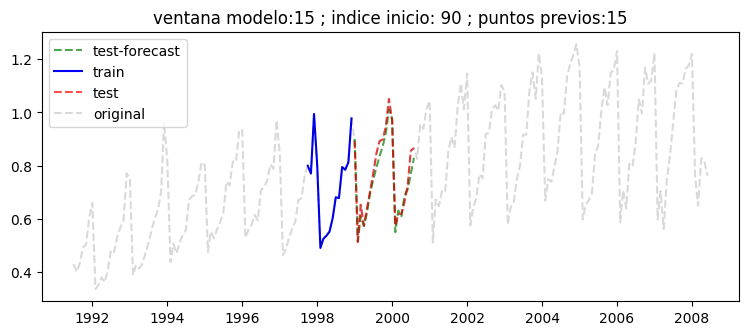

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.026


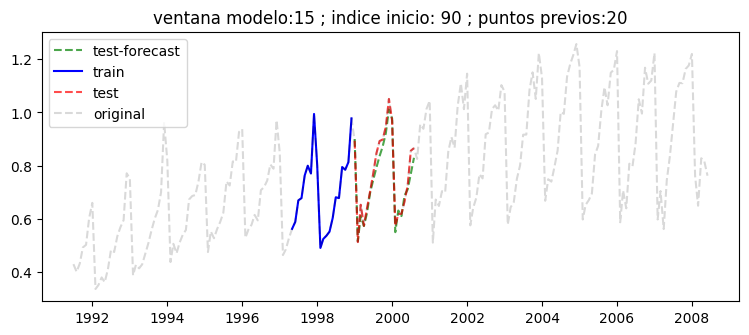

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.026


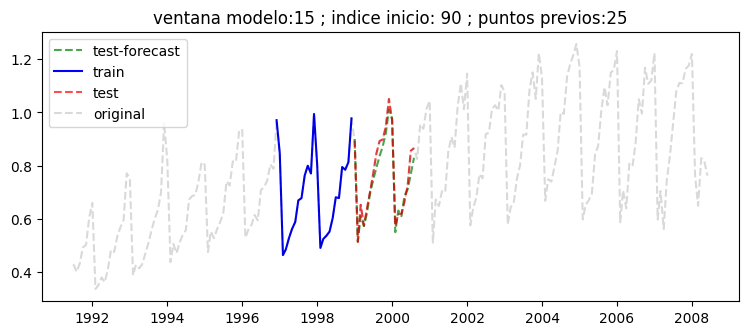

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.026
---------------------------------------------


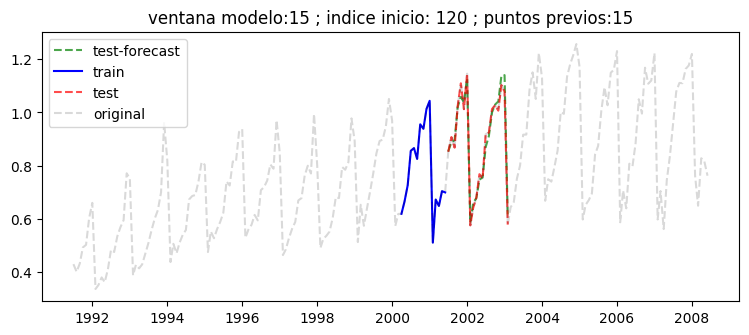

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


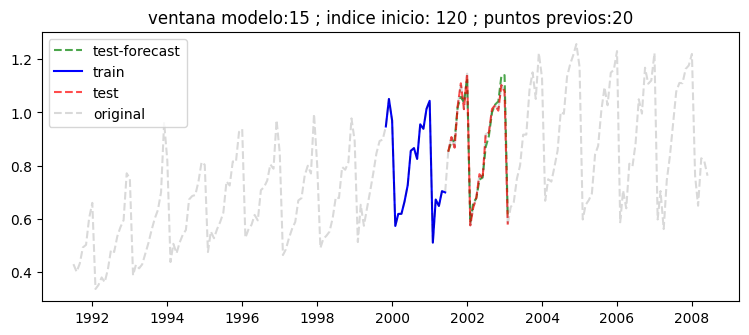

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


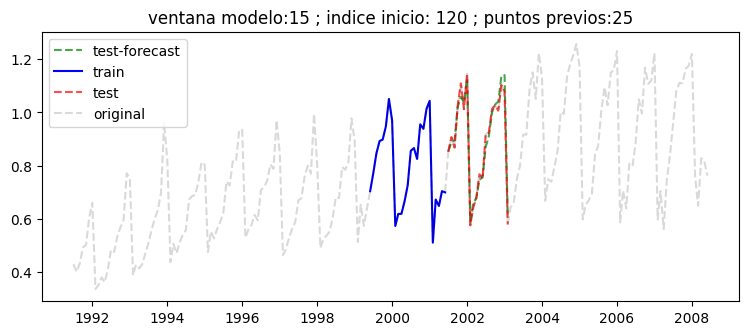

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022
---------------------------------------------


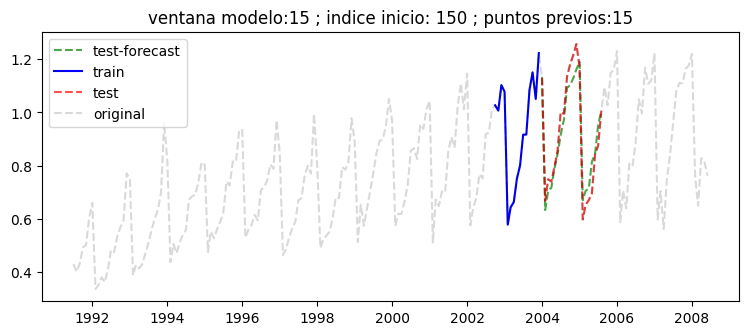

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.046


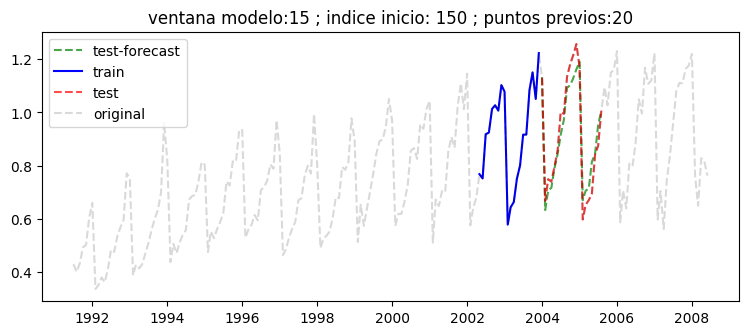

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.046


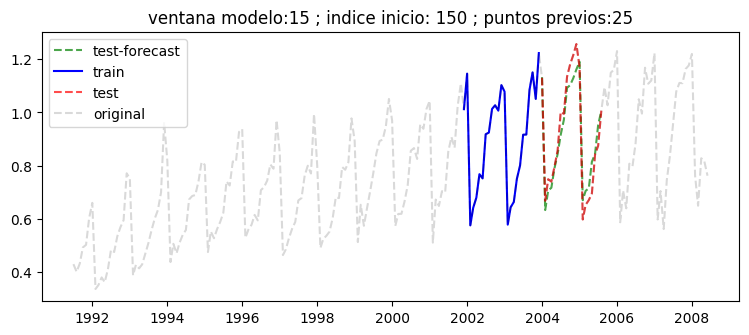

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.046
---------------------------------------------


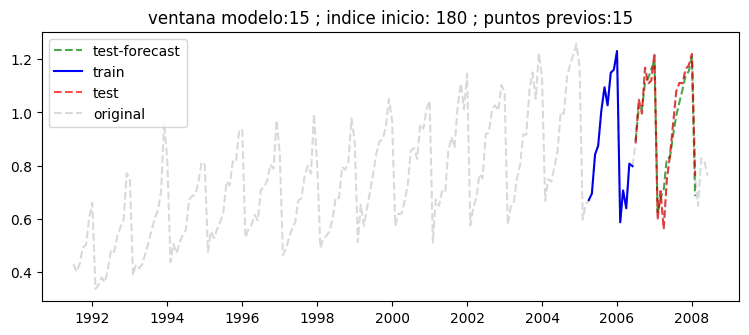

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.043


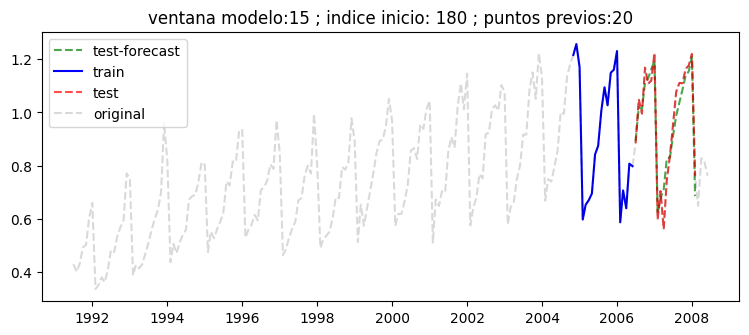

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.043


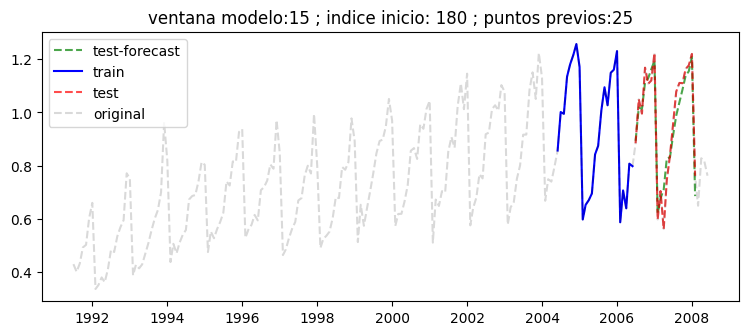

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.043


In [45]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

# Parte 2 - Modelos simples con otros datasets

## Dataset 2: Produccion de electricidad

Cantidad registros inicio raw : 397
Cantidad registros seteo freq : 397
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


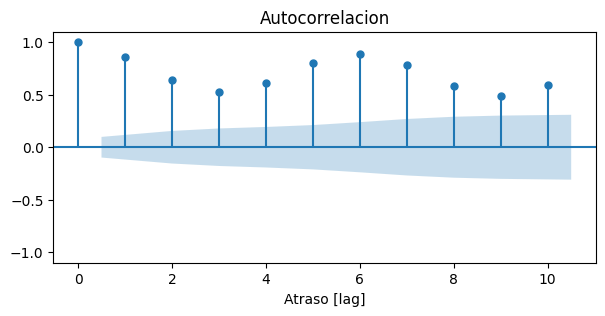

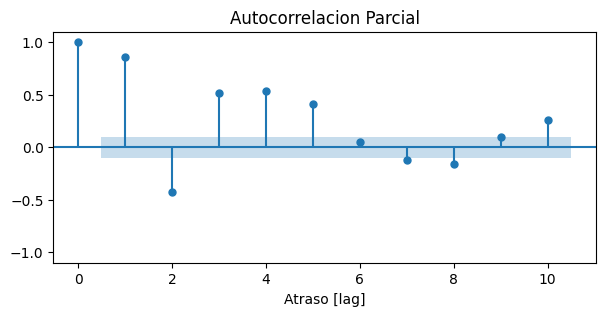

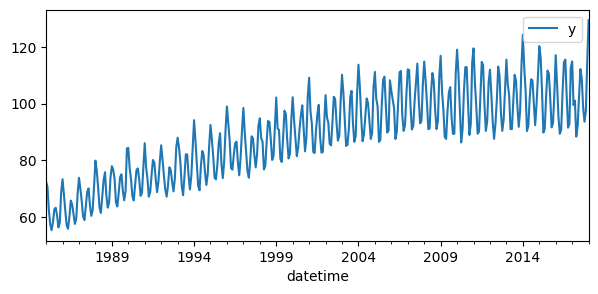

Registro :: pre: 397  ; post: 397  ; diferencia: 0


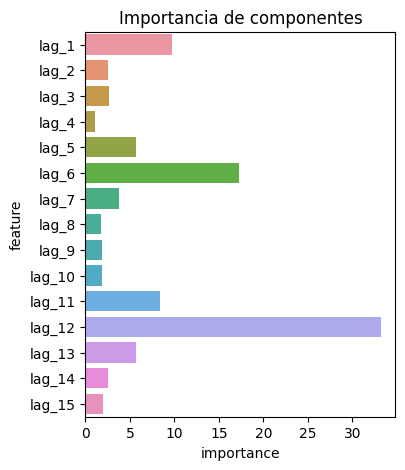

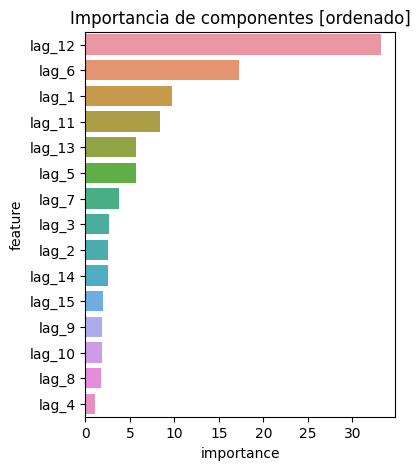

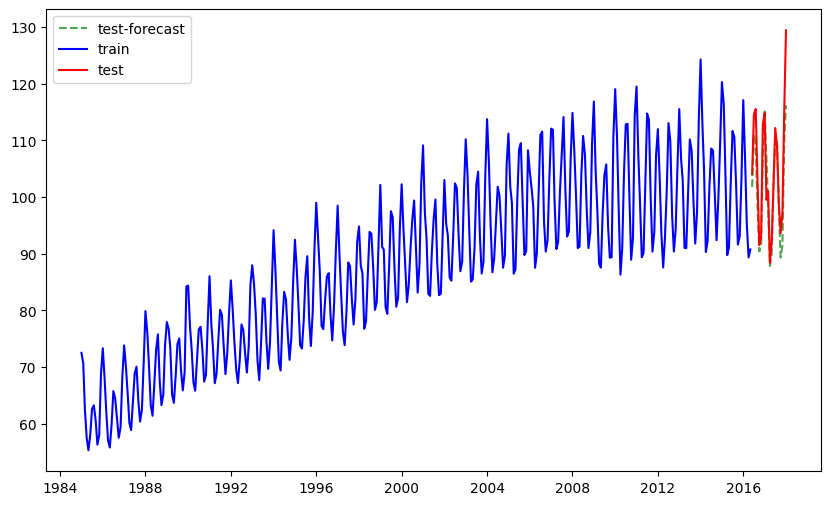

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.481


In [46]:
# Datos 2 - produccion de electricidad

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/Electric_Production.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "DATE"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%d-%m-%Y'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"IPG2211A2N":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

# ver autocorrelacion/parcial
autocorrela(df,n_lags=10) 

#############################################
#############################################
# Limpieza de datos nulos (NaN's)

n_pre = df.shape[0]
df_nan = df[df.isnull().any(axis=1)].copy()
df.dropna(inplace=True)
n_post = df.shape[0]

print('Registro :: pre:',n_pre,' ; post:',n_post,' ; diferencia:',n_pre-n_post)

#############################################
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

#############################################
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=1000,
                  l2_leaf_reg=0.2,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])

#############################################
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

#############################################
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])

#############################################
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()


plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

---------------------------------------------


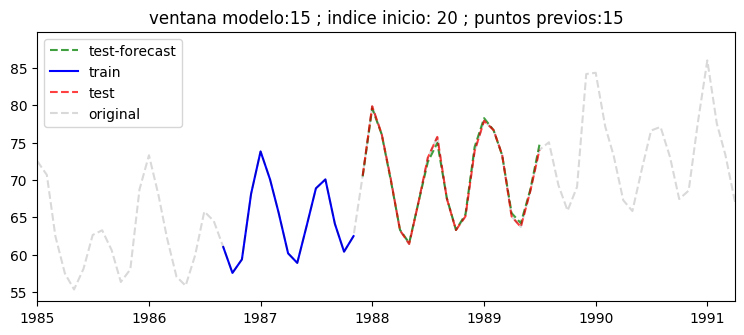

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.271


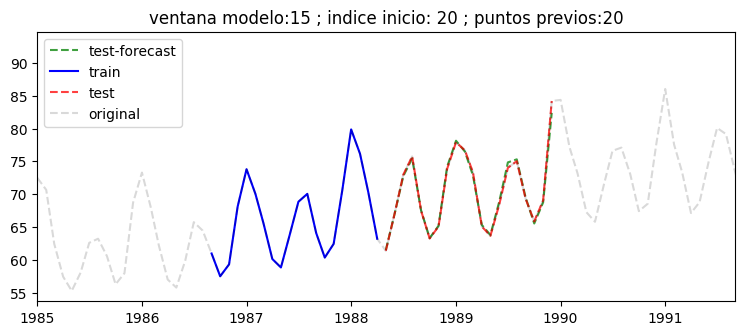

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.330


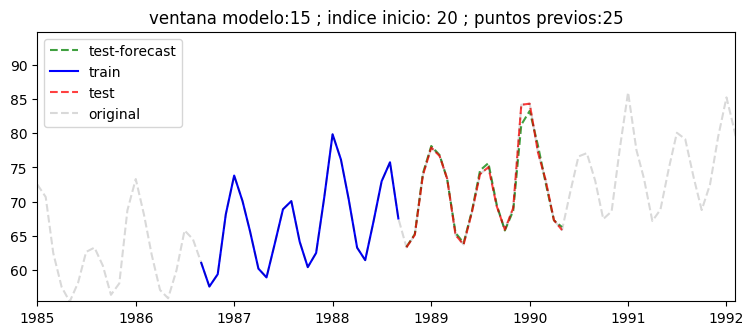

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.467
---------------------------------------------


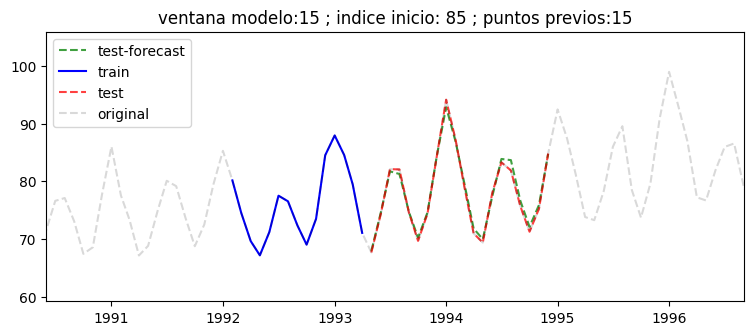

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.584


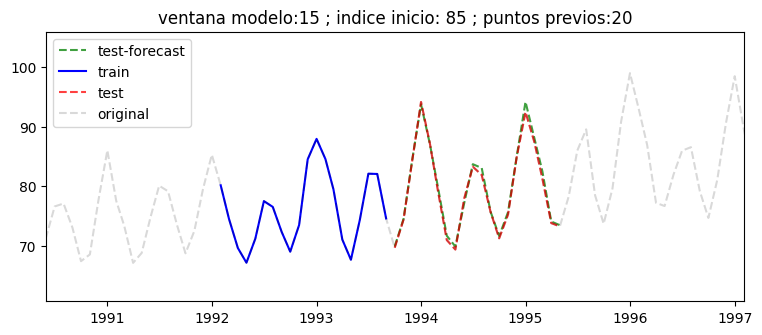

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.510


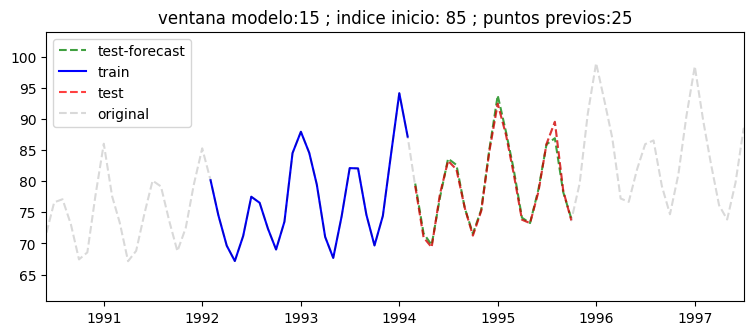

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.514
---------------------------------------------


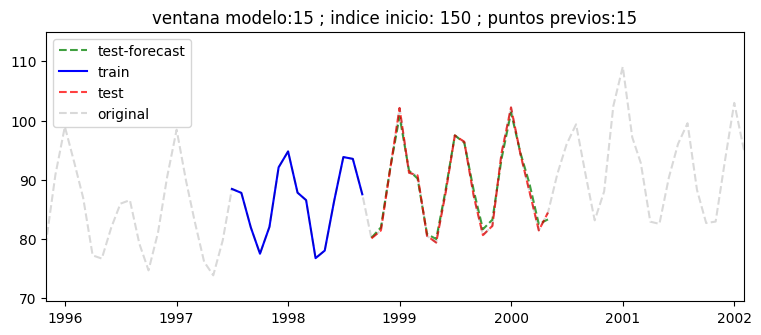

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.663


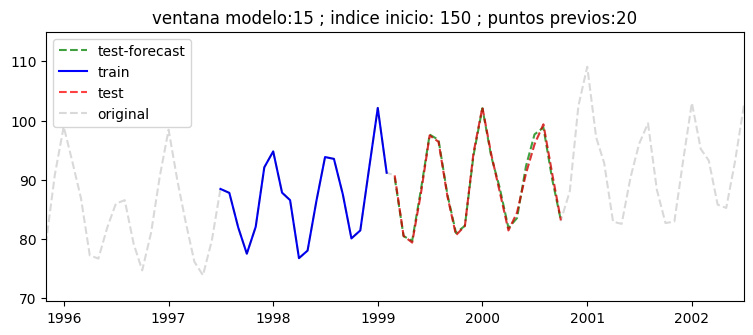

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.485


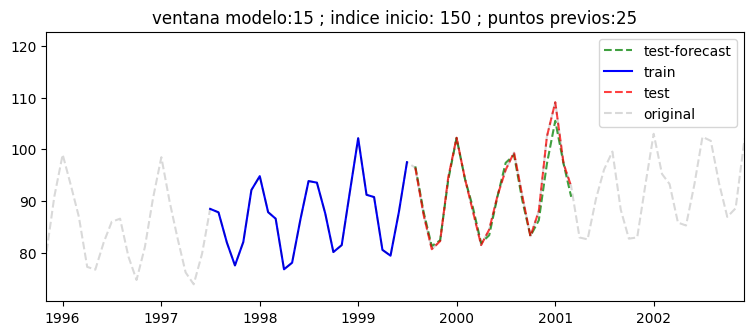

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.003
---------------------------------------------


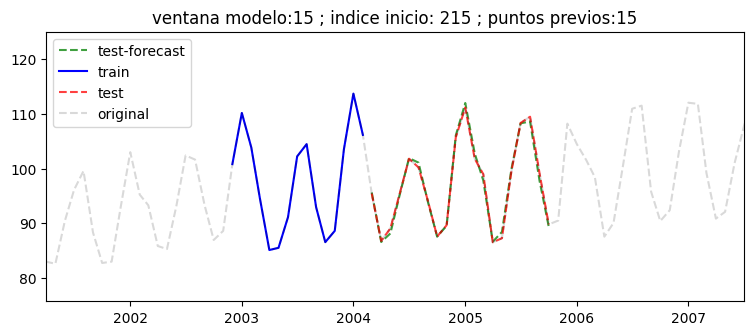

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.525


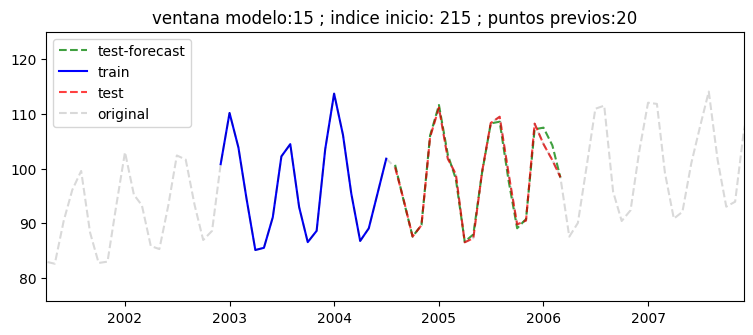

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.708


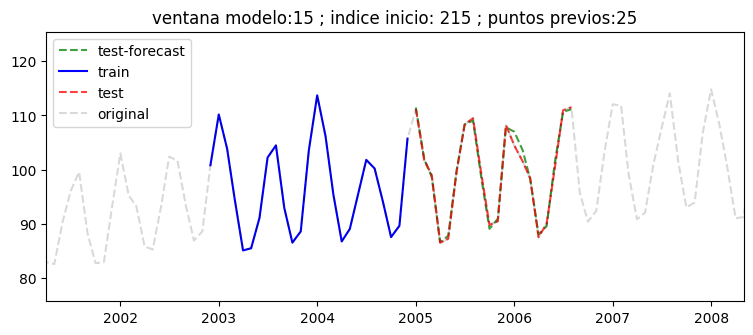

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.603
---------------------------------------------


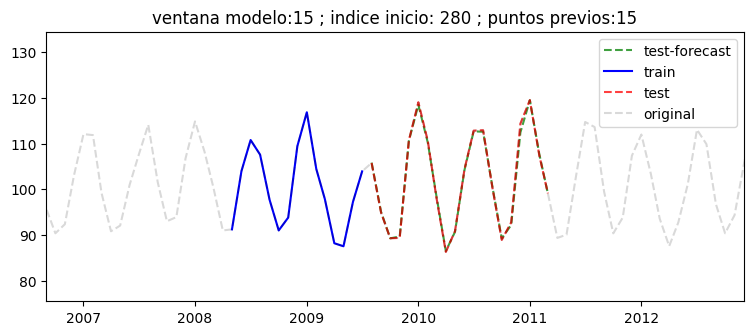

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.314


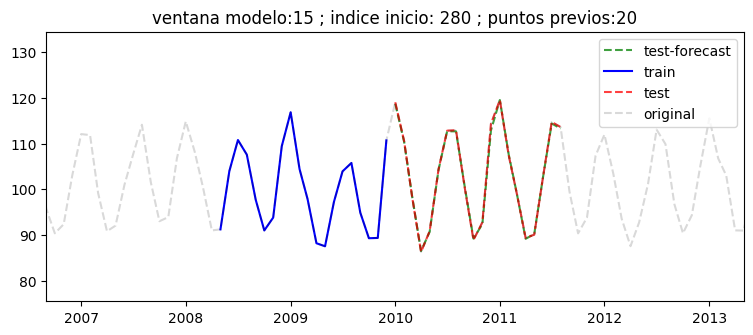

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.254


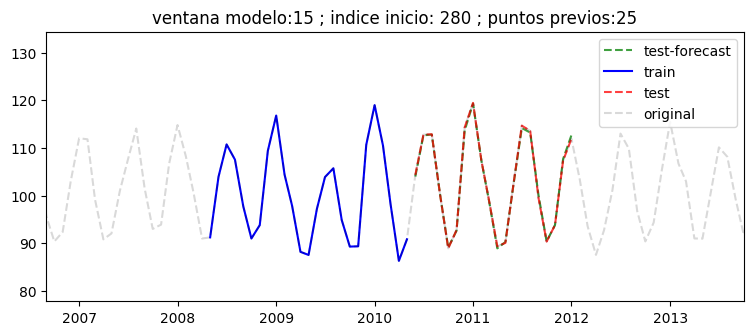

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.253
---------------------------------------------


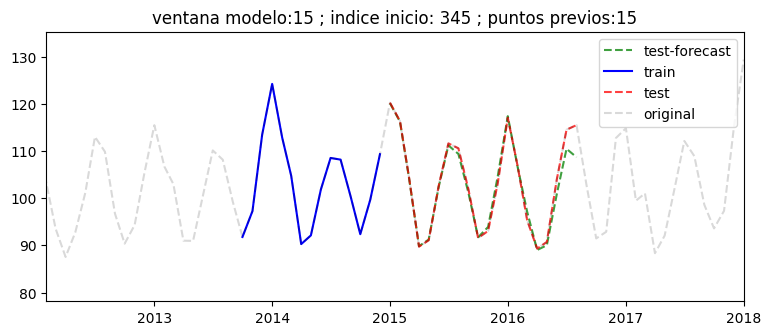

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.152


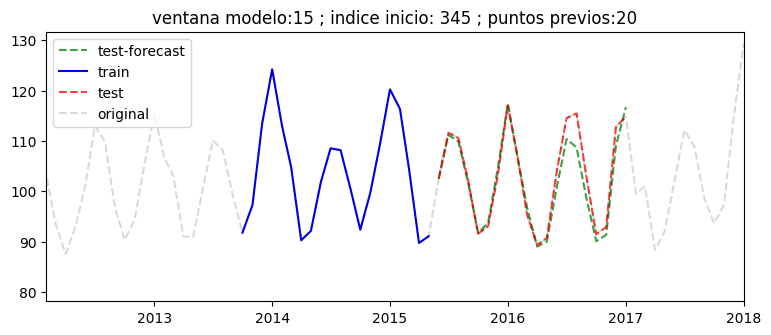

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.689


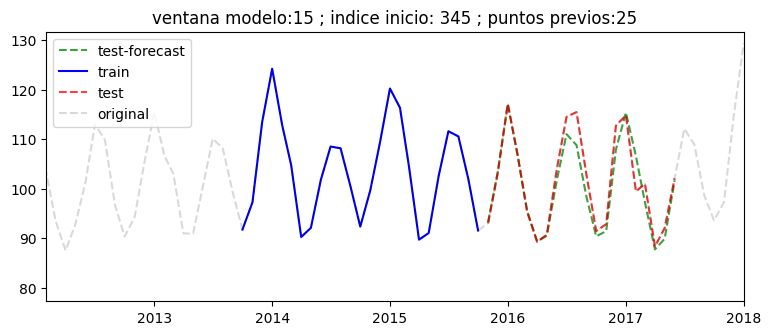

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.001


In [47]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        
        try:
            # extraer datos input al modelo
            df_previos = df.iloc[ii:ii+largo]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()
            
            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.75)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.75)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite < 0) else ii-margen_limite
            iimax = -1 if (ii+largo+largo_test+margen_limite >= df.shape[0]) else ii+largo+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

---------------------------------------------


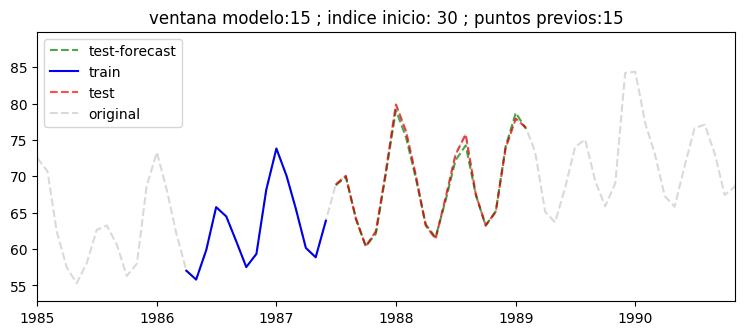

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.379


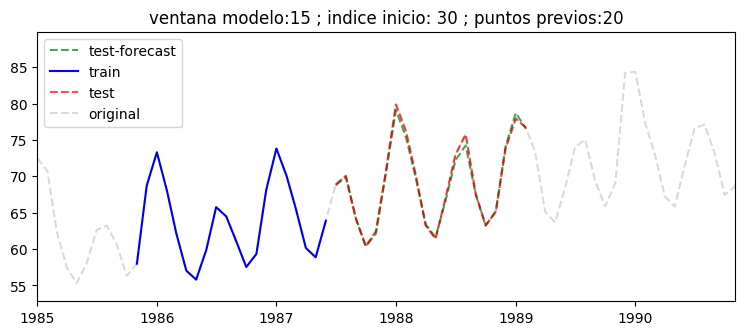

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.379


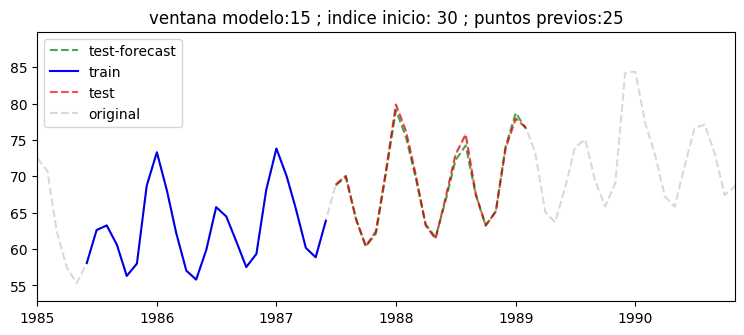

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.379
---------------------------------------------


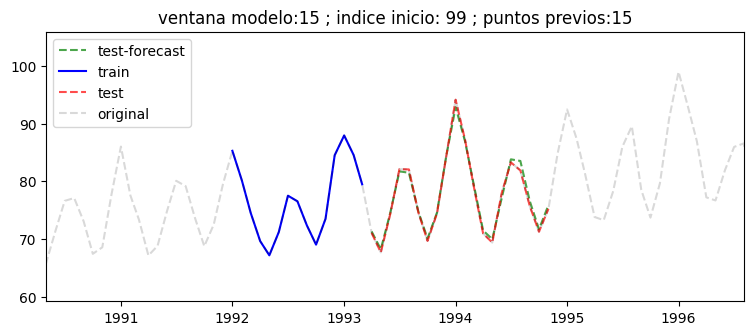

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.536


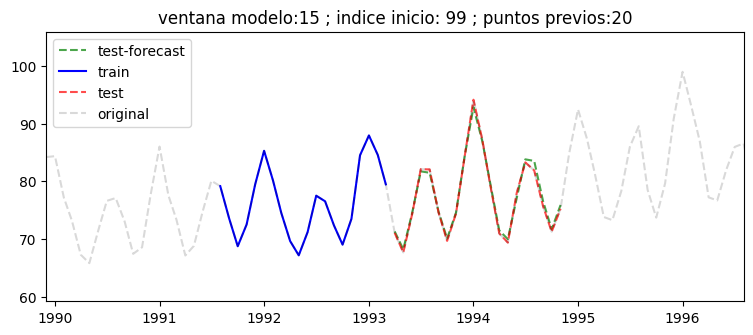

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.536


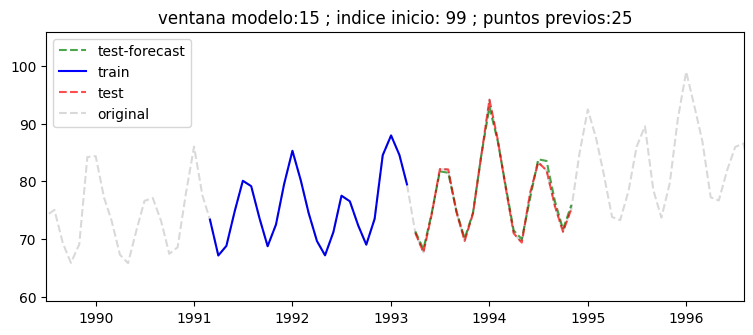

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.536
---------------------------------------------


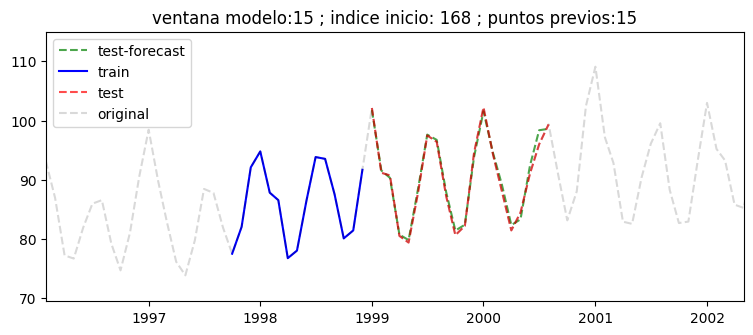

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.688


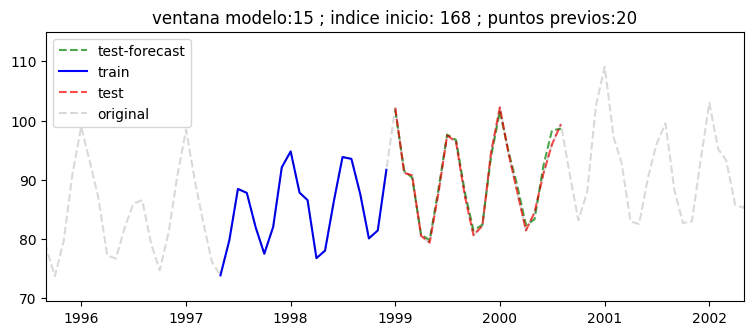

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.688


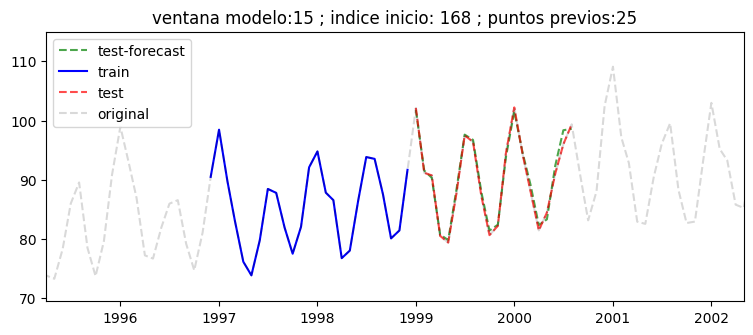

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.688
---------------------------------------------


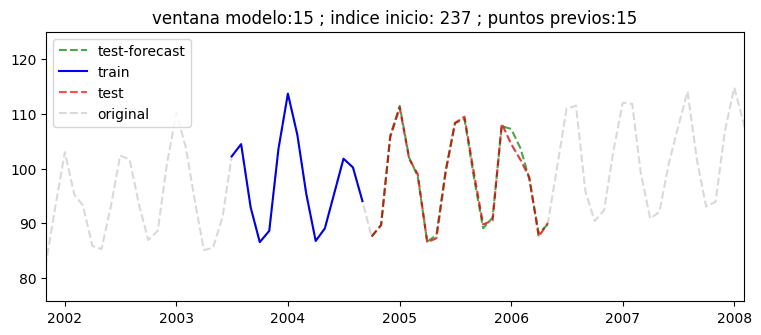

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.561


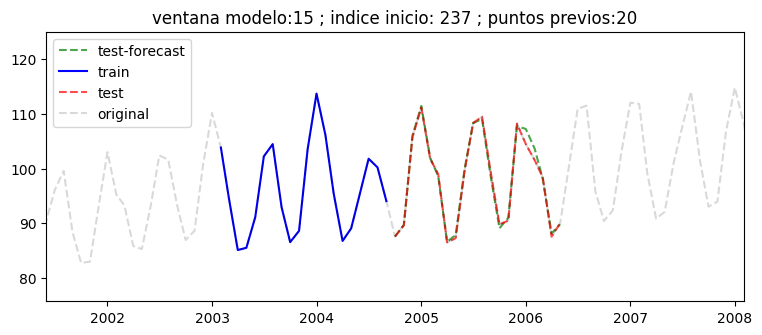

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.561


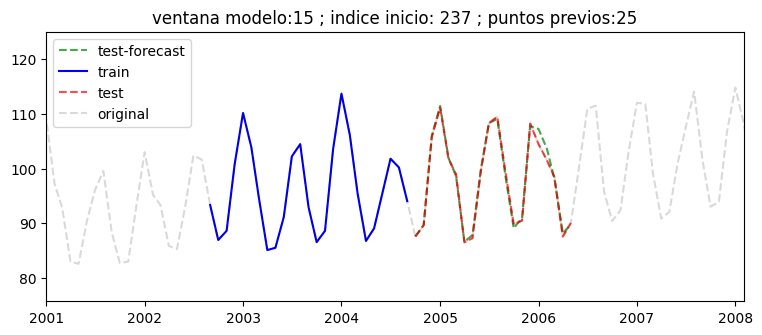

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.561
---------------------------------------------


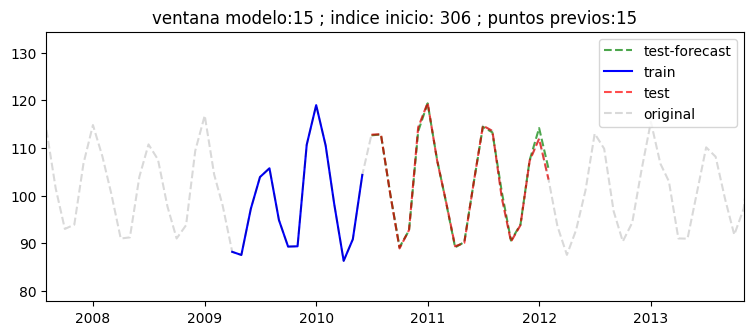

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.447


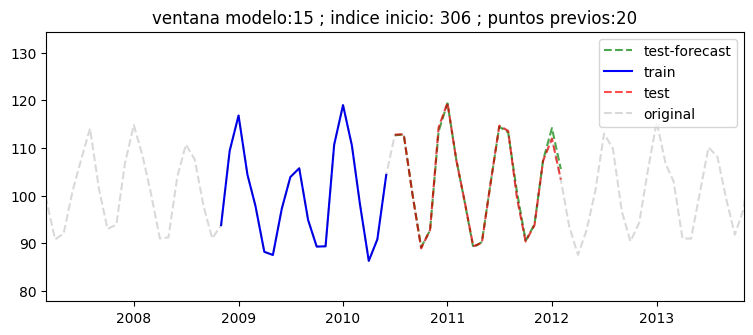

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.447


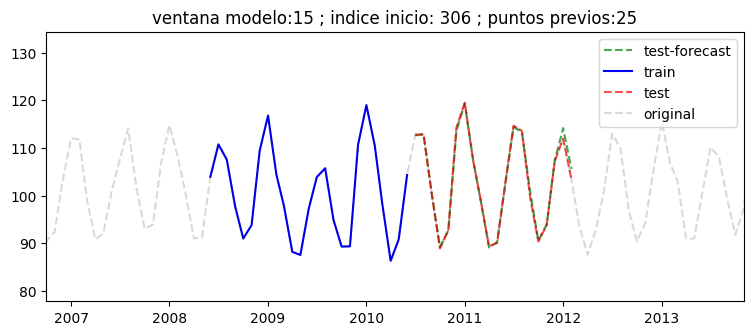

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.447
---------------------------------------------


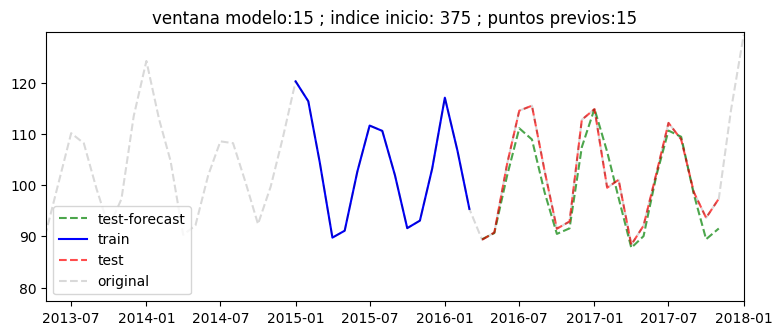

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.524


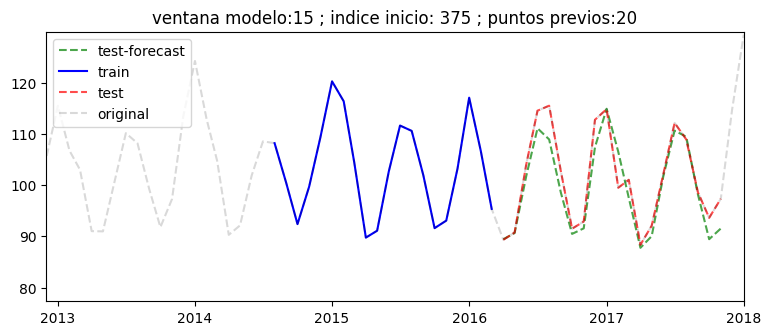

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.524


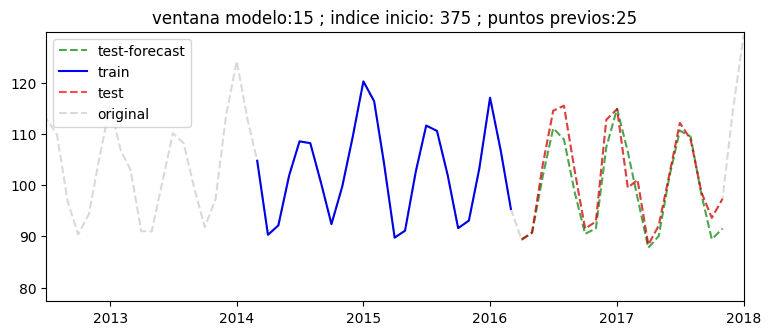

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.524


In [48]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite-largo < 0) else ii-margen_limite-largo
            iimax = -1 if (ii+largo_test+margen_limite >= df.shape[0]) else ii+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

## Dataset 3: Produccion de cerveza australia

Cantidad registros inicio raw : 476
Cantidad registros seteo freq : 476
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


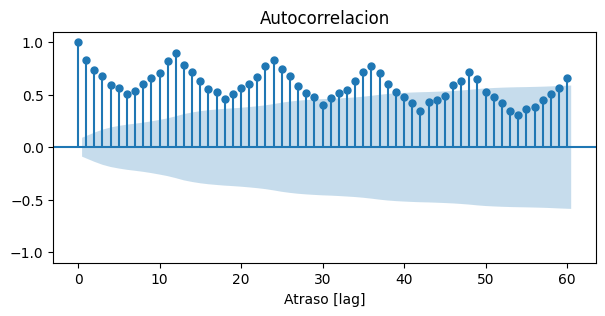

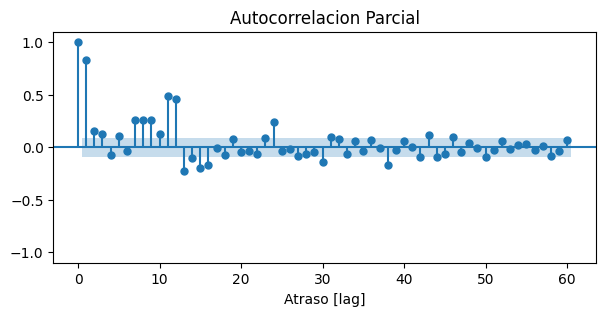

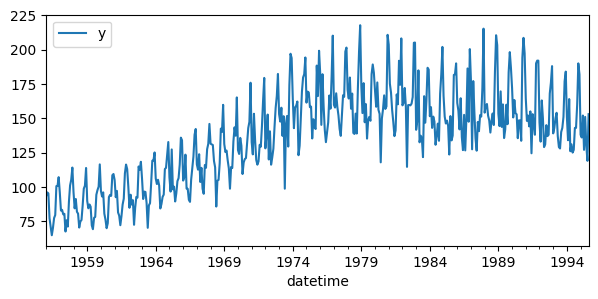

Registro :: pre: 476  ; post: 476  ; diferencia: 0


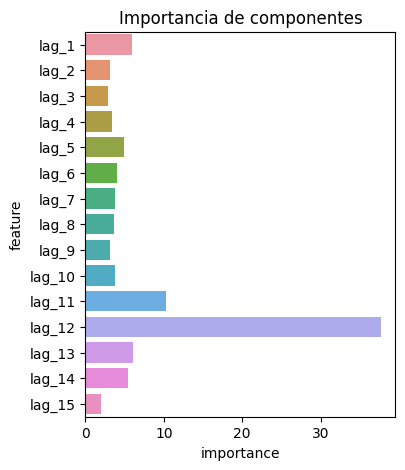

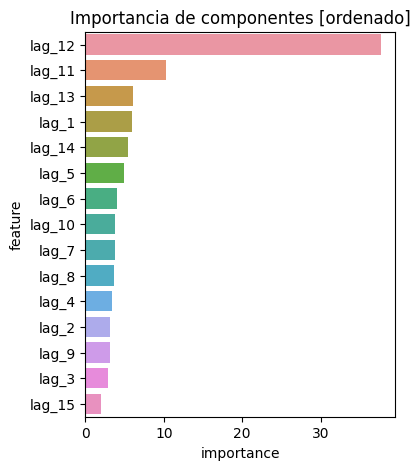

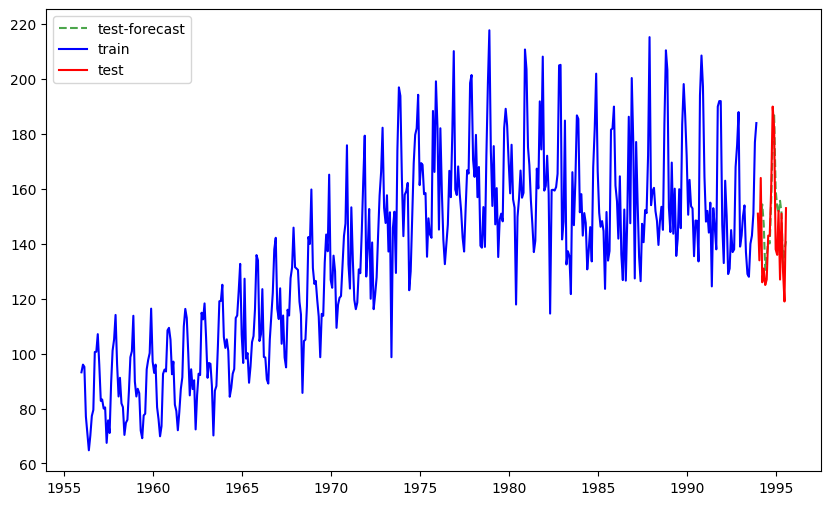

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 10.929


In [49]:
# Datos 3 - produccion de cerveza en australia

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/monthly-beer-production-in-austr.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "Month"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo],format="%Y-%m")

# Dar formato a estampa de tiempo
formato = '%Y-%m'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Monthly beer production":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################


# ver autocorrelacion/parcial
autocorrela(df,n_lags=60) 

#############################################
#############################################

#############################################
# Limpieza de datos nulos (NaN's)

n_pre = df.shape[0]
df_nan = df[df.isnull().any(axis=1)].copy()
df.dropna(inplace=True)
n_post = df.shape[0]

print('Registro :: pre:',n_pre,' ; post:',n_post,' ; diferencia:',n_pre-n_post)

#############################################
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

#############################################
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=1000,
                  l2_leaf_reg=0.2,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])

#############################################
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

#############################################
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])

#############################################
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()


plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

---------------------------------------------


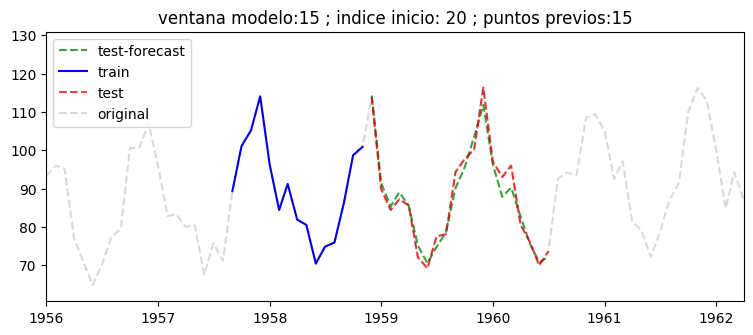

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.167


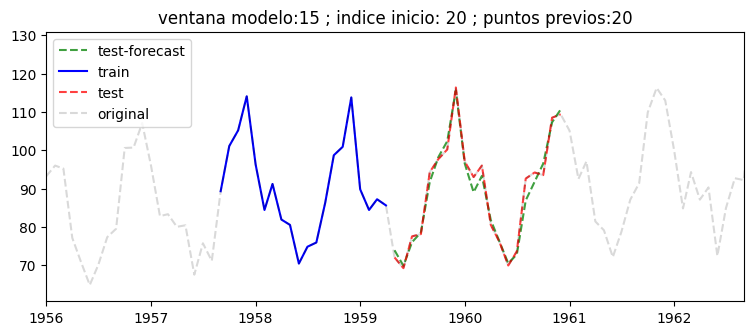

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.697


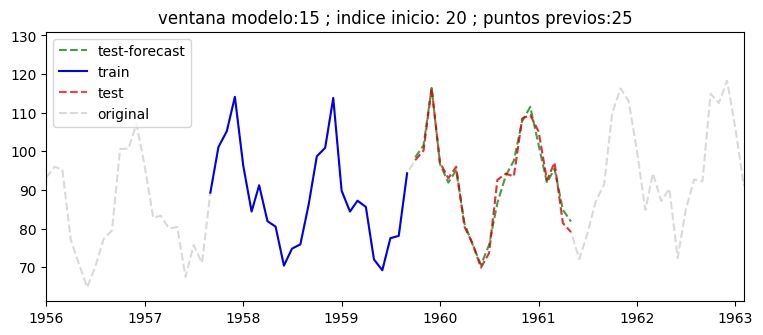

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.682
---------------------------------------------


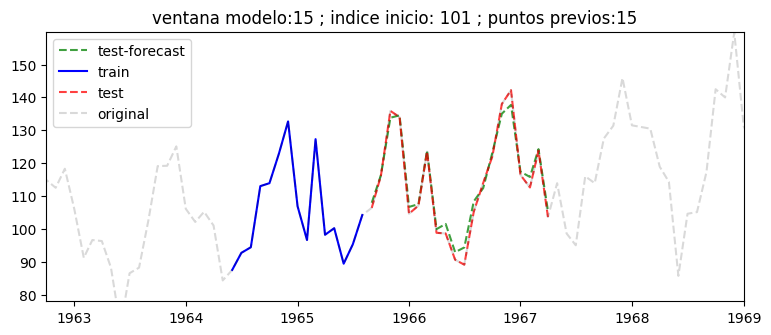

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.924


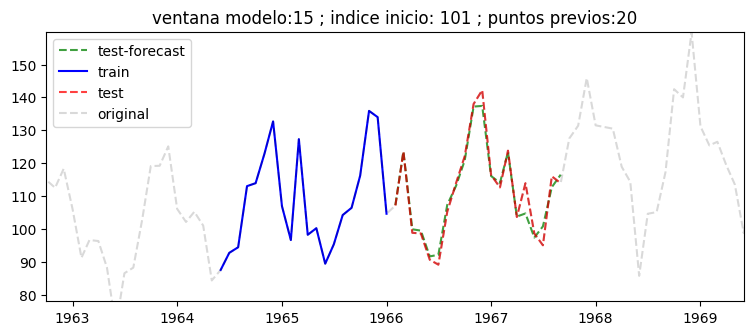

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.016


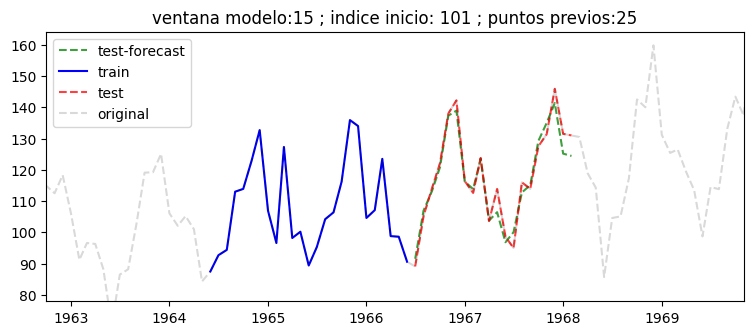

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.686
---------------------------------------------


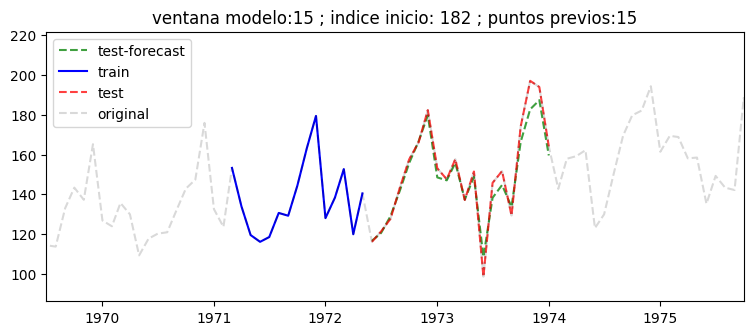

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.053


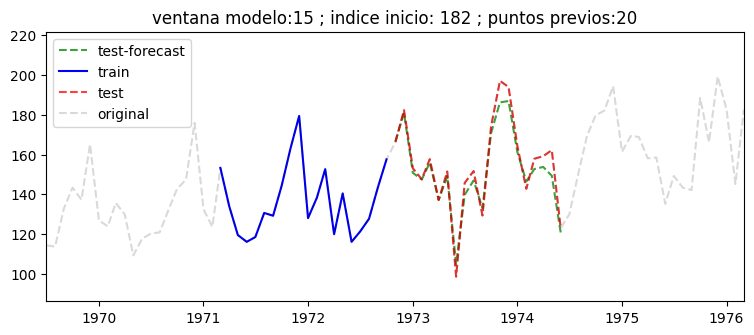

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.114


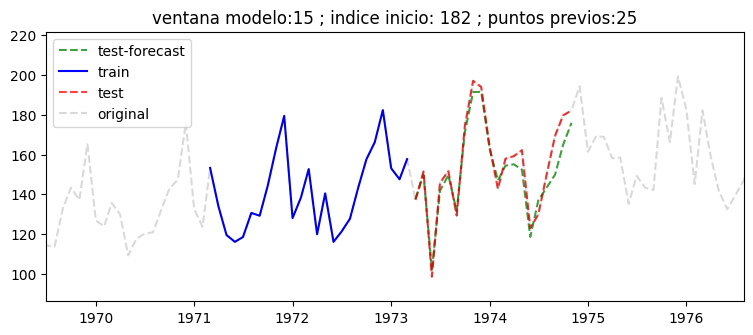

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.300
---------------------------------------------


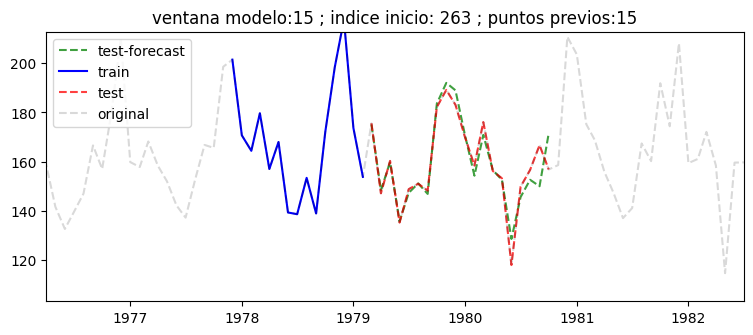

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.868


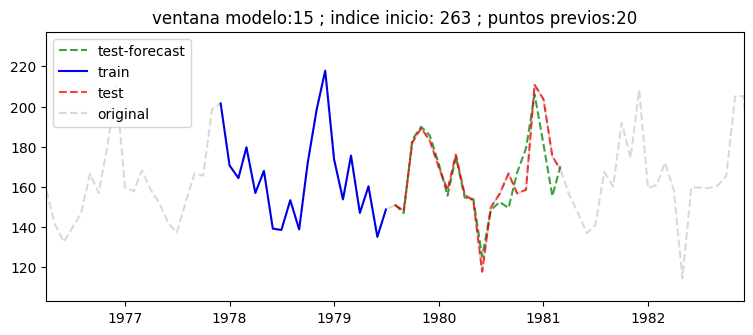

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.181


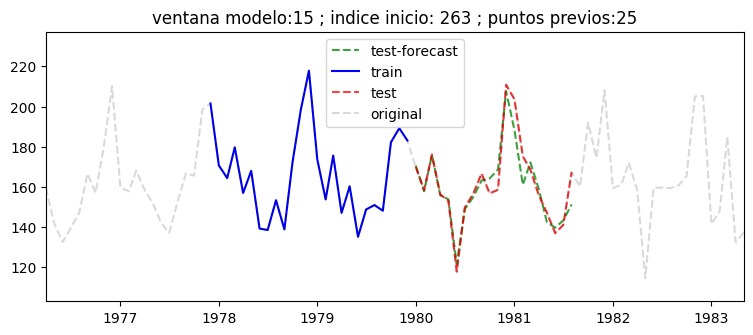

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.737
---------------------------------------------


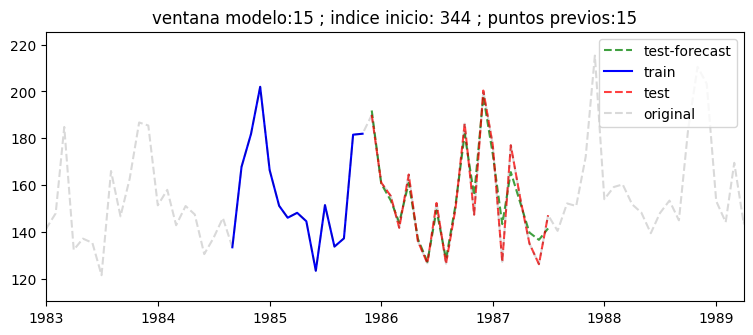

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.383


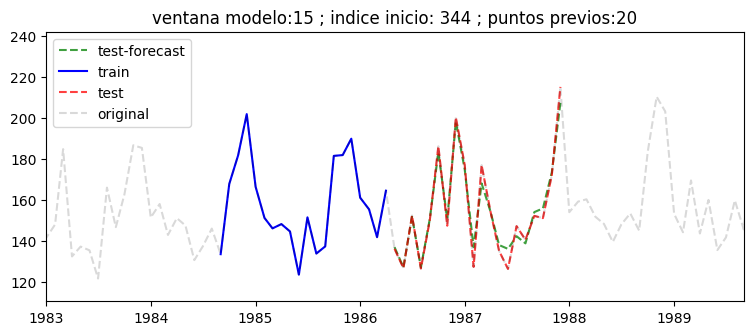

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.362


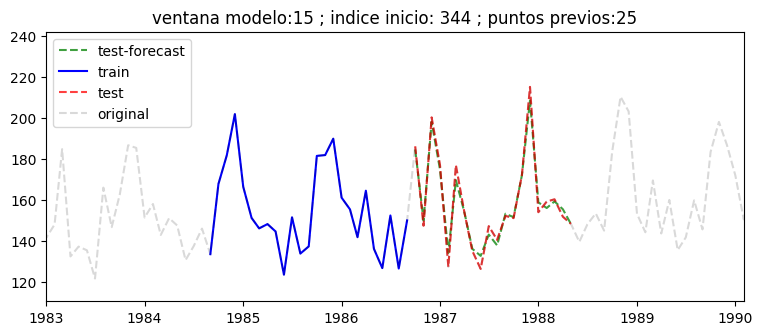

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.893
---------------------------------------------


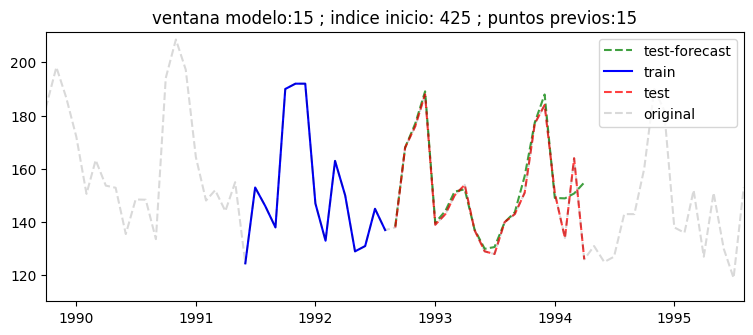

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.099


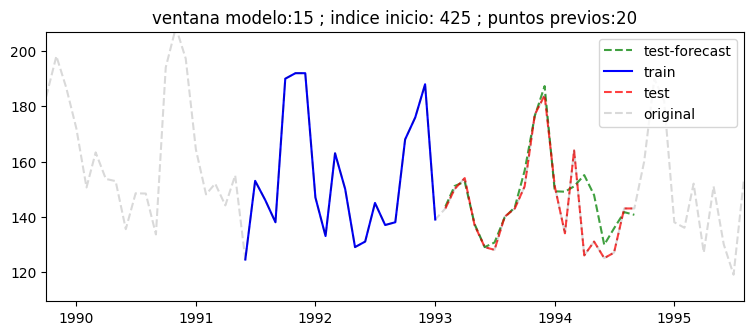

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.476


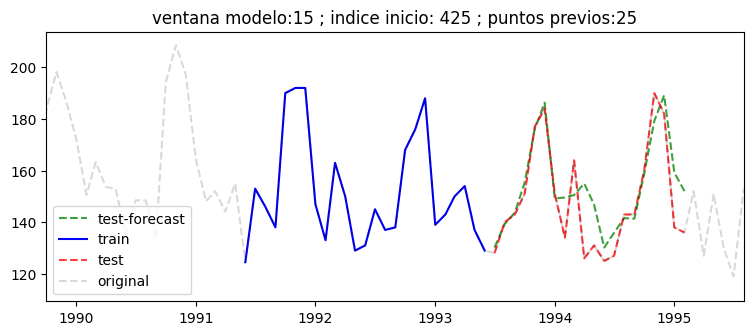

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 8.022


In [50]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        
        try:
            # extraer datos input al modelo
            df_previos = df.iloc[ii:ii+largo]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()
            
            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.75)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.75)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite < 0) else ii-margen_limite
            iimax = -1 if (ii+largo+largo_test+margen_limite >= df.shape[0]) else ii+largo+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

---------------------------------------------


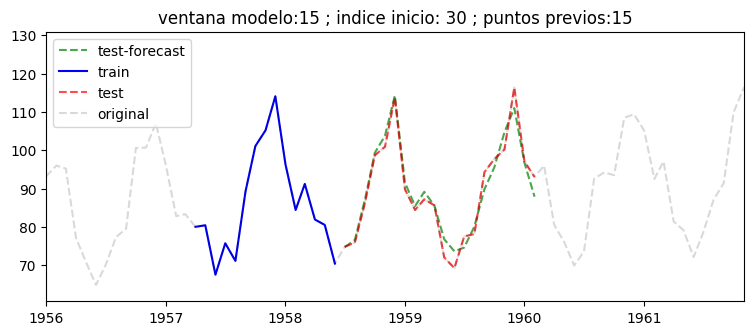

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.328


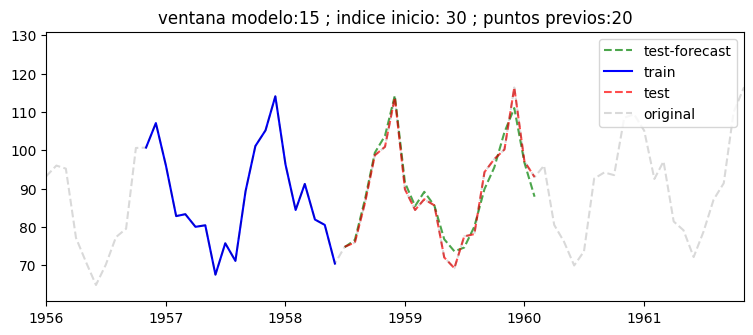

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.328


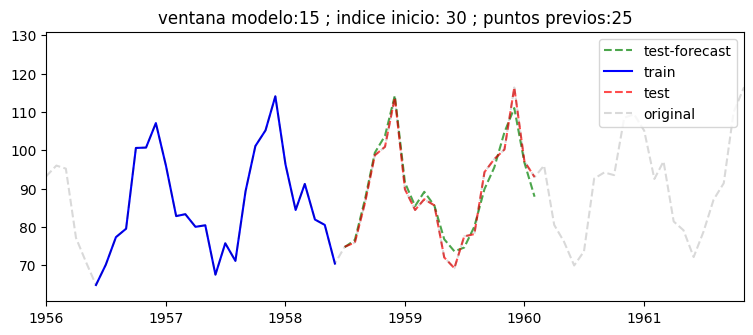

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.328
---------------------------------------------


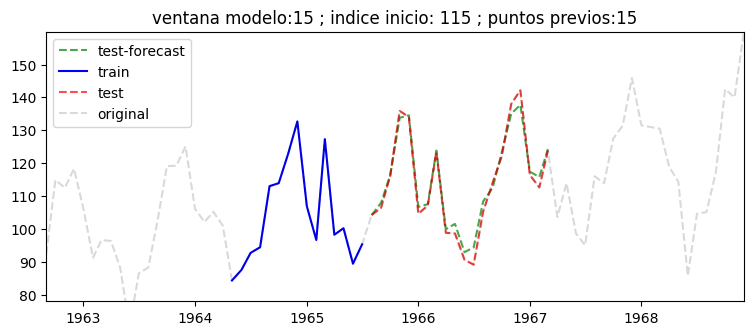

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.834


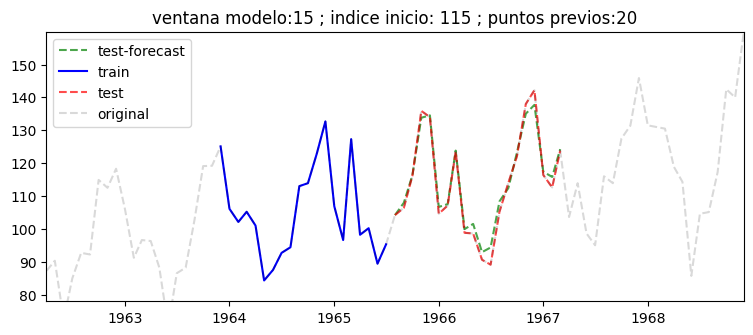

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.834


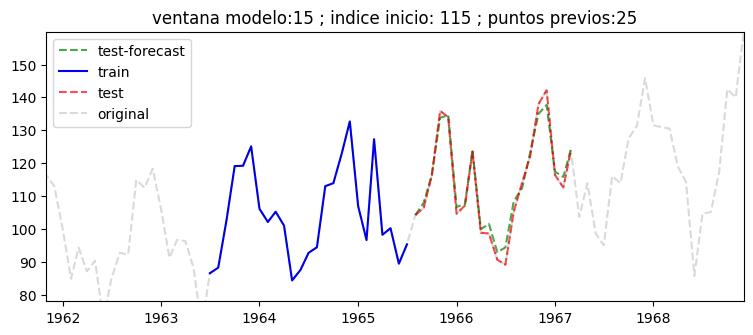

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.834
---------------------------------------------


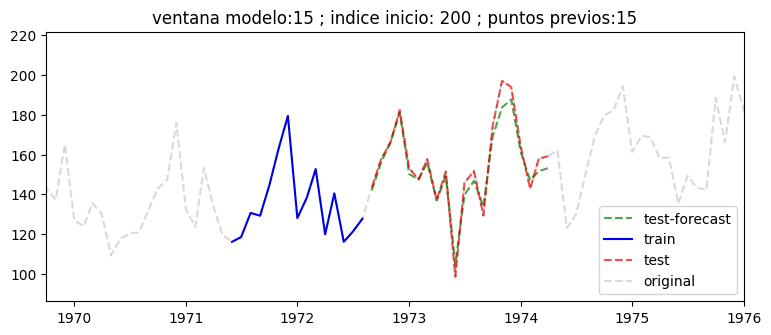

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.915


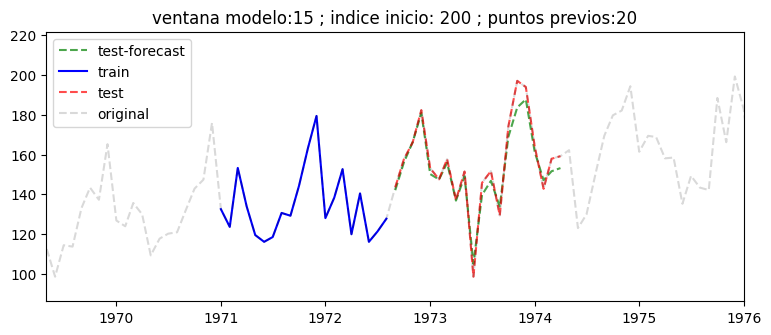

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.915


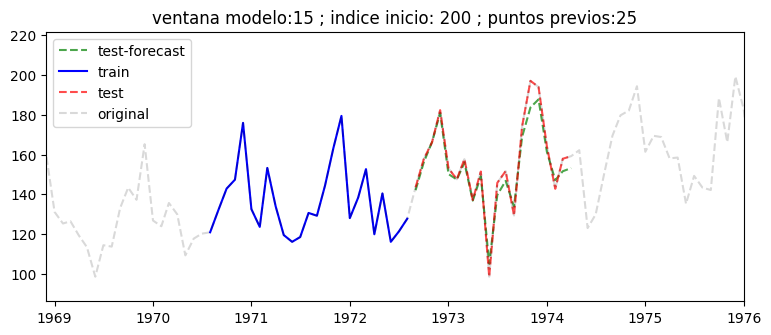

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.915
---------------------------------------------


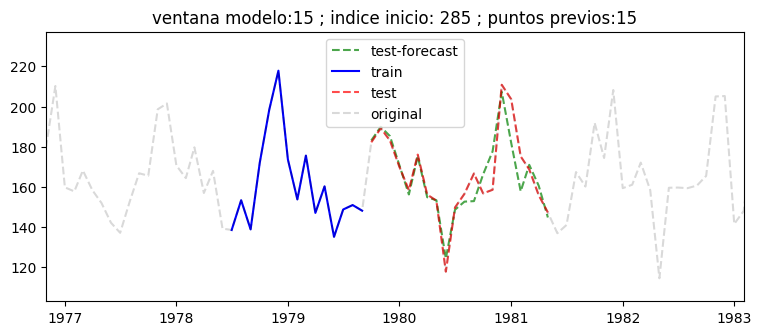

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.748


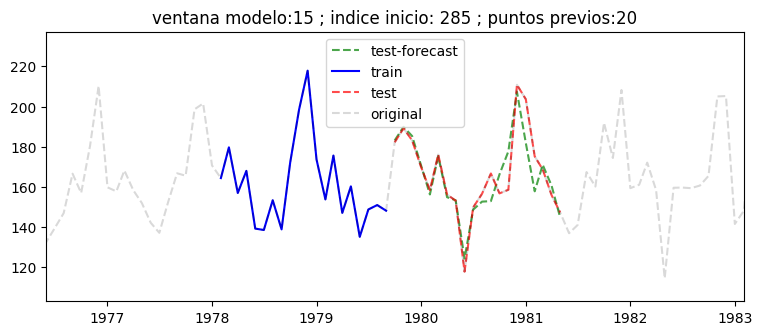

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.748


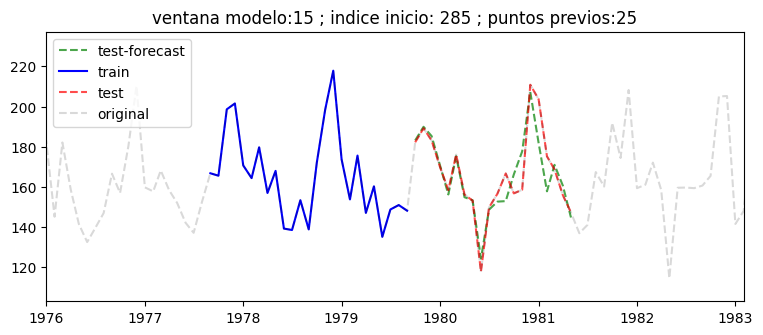

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.748
---------------------------------------------


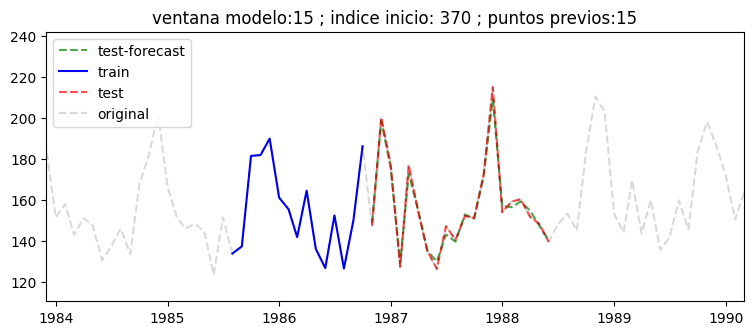

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923


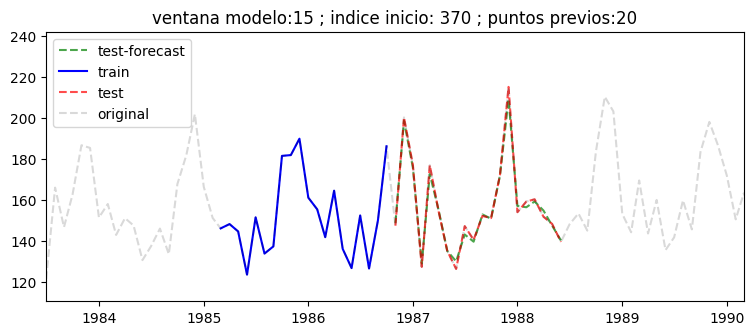

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923


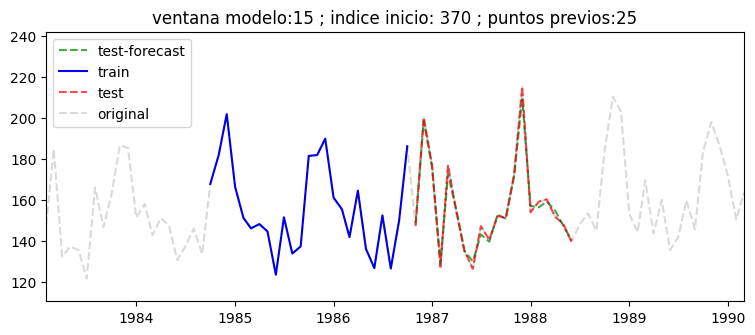

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923
---------------------------------------------


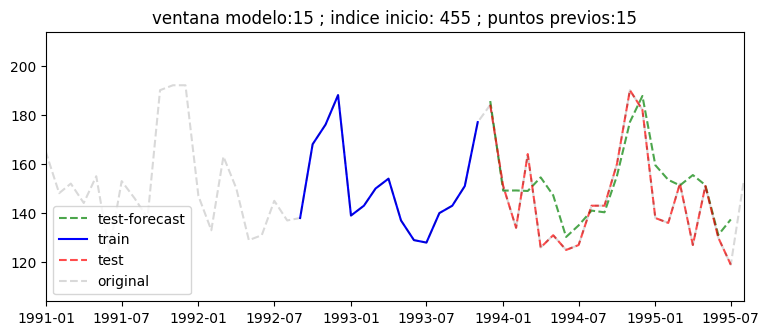

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 10.397


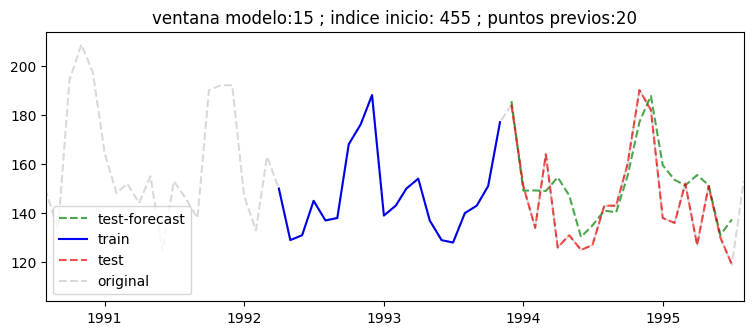

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 10.397


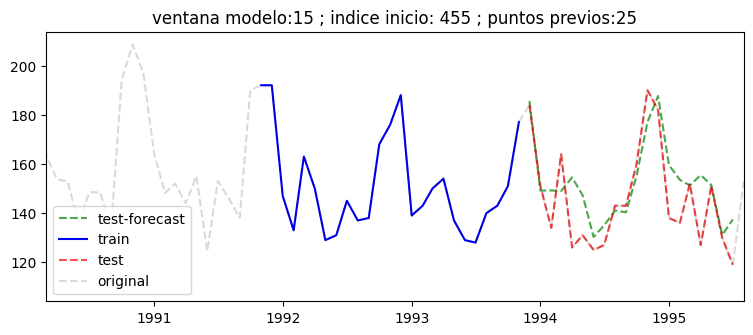

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 10.397


In [51]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite-largo < 0) else ii-margen_limite-largo
            iimax = -1 if (ii+largo_test+margen_limite >= df.shape[0]) else ii+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

## Dataset 4: Temperaturas minimas

Cantidad registros inicio raw : 3650
Cantidad registros seteo freq : 3652
Datos con NaN - pre datos raw : 5
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


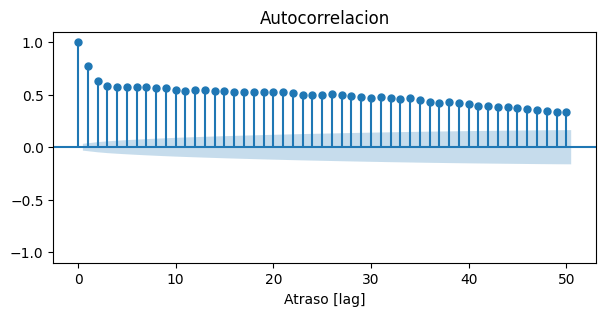

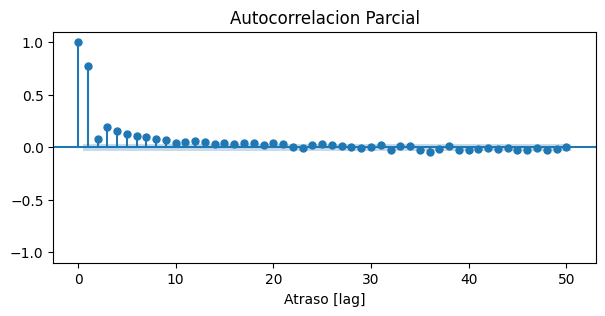

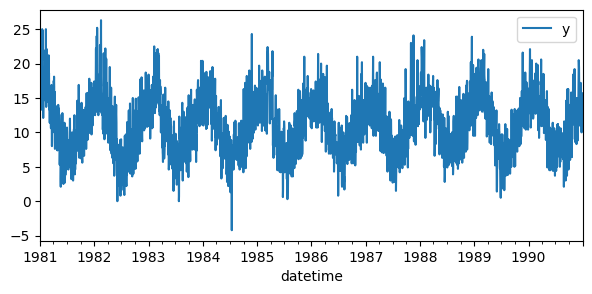

Registro :: pre: 3652  ; post: 3652  ; diferencia: 0


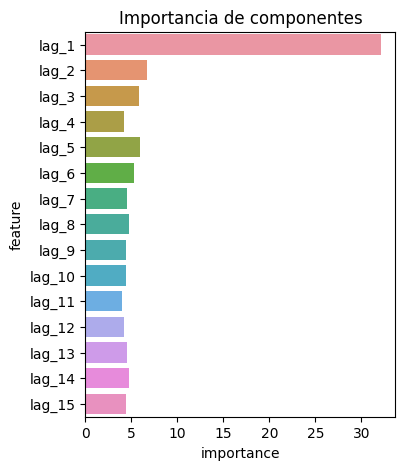

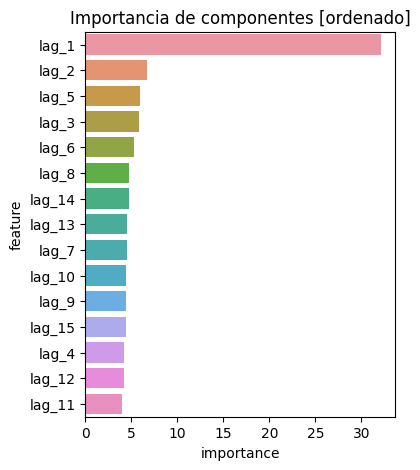

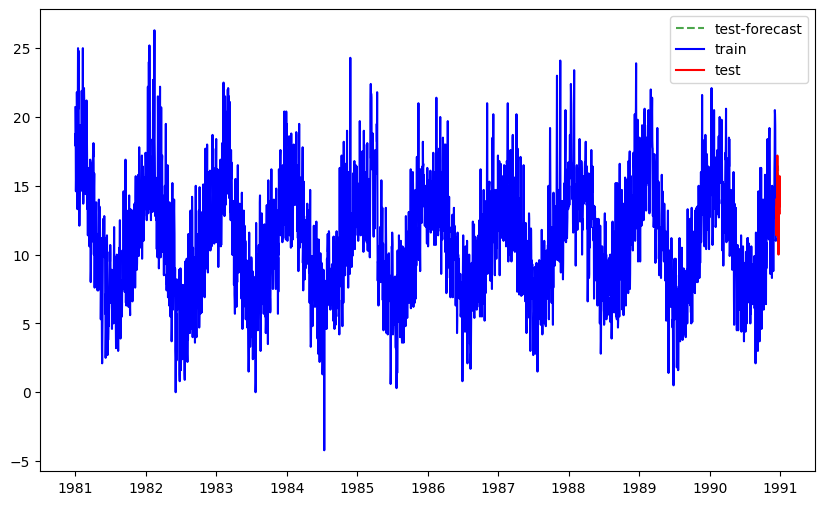

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.519


In [52]:
# Datos 4 - temperaturas minimas

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/daily-minimum-temperatures-in-me.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "Date"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y-%m-%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="D")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################


# ver autocorrelacion/parcial
autocorrela(df,n_lags=50) 

#############################################
#############################################

#############################################
# Limpieza de datos nulos (NaN's)

n_pre = df.shape[0]
df_nan = df[df.isnull().any(axis=1)].copy()
df.dropna(inplace=True)
n_post = df.shape[0]

print('Registro :: pre:',n_pre,' ; post:',n_post,' ; diferencia:',n_pre-n_post)

#############################################
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

#############################################
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=1000,
                  l2_leaf_reg=0.2,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])

#############################################
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

#############################################
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])

#############################################
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()


plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

---------------------------------------------


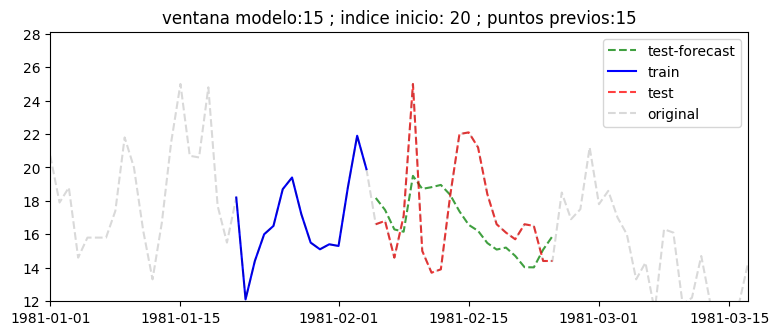

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.652


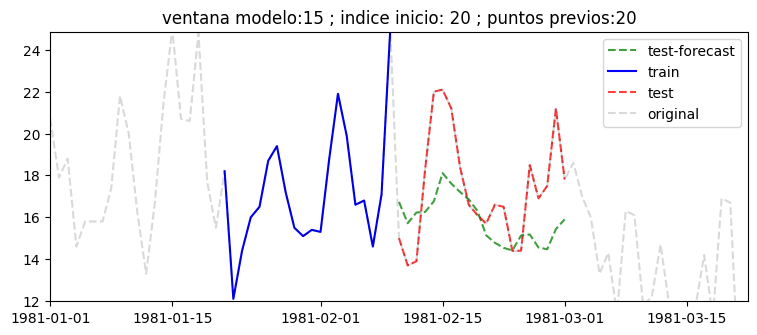

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.201


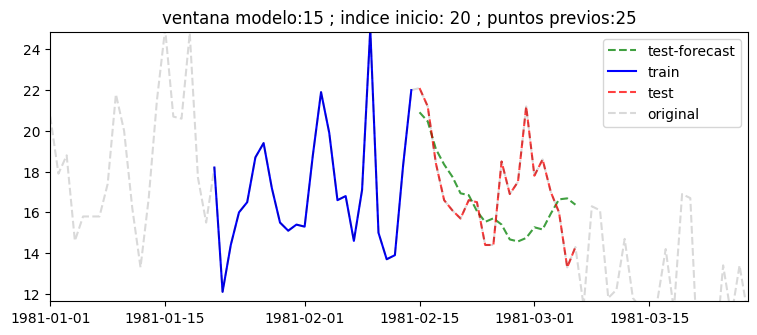

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.912
---------------------------------------------


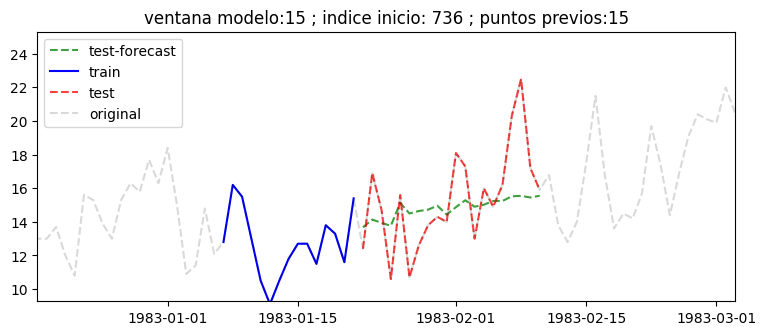

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.977


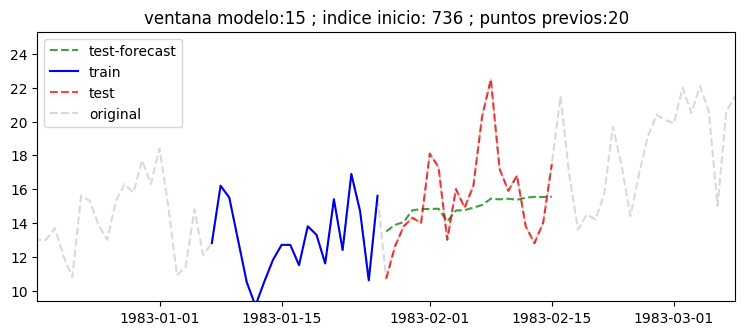

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.952


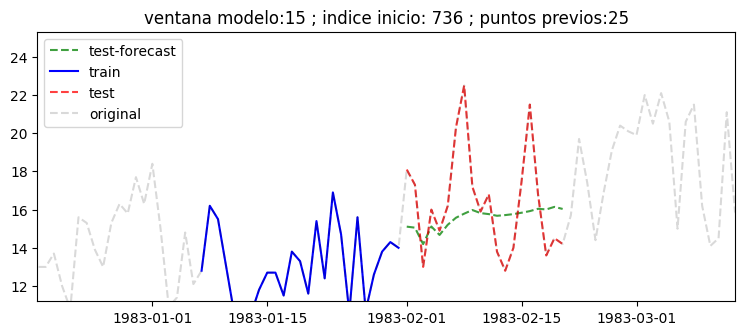

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.138
---------------------------------------------


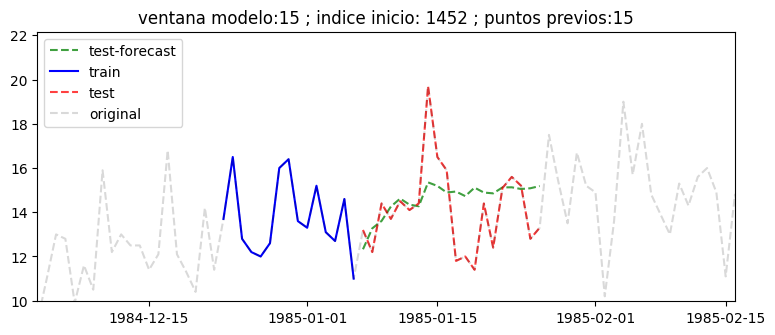

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.390


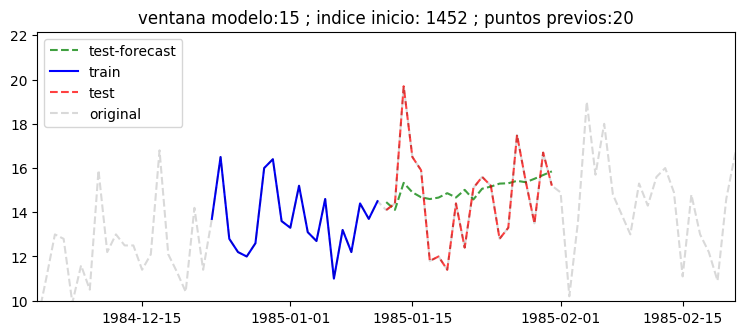

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.552


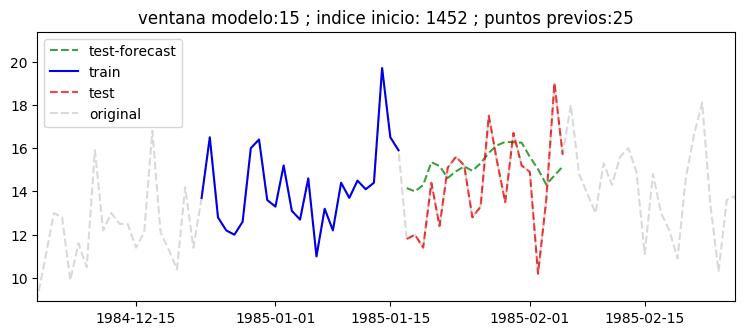

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.705
---------------------------------------------


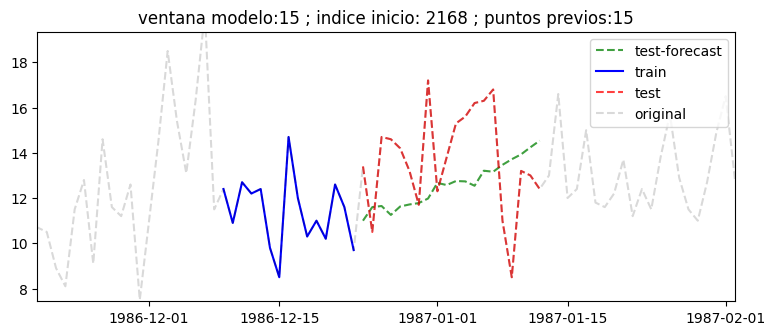

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.421


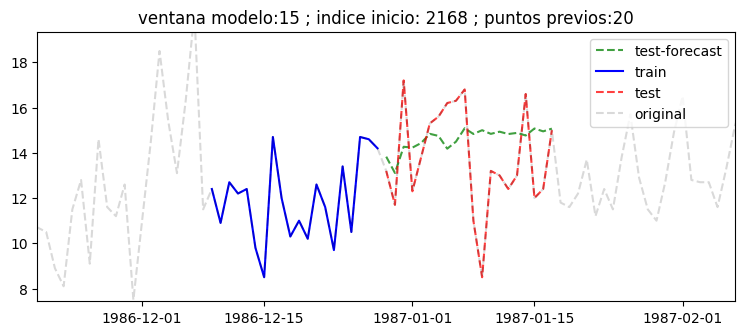

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.006


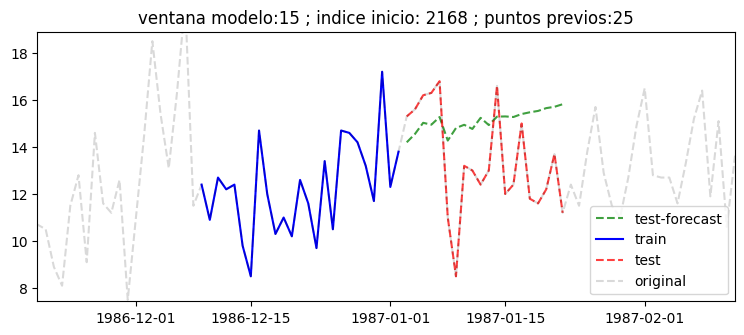

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.482
---------------------------------------------


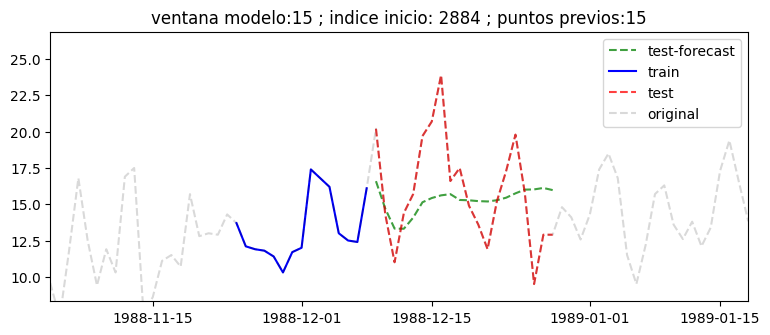

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.727


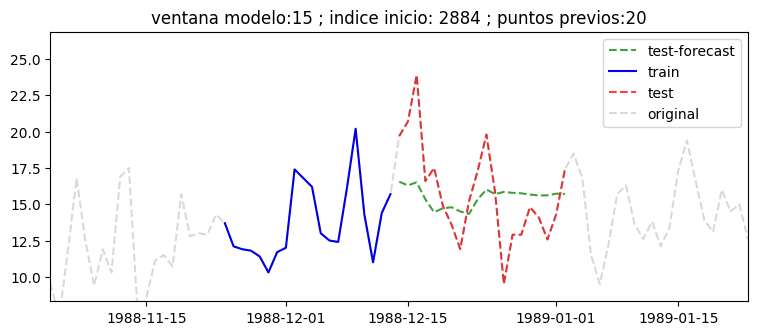

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.528


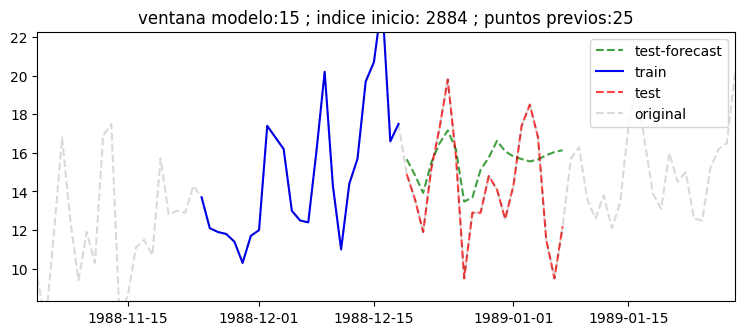

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.217
---------------------------------------------


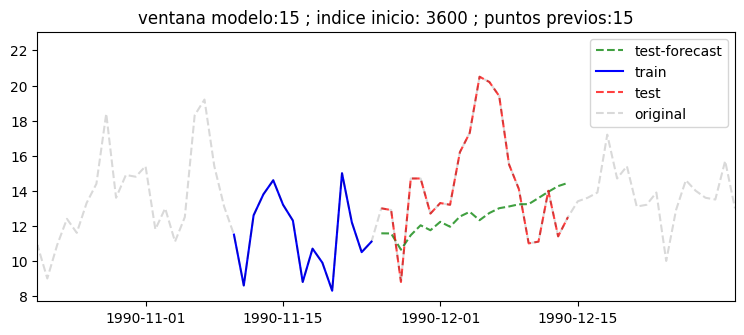

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.842


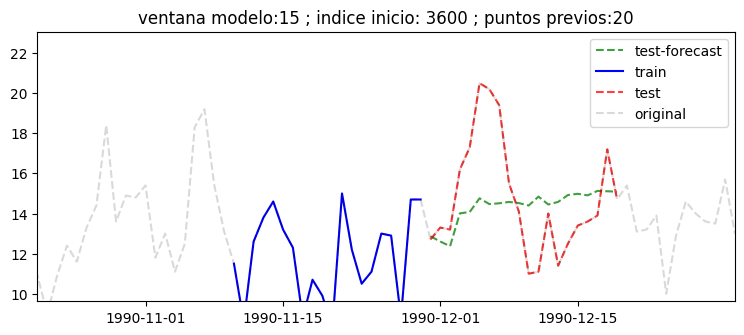

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.230


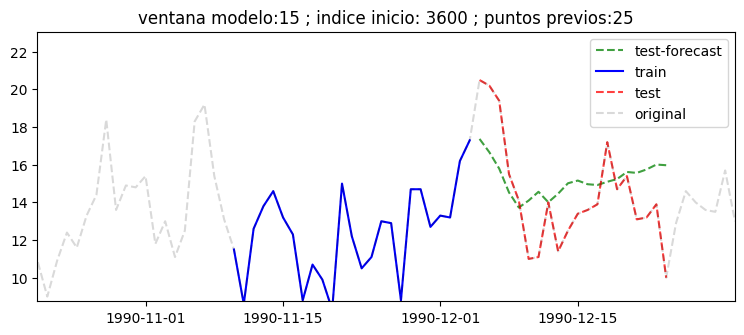

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.194


In [53]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        
        try:
            # extraer datos input al modelo
            df_previos = df.iloc[ii:ii+largo]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()
            
            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.75)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.75)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite < 0) else ii-margen_limite
            iimax = -1 if (ii+largo+largo_test+margen_limite >= df.shape[0]) else ii+largo+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

---------------------------------------------


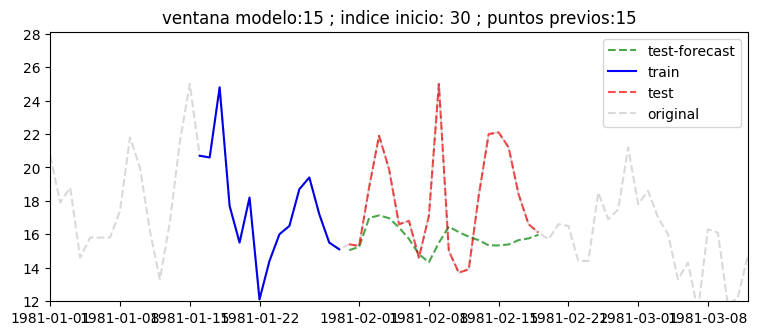

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.758


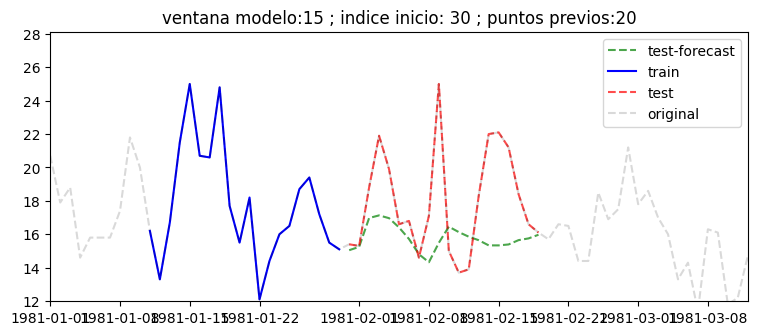

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.758


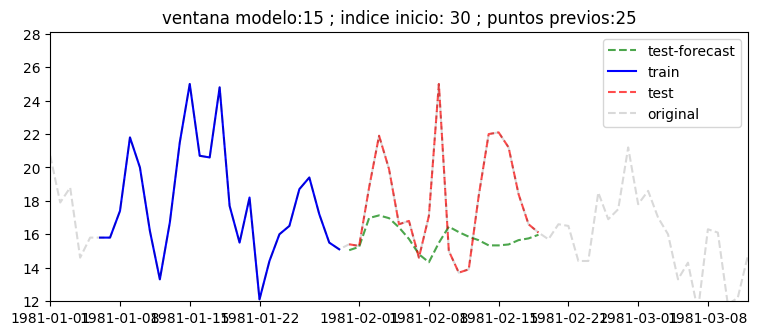

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.758
---------------------------------------------


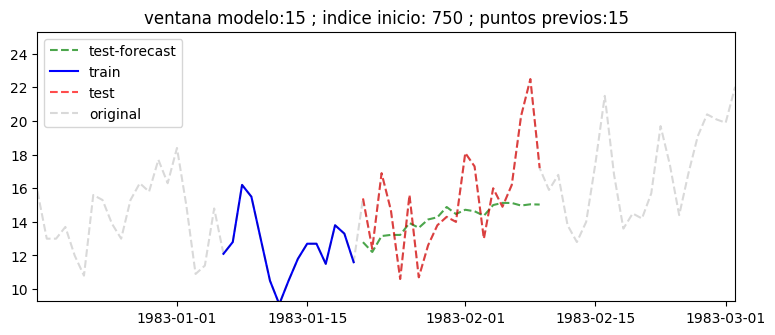

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.149


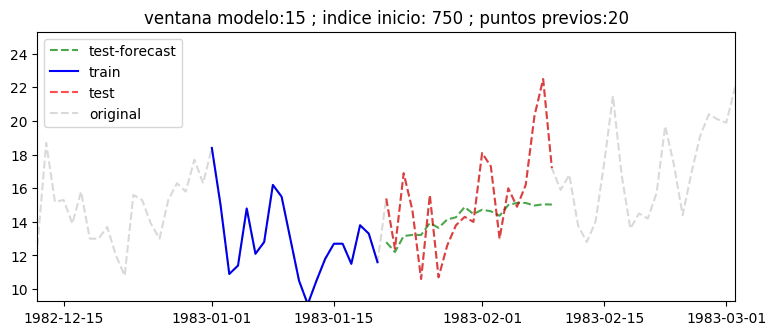

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.149


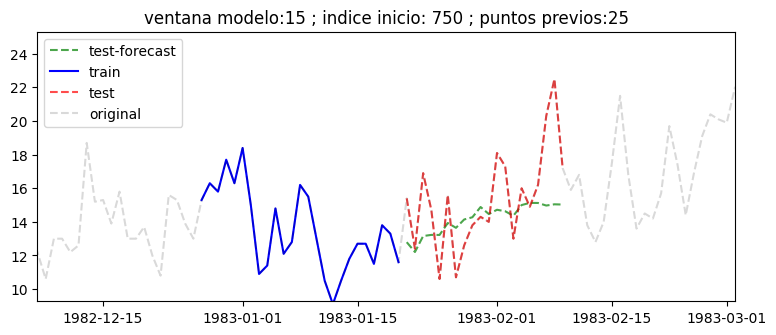

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.149
---------------------------------------------


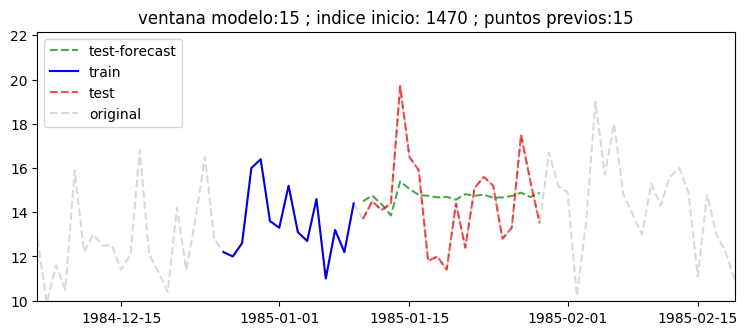

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.497


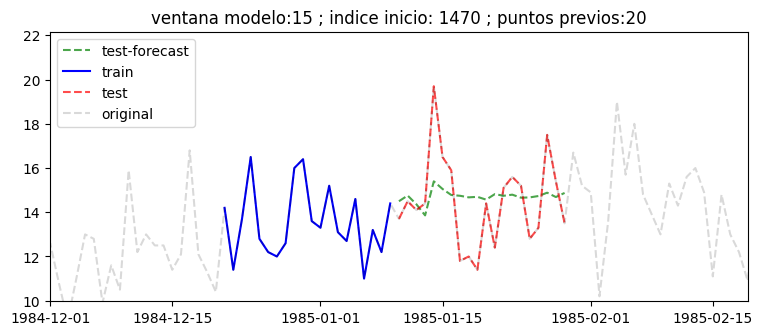

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.497


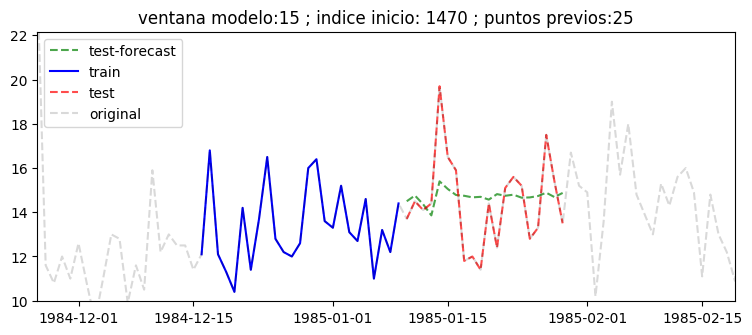

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.497
---------------------------------------------


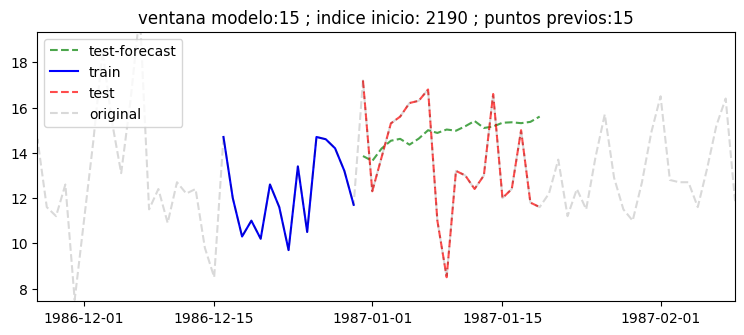

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.360


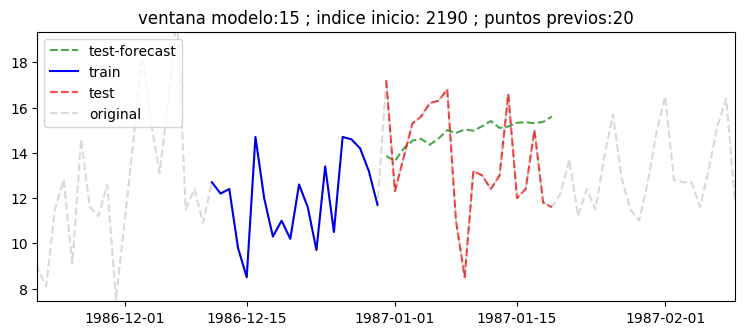

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.360


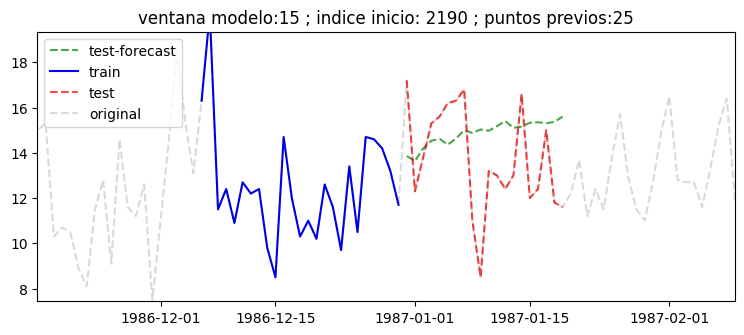

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 2.360
---------------------------------------------


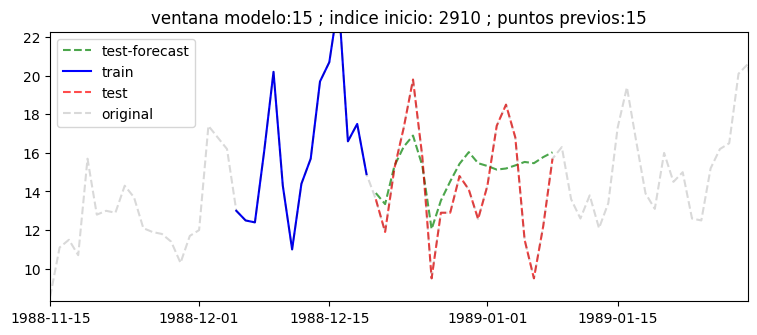

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923


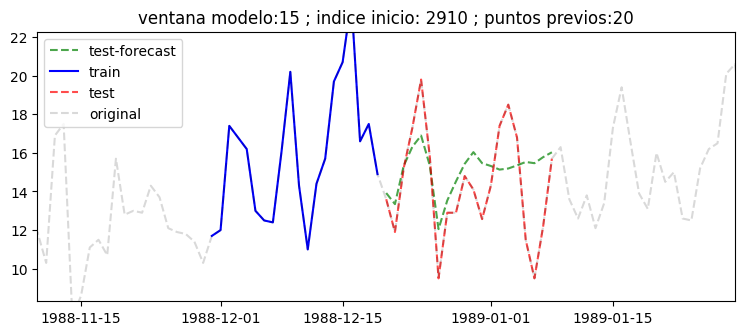

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923


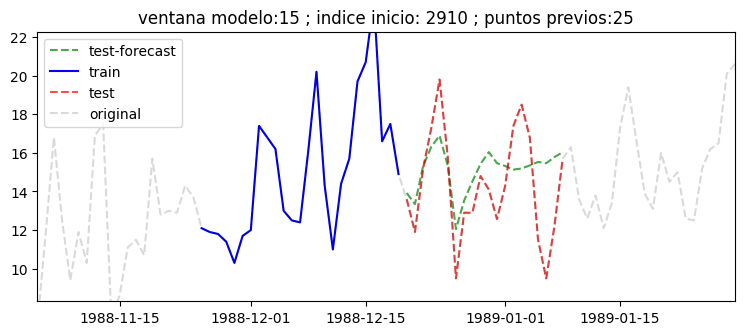

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.923
---------------------------------------------


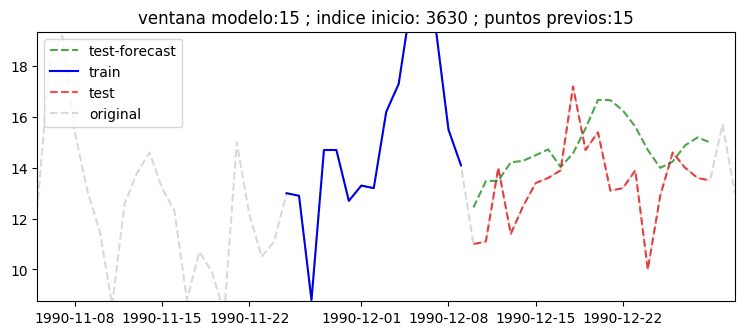

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.723


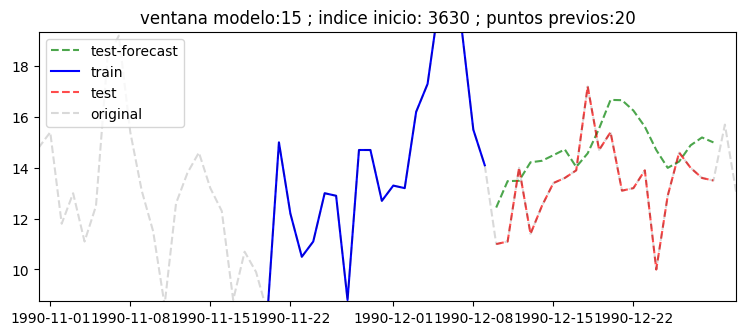

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.723


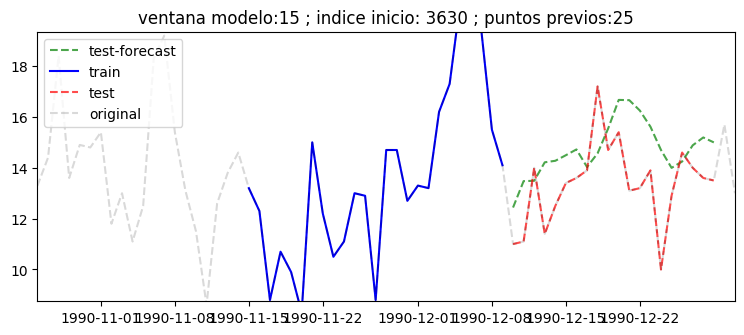

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 1.723


In [54]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Margen para ventana limite de visualizacion
margen_limite = 20

## Nota: Si se coloca un margen_limite más grande se podrá apreciar todos los datos

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            # Colocar limites a ventana a visualizar
            iimin = 0 if (ii-margen_limite-largo < 0) else ii-margen_limite-largo
            iimax = -1 if (ii+largo_test+margen_limite >= df.shape[0]) else ii+largo_test+margen_limite
            
            # Limites en eje X
            xmin = df.iloc[iimin].name
            xmax = df.iloc[iimax].name
            
            # Limites en eje Y
            ymin = 0.875*np.min([v2.values])
            ymax = 1.125*np.max([v2.values])
            
            # Indicar limites
            plt.xlim([xmin,xmax])
            plt.ylim([ymin,ymax])
            
            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

# Parte 2  - Modelo con variables exogenas (Puesta en Producción)

Este bloque incluye desde la lectura y preparación de datos, hasta el empaquetado (serializado de modelo) para la puesta en producción. Con el modelo serializado en un archivo, el cual sirve para la productivización, se mostrará ejemplos de predicción con diferentes datos de entrada.

In [55]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


In [56]:
# Crear nuevas columnas

# Variables numericas
df["x1"] = [1.5*np.cos(i) for i in range(df.shape[0])]
df["x2"] = [0.76*np.sin(i) for i in range(df.shape[0])]
df["x3"] = [0.85*(0.95*np.sin(0.875*i) + 1.16*np.cos(1.34*i)) for i in range(df.shape[0])]

# Variable categorica - Se deben convertir a numericos (one-hot encoder o similar)
#aleatorio = pd.DataFrame({"aleatorio":["A","B","C"]})
#df["x3"] = [aleatorio.sample(1)["aleatorio"].values[0] for i in range(df.shape[0])]

df

,y,x1,x2,x3
datetime,,,,
1991-07-01,0.429795,1.500000,0.000000,0.986000
1991-08-01,0.400906,0.810453,0.639518,0.845342
1991-09-01,0.432159,-0.624220,0.691066,-0.088241
1991-10-01,0.492543,-1.484989,0.107251,-0.230600
1991-11-01,0.502369,-0.980465,-0.575170,0.311579
...,...,...,...,...
2008-02-01,0.761822,-0.707439,-0.670167,-1.702951
2008-03-01,0.649435,0.730782,-0.663706,-1.208666
2008-04-01,0.827887,1.497124,-0.047037,0.616605


In [57]:
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

train_df.shape, test_df.shape

((184, 4), (20, 4))

## Ejemplo modelo catboost

In [58]:
# Entrenar modelo 

exog_col_names = df.columns.tolist()[1:]
included_exog = True

# Modelo
forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=True,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

# Entrenar el modelo
forecaster.fit(y=train_df["y"], exog = train_df[df.columns.tolist()[1:]])
forecaster

0:	learn: 0.2021202	total: 1.21ms	remaining: 604ms
1:	learn: 0.1977273	total: 2.29ms	remaining: 571ms
2:	learn: 0.1928882	total: 3.36ms	remaining: 557ms
3:	learn: 0.1882613	total: 4.43ms	remaining: 549ms
4:	learn: 0.1843524	total: 5.53ms	remaining: 547ms
5:	learn: 0.1799549	total: 6.46ms	remaining: 532ms
6:	learn: 0.1756885	total: 7.41ms	remaining: 522ms
7:	learn: 0.1715649	total: 8.42ms	remaining: 518ms
8:	learn: 0.1676005	total: 9.35ms	remaining: 510ms
9:	learn: 0.1637053	total: 10.2ms	remaining: 501ms
10:	learn: 0.1597860	total: 11.1ms	remaining: 493ms
11:	learn: 0.1561743	total: 12ms	remaining: 487ms
12:	learn: 0.1525435	total: 12.8ms	remaining: 480ms
13:	learn: 0.1490301	total: 13.8ms	remaining: 479ms
14:	learn: 0.1459345	total: 14.7ms	remaining: 477ms
15:	learn: 0.1426030	total: 15.6ms	remaining: 473ms
16:	learn: 0.1394655	total: 16.7ms	remaining: 473ms
17:	learn: 0.1367363	total: 17.7ms	remaining: 473ms
18:	learn: 0.1337615	total: 18.7ms	remaining: 474ms
19:	learn: 0.1306626	tot

231:	learn: 0.0200547	total: 198ms	remaining: 229ms
232:	learn: 0.0199644	total: 199ms	remaining: 228ms
233:	learn: 0.0198417	total: 200ms	remaining: 227ms
234:	learn: 0.0196804	total: 201ms	remaining: 226ms
235:	learn: 0.0196044	total: 202ms	remaining: 226ms
236:	learn: 0.0194324	total: 202ms	remaining: 225ms
237:	learn: 0.0193498	total: 203ms	remaining: 224ms
238:	learn: 0.0192606	total: 204ms	remaining: 223ms
239:	learn: 0.0191304	total: 205ms	remaining: 222ms
240:	learn: 0.0190279	total: 206ms	remaining: 221ms
241:	learn: 0.0189583	total: 207ms	remaining: 220ms
242:	learn: 0.0188170	total: 208ms	remaining: 220ms
243:	learn: 0.0187423	total: 208ms	remaining: 219ms
244:	learn: 0.0186048	total: 209ms	remaining: 218ms
245:	learn: 0.0185082	total: 210ms	remaining: 217ms
246:	learn: 0.0184314	total: 211ms	remaining: 216ms
247:	learn: 0.0183442	total: 212ms	remaining: 215ms
248:	learn: 0.0182631	total: 213ms	remaining: 215ms
249:	learn: 0.0181472	total: 214ms	remaining: 214ms
250:	learn: 

462:	learn: 0.0052530	total: 396ms	remaining: 31.7ms
463:	learn: 0.0052329	total: 397ms	remaining: 30.8ms
464:	learn: 0.0052031	total: 398ms	remaining: 30ms
465:	learn: 0.0051534	total: 399ms	remaining: 29.1ms
466:	learn: 0.0051295	total: 400ms	remaining: 28.3ms
467:	learn: 0.0051012	total: 401ms	remaining: 27.4ms
468:	learn: 0.0050770	total: 402ms	remaining: 26.5ms
469:	learn: 0.0050437	total: 402ms	remaining: 25.7ms
470:	learn: 0.0050011	total: 403ms	remaining: 24.8ms
471:	learn: 0.0049795	total: 404ms	remaining: 24ms
472:	learn: 0.0049590	total: 405ms	remaining: 23.1ms
473:	learn: 0.0049197	total: 406ms	remaining: 22.3ms
474:	learn: 0.0048898	total: 407ms	remaining: 21.4ms
475:	learn: 0.0048681	total: 407ms	remaining: 20.5ms
476:	learn: 0.0048307	total: 408ms	remaining: 19.7ms
477:	learn: 0.0048108	total: 409ms	remaining: 18.8ms
478:	learn: 0.0047934	total: 410ms	remaining: 18ms
479:	learn: 0.0047713	total: 411ms	remaining: 17.1ms
480:	learn: 0.0047458	total: 412ms	remaining: 16.3ms

ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280F8BF5940> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: True 
Type of exogenous variable: <class 'pandas.core.frame.DataFrame'> 
Exogenous variables names: ['x1', 'x2', 'x3'] 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'iterations': 500, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': True, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:18:13 
Last fit date: 2022-11-13 10:18:13 
Skforecast version: 0.5.1 
Python version: 3.9.13 

In [59]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0],
                             exog = test_df[df.columns.tolist()[1:]])
pred_df

2006-11-01    1.115015
2006-12-01    1.149297
2007-01-01    1.136402
2007-02-01    0.639043
2007-03-01    0.700530
2007-04-01    0.676783
2007-05-01    0.816438
2007-06-01    0.841248
2007-07-01    0.913337
2007-08-01    1.023657
2007-09-01    1.056902
2007-10-01    1.101751
2007-11-01    1.153476
2007-12-01    1.187274
2008-01-01    1.113074
2008-02-01    0.651710
2008-03-01    0.710829
2008-04-01    0.708151
2008-05-01    0.831619
2008-06-01    0.881507
Freq: MS, Name: pred, dtype: float64

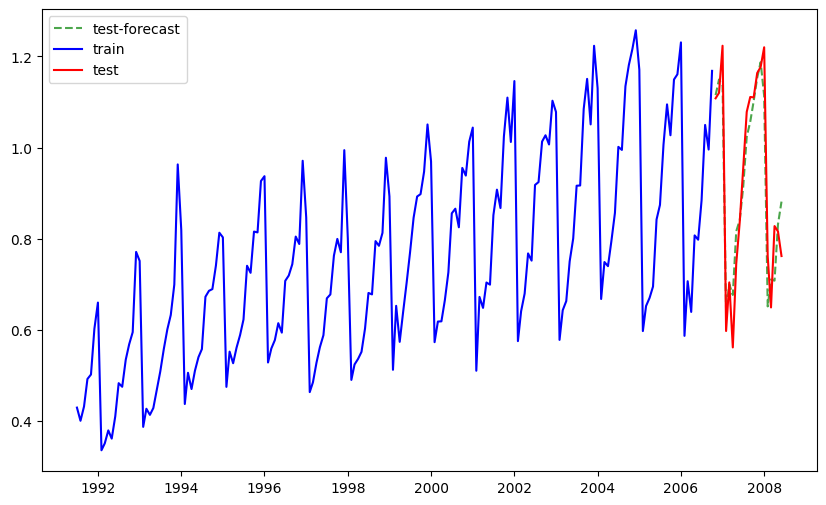

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.053


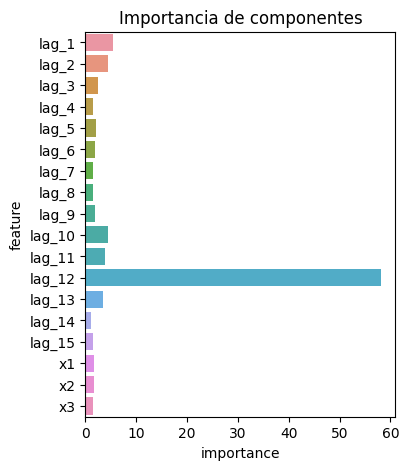

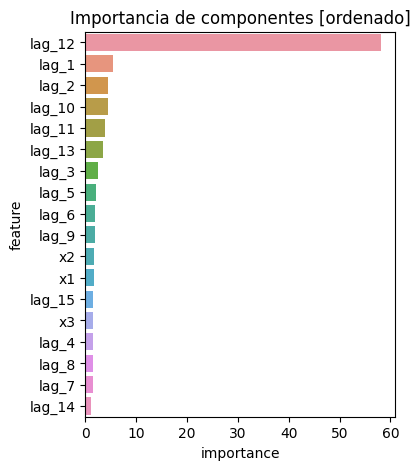

In [60]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

############################
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

En este caso se observa que las variables exogenas agregadas poseen una importancia baja, es por ello que no influenciaron el rendimiento obtenido respecto al modelo sin variables exogenas.

Guardar y leer modelo

In [61]:
# Guardar modelo en archivo

nombre_archivo = "modelo_catboost_exog.py"
dump(forecaster,nombre_archivo)
print('Se guardo modelo en:',nombre_archivo)

Se guardo modelo en: modelo_catboost_exog.py


In [62]:
# leer modelo de archivo

nombre_archivo = "modelo_catboost_exog.py"
forecaster = load(nombre_archivo)

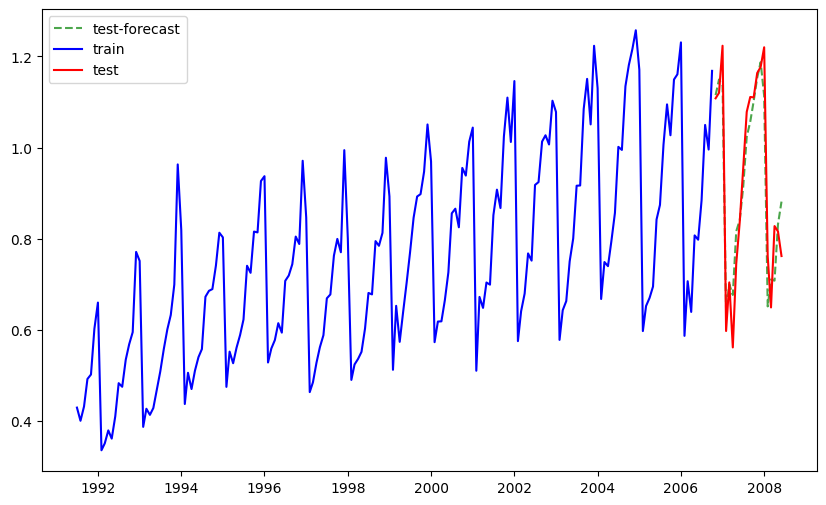

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.053


In [63]:
# Prediccion con modelo leido

pred_df_new = forecaster.predict(steps=test_df.shape[0],exog=test_df[df.columns.tolist()[1:]])

##############################

# Visualizar prediccion
v3 = pred_df_new.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

Prediccion en otros valores y variación de valores input

---------------------------------------------


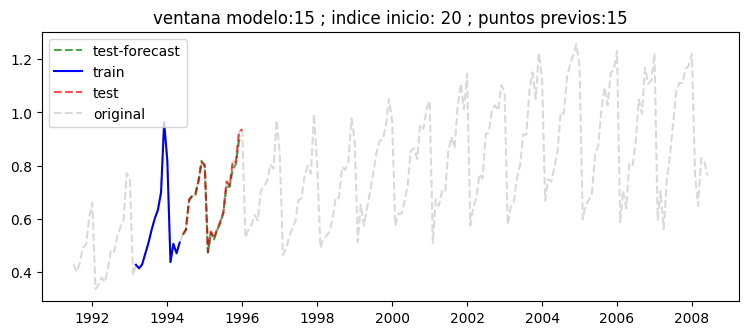

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009


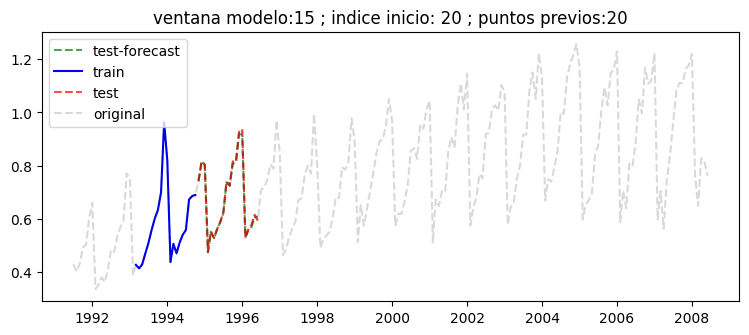

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.005


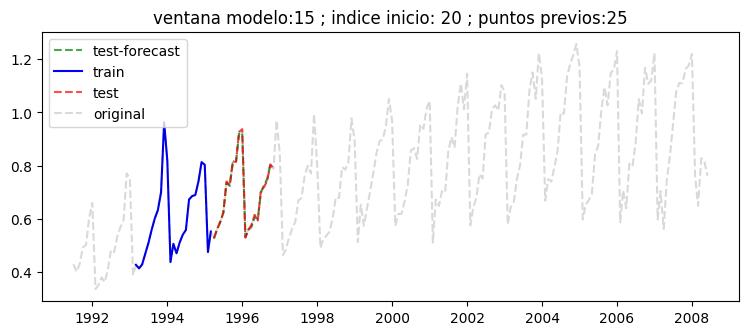

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.005
---------------------------------------------


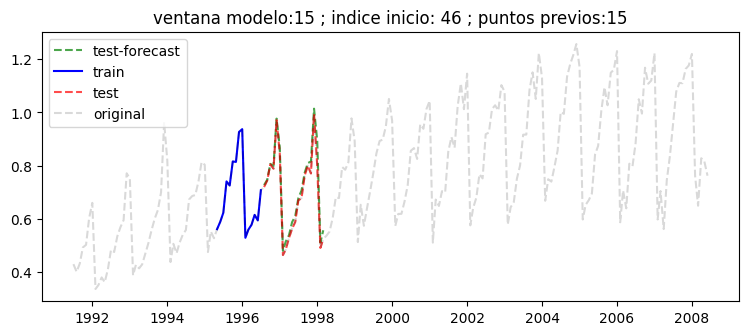

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.021


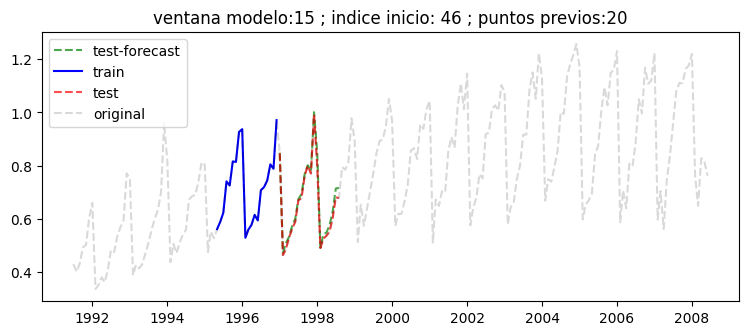

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015


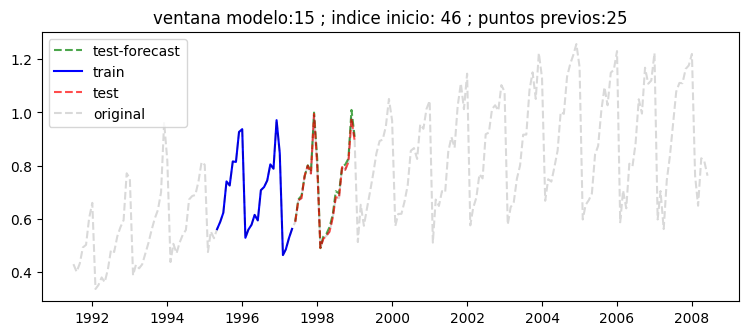

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011
---------------------------------------------


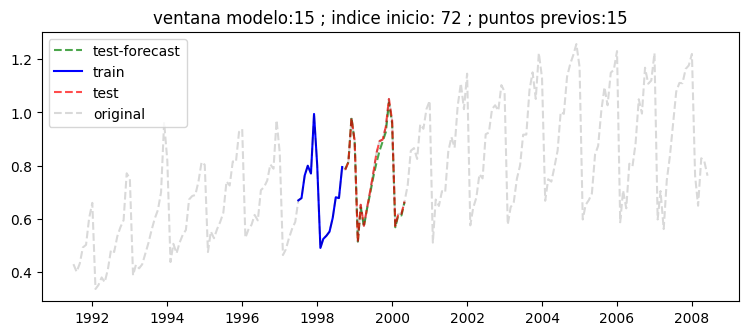

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.010


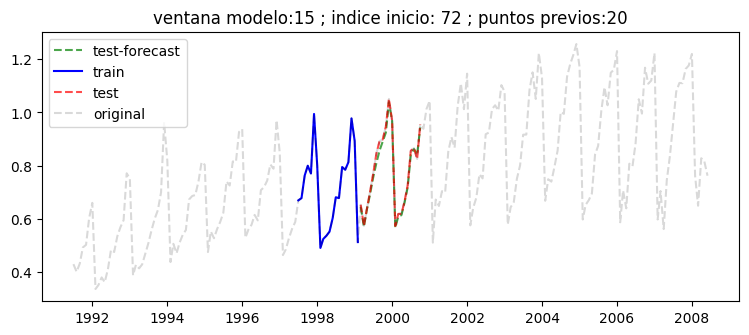

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.012


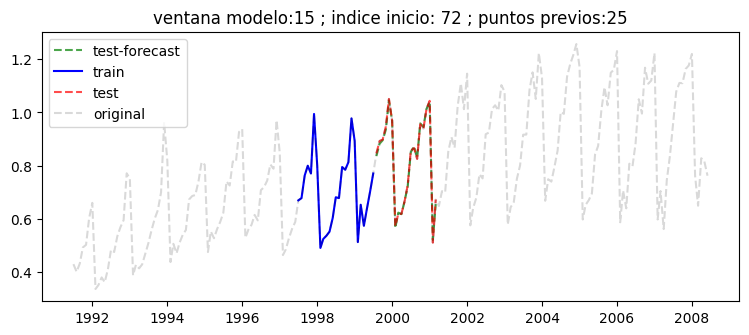

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.006
---------------------------------------------


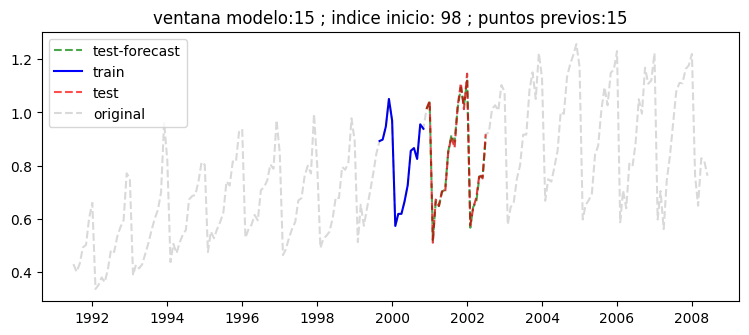

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.010


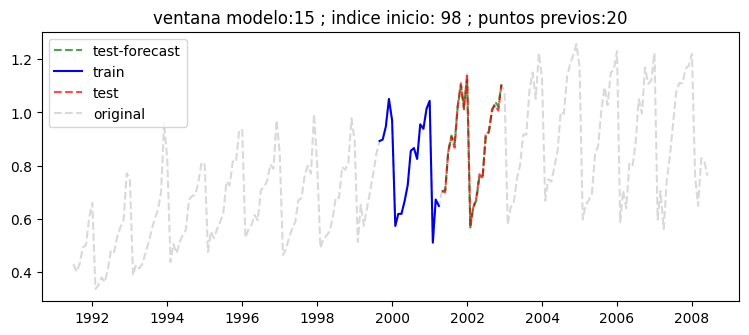

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009


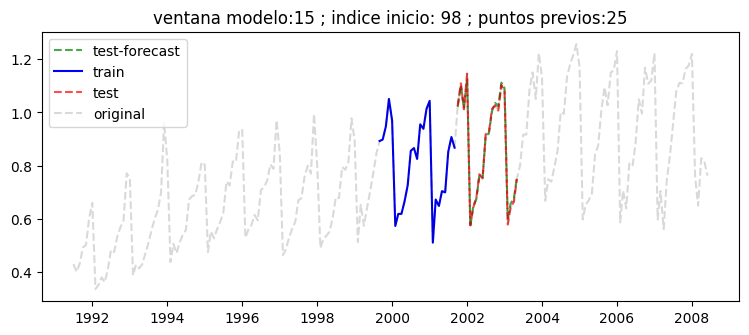

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009
---------------------------------------------


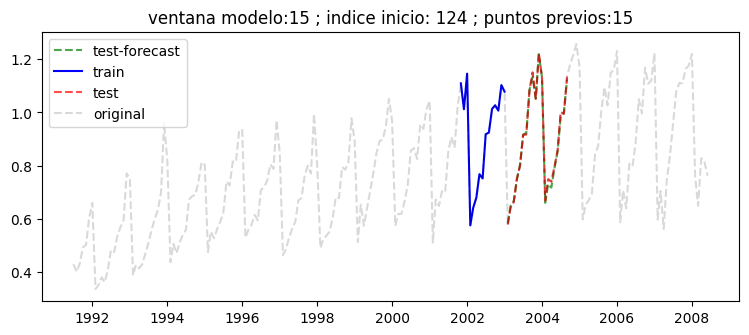

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.007


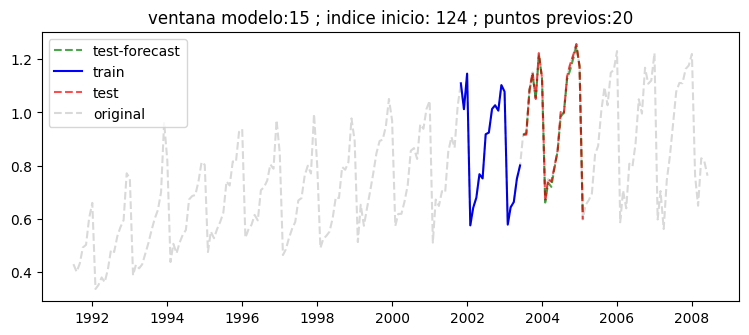

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009


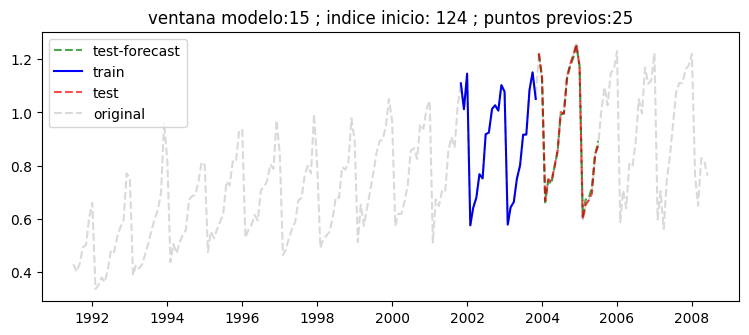

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009
---------------------------------------------


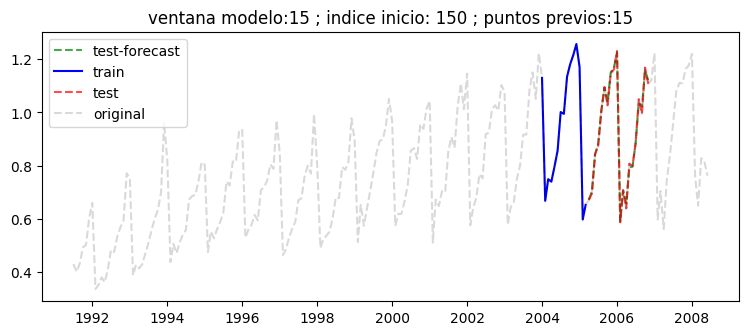

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008


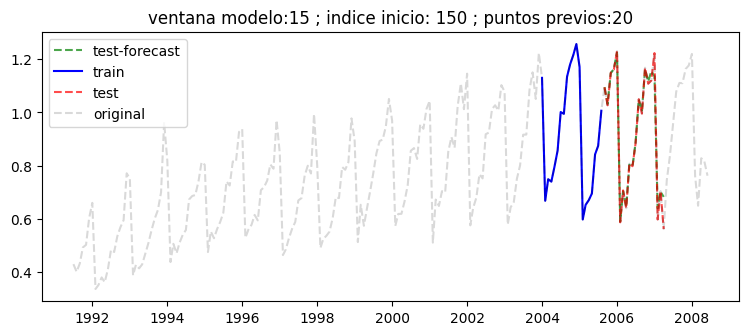

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.018


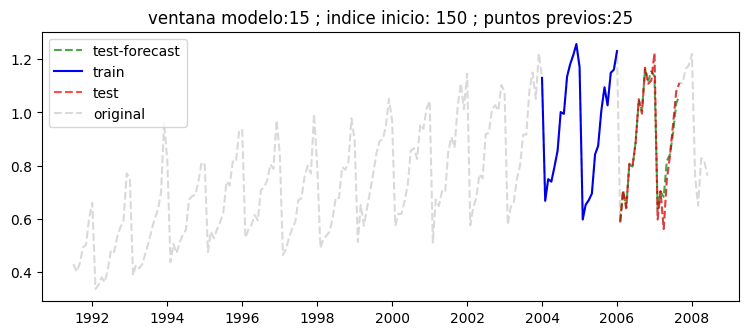

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.027


In [64]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:
            
            # extraer datos input al modelo - Valores Y (output) - Valores input exogenas
            df_previos = df.iloc[ii:ii+largo]["y"]
            df_exog = df[df.columns.tolist()[1:]].iloc[ii+largo:ii+largo+largo_test]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test, last_window=df_previos, exog=df_exog)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))

            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris

            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))
        
        except:
            pass


---------------------------------------------


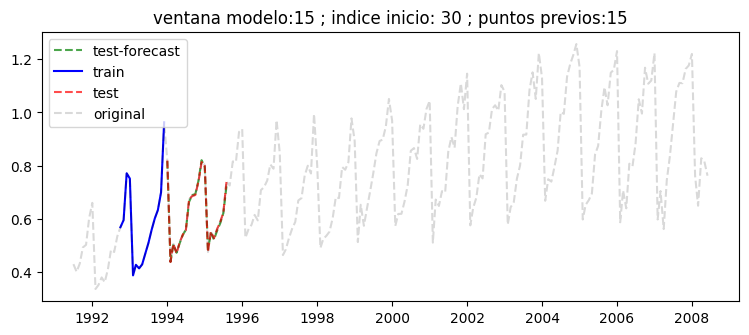

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.005


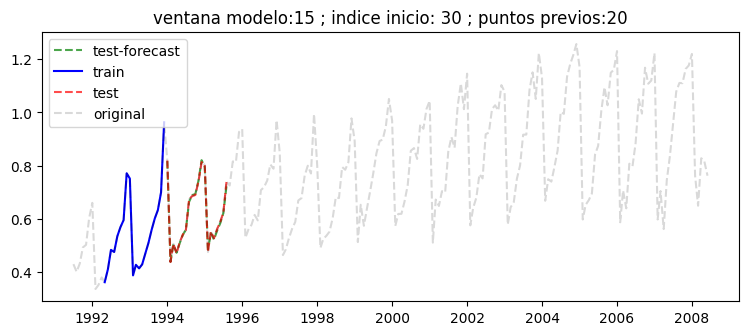

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.005


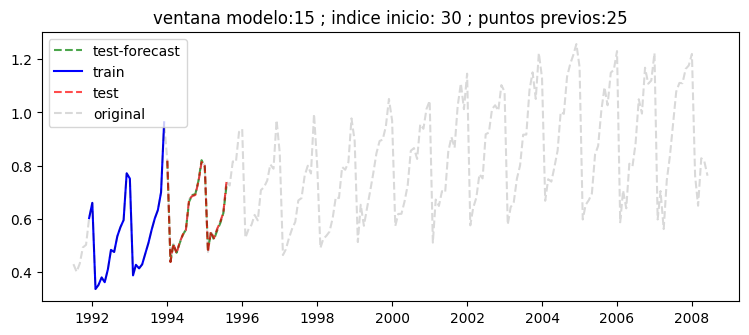

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.005
---------------------------------------------


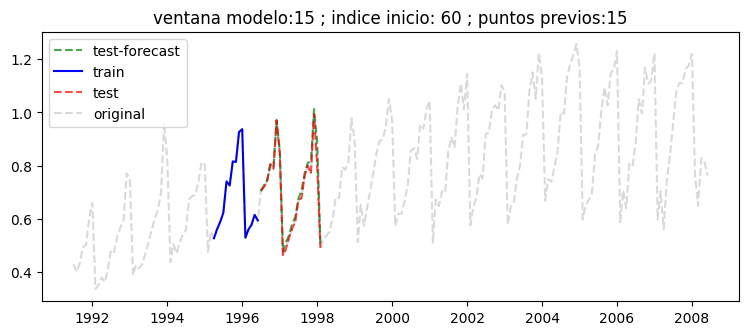

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017


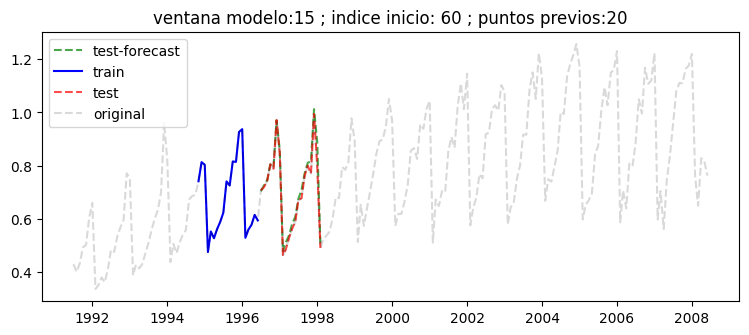

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017


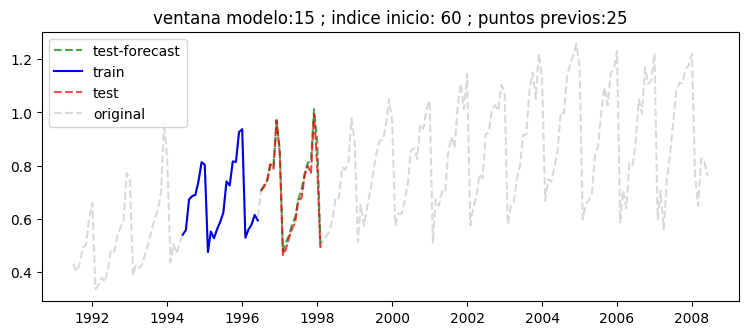

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.017
---------------------------------------------


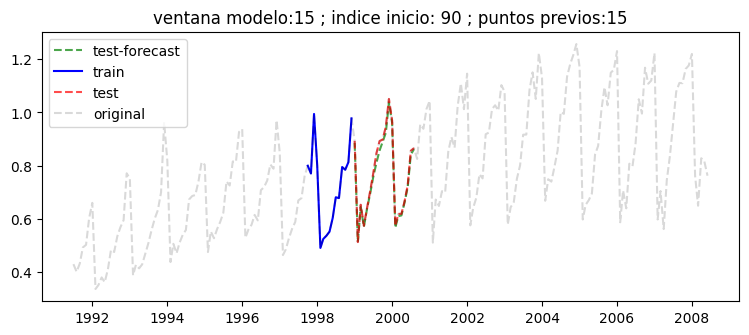

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011


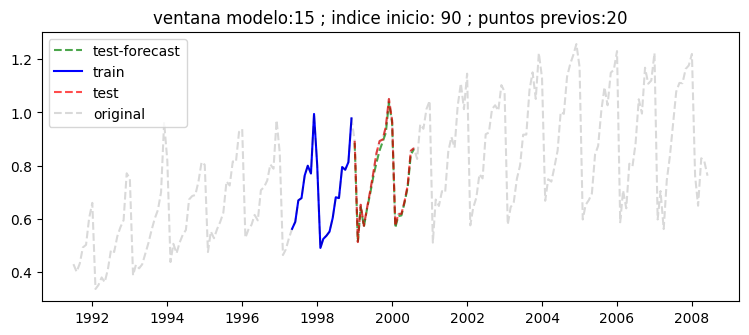

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011


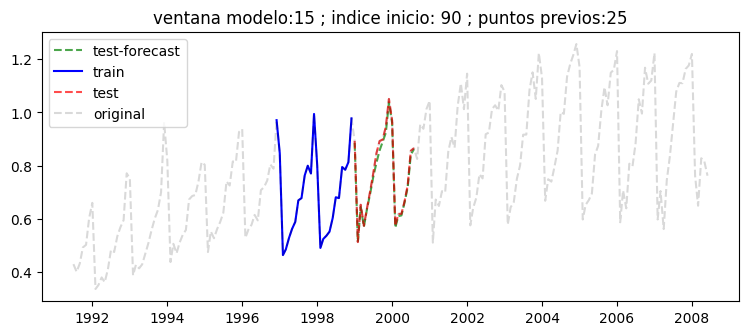

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.011
---------------------------------------------


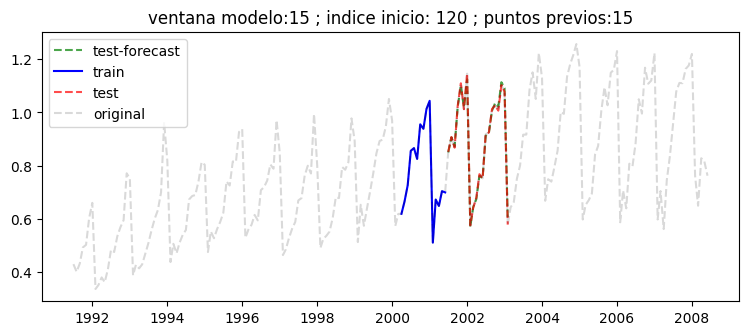

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008


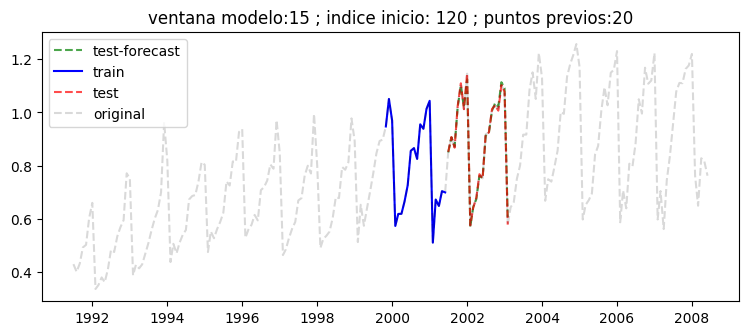

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008


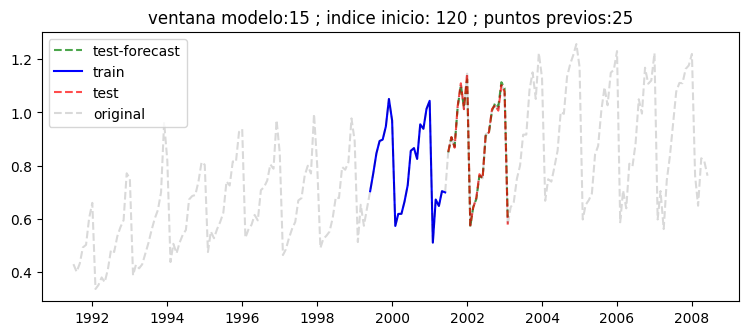

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.008
---------------------------------------------


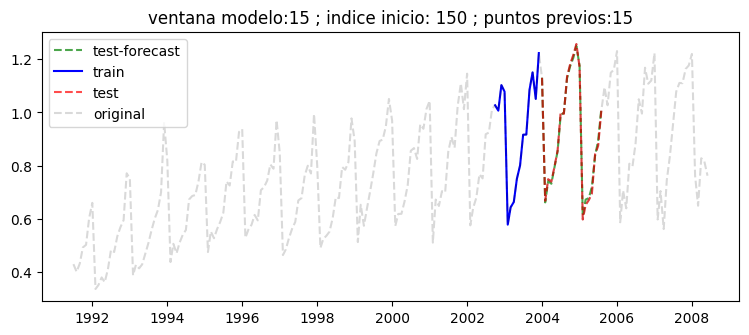

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009


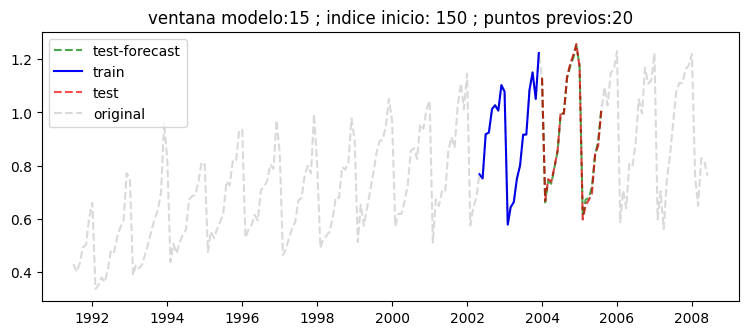

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009


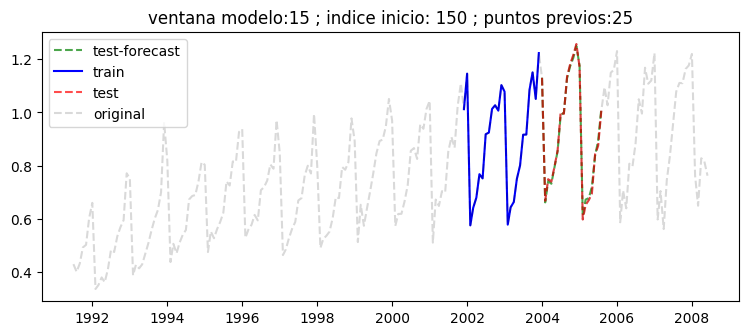

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.009
---------------------------------------------


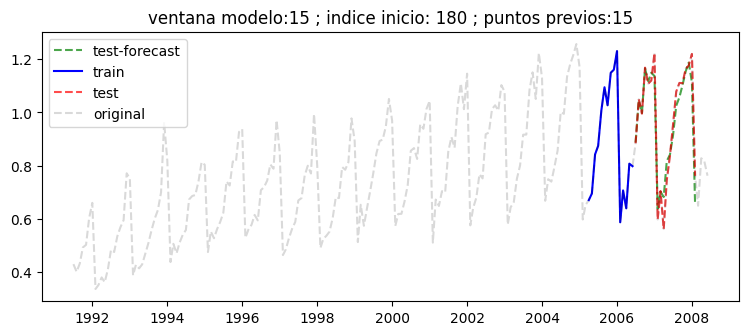

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.038


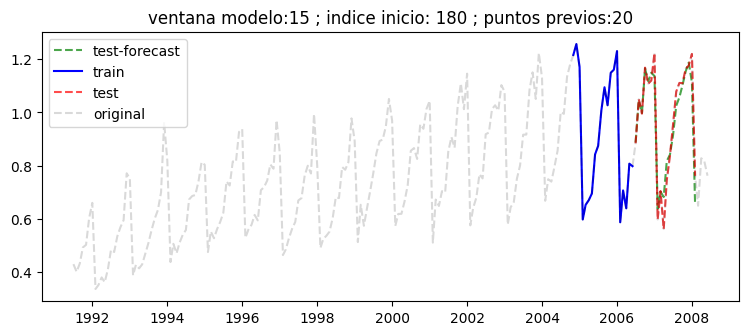

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.038


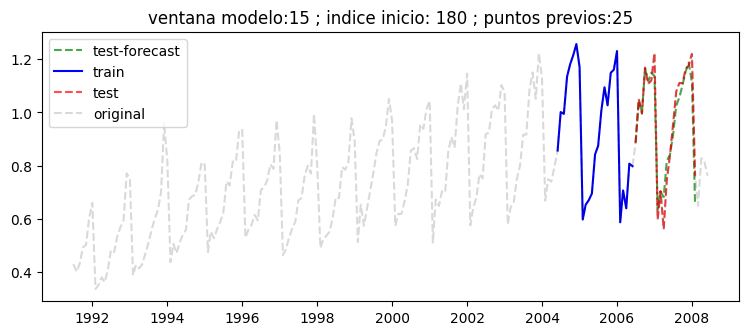

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.038


In [65]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo - Valores Y (output) - Valores input exogenas
            df_previos = df.iloc[ii-largo:ii]["y"]
            df_exog = df[df.columns.tolist()[1:]].iloc[ii:ii+largo_test]
            
            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test, last_window=df_previos, exog=df_exog)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))

            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris

            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

## Ejemplo modelo randomforest

In [66]:
# Entrenar modelo 

exog_col_names = df.columns.tolist()[1:]
included_exog = True

# Modelo
forecaster = ForecasterAutoreg(
    regressor = RandomForestRegressor(random_state=123),
    lags = 15)

# Entrenar el modelo
forecaster.fit(y=train_df["y"], exog = train_df[df.columns.tolist()[1:]])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: True 
Type of exogenous variable: <class 'pandas.core.frame.DataFrame'> 
Exogenous variables names: ['x1', 'x2', 'x3'] 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
Creation date: 2022-11-13 10:18:30 
Last fit date: 2022-11-13 10:18:30 
Skforecast version: 0.5.1 
Python version:

In [67]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0],
                             exog = test_df[df.columns.tolist()[1:]])
pred_df

2006-11-01    1.145224
2006-12-01    1.192754
2007-01-01    1.208837
2007-02-01    0.615692
2007-03-01    0.685055
2007-04-01    0.699514
2007-05-01    0.825748
2007-06-01    0.839644
2007-07-01    0.900025
2007-08-01    1.000711
2007-09-01    1.041423
2007-10-01    1.086398
2007-11-01    1.146374
2007-12-01    1.164277
2008-01-01    1.215714
2008-02-01    0.679960
2008-03-01    0.704109
2008-04-01    0.717450
2008-05-01    0.837635
2008-06-01    0.854227
Freq: MS, Name: pred, dtype: float64

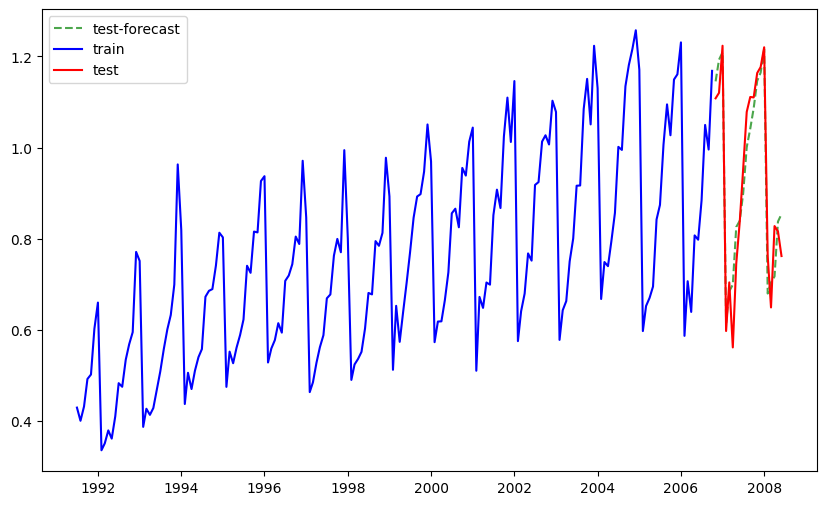

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


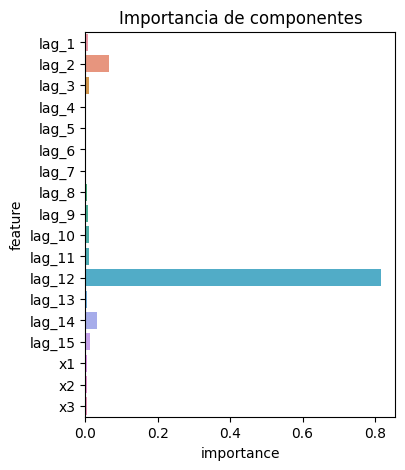

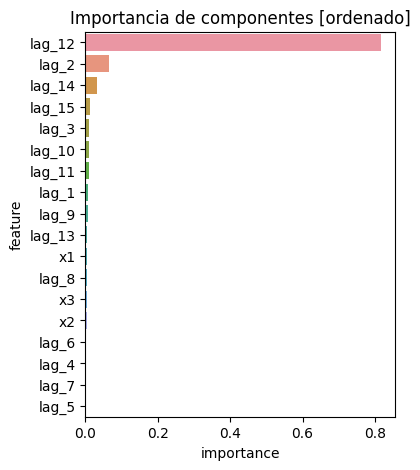

In [68]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

############################
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

En este caso se observa que las variables exogenas agregadas poseen una importancia baja, es por ello que no influenciaron el rendimiento obtenido respecto al modelo sin variables exogenas.

Guardar y leer modelo

In [69]:
# Guardar modelo en archivo

nombre_archivo = "modelo_randomforest_exog.py"
dump(forecaster,nombre_archivo)
print('Se guardo modelo en:',nombre_archivo)

Se guardo modelo en: modelo_randomforest_exog.py


In [70]:
# leer modelo de archivo

nombre_archivo = "modelo_randomforest_exog.py"
forecaster = load(nombre_archivo)

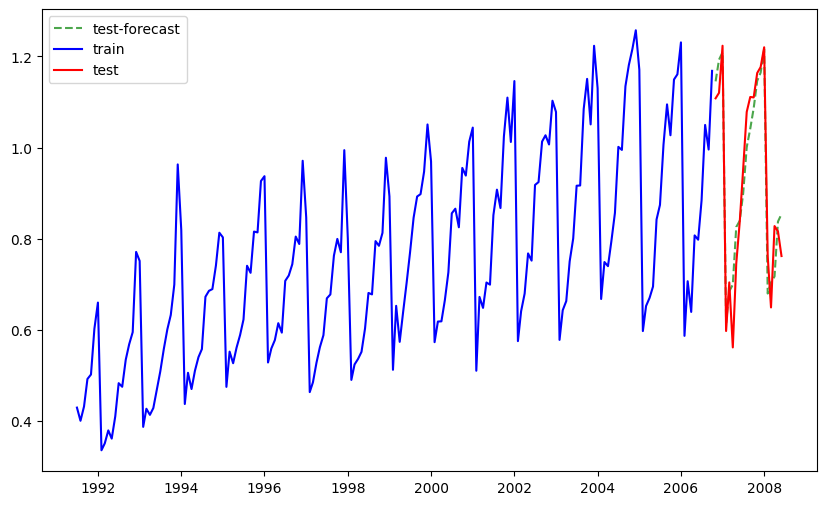

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


In [71]:
# Prediccion con modelo leido

pred_df_new = forecaster.predict(steps=test_df.shape[0],exog=test_df[df.columns.tolist()[1:]])

##############################

# Visualizar prediccion
v3 = pred_df_new.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"]))

Prediccion en otros valores y variación de valores input

---------------------------------------------


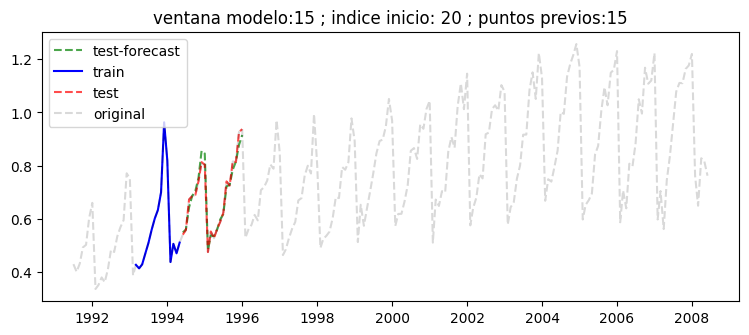

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.016


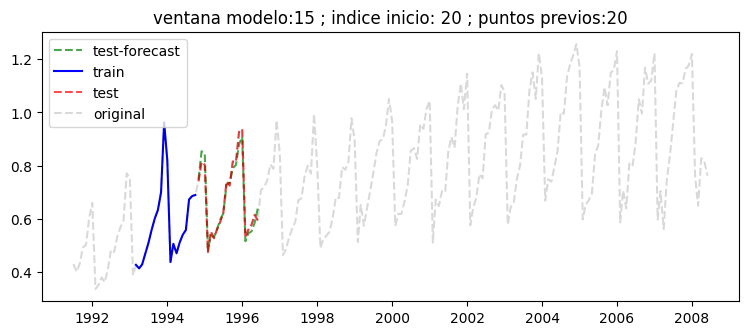

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.019


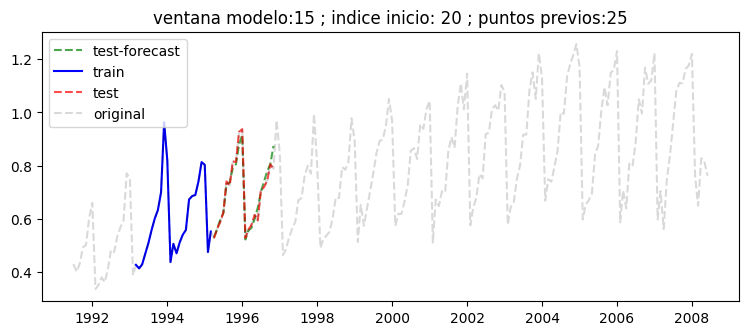

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.019
---------------------------------------------


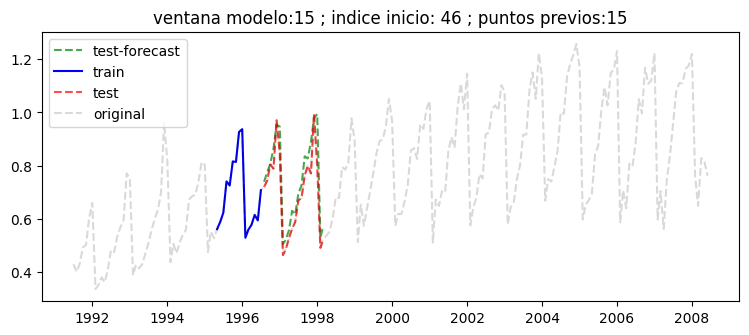

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.052


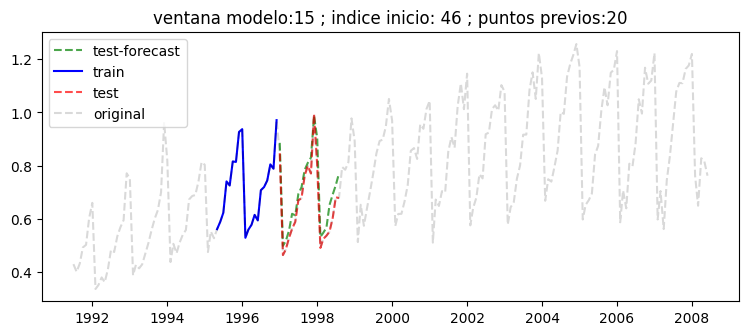

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.045


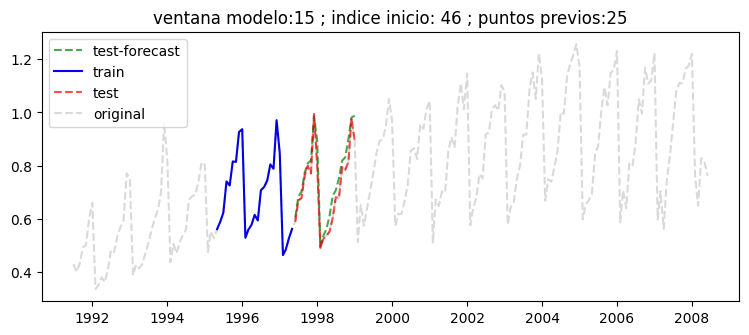

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.039
---------------------------------------------


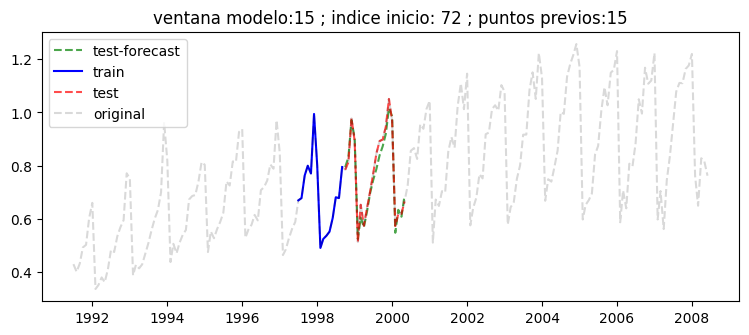

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


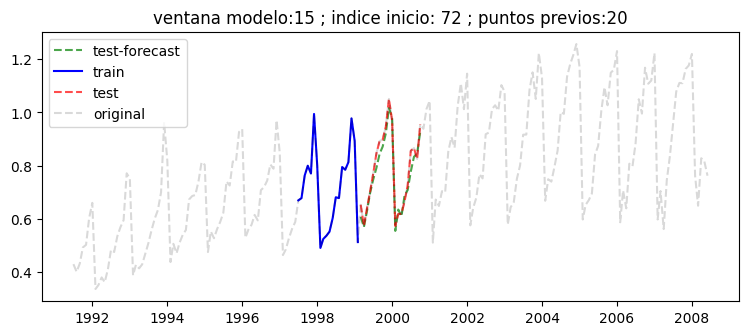

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.027


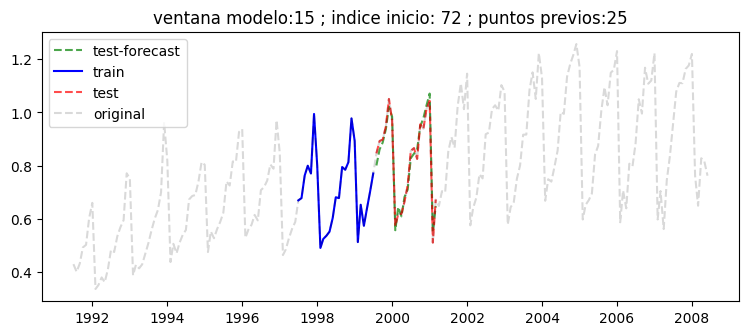

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.023
---------------------------------------------


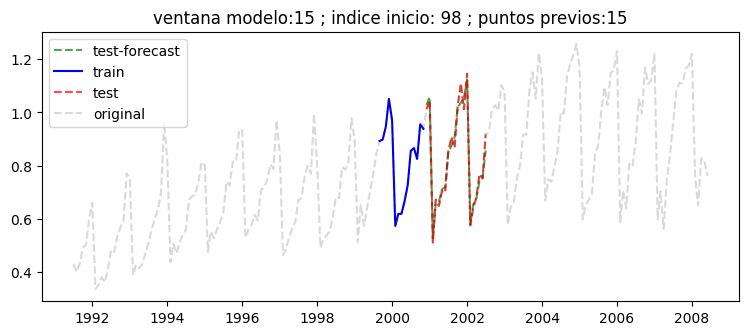

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


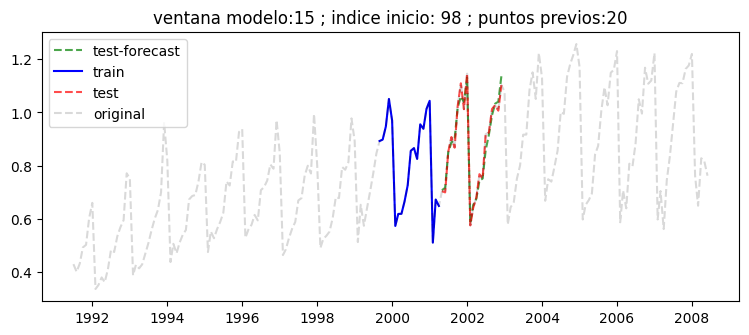

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.019


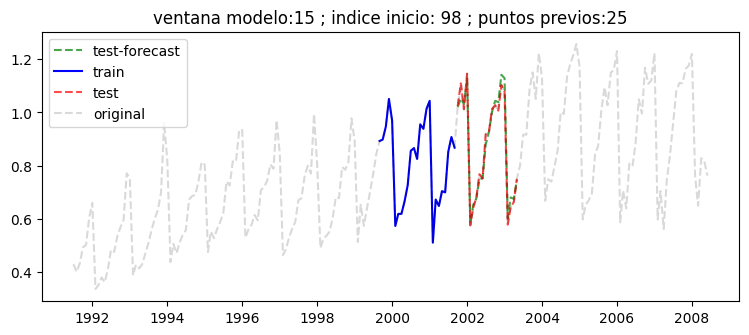

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.021
---------------------------------------------


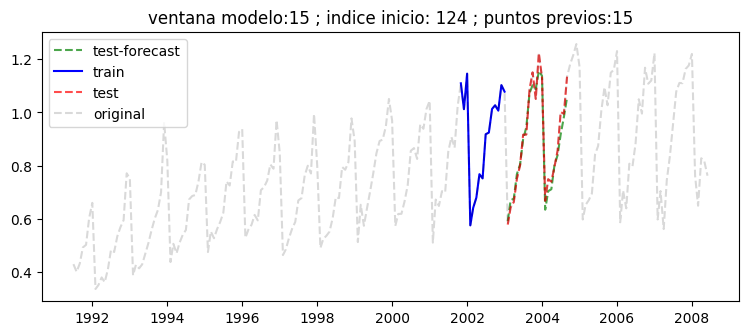

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.030


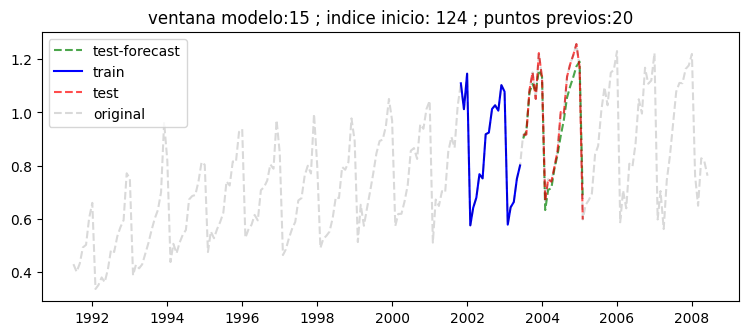

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.042


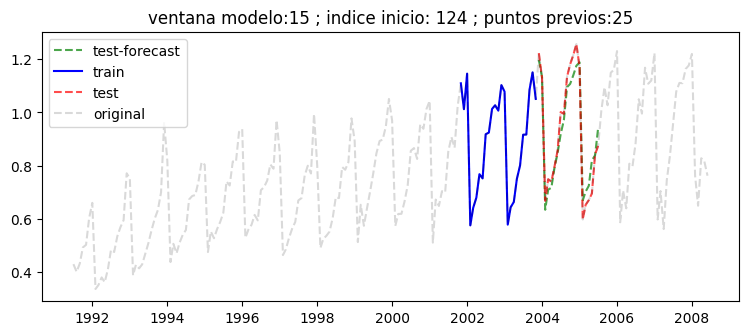

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.045
---------------------------------------------


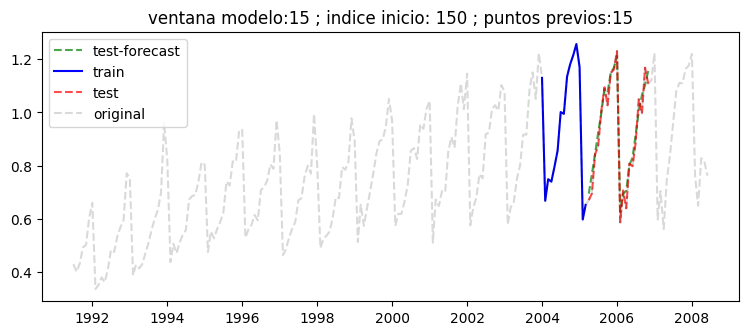

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.033


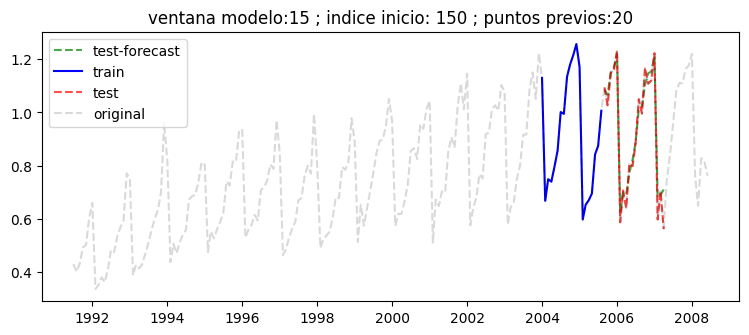

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.034


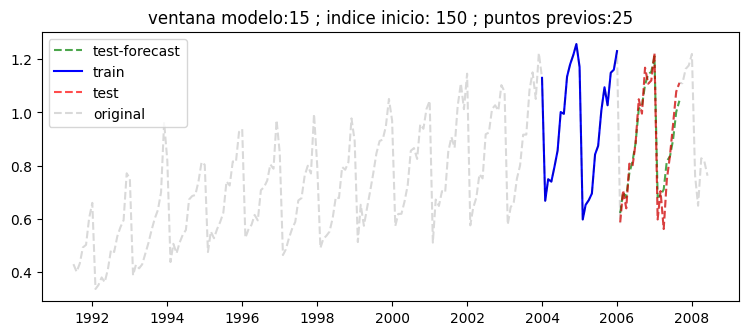

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.044


In [72]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-forecaster.max_lag,int((df.shape[0]-2*largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:
            
            # extraer datos input al modelo - Valores Y (output) - Valores input exogenas
            df_previos = df.iloc[ii:ii+largo]["y"]
            df_exog = df[df.columns.tolist()[1:]].iloc[ii+largo:ii+largo+largo_test]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test, last_window=df_previos, exog=df_exog)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))

            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris

            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))
            
        except:
            pass


---------------------------------------------


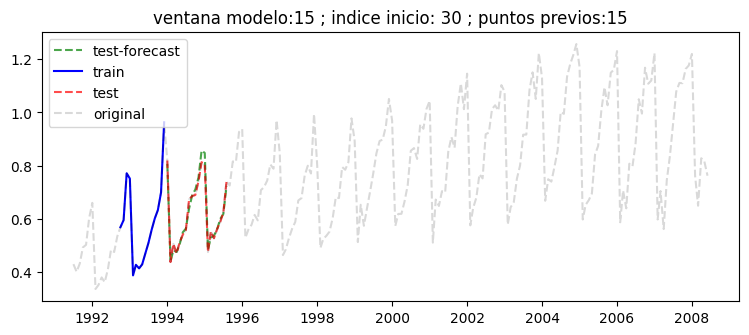

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015


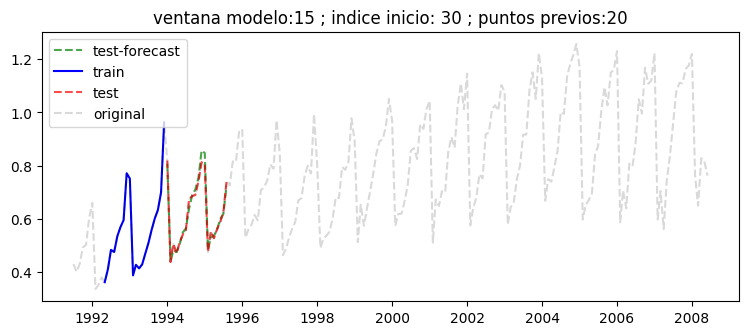

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015


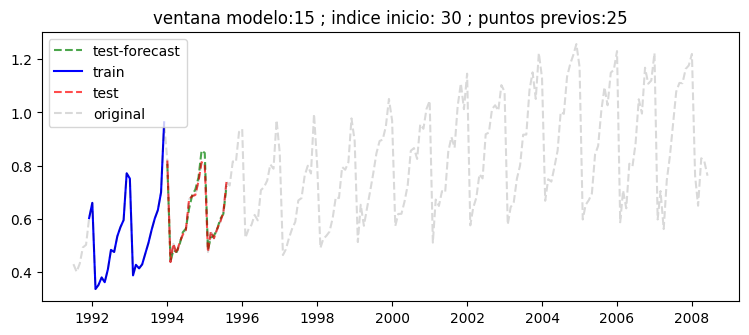

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.015
---------------------------------------------


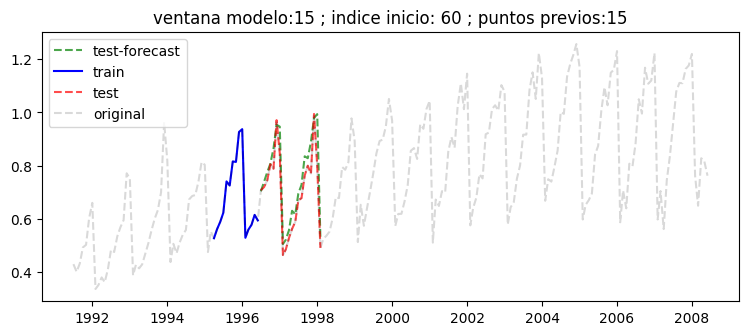

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


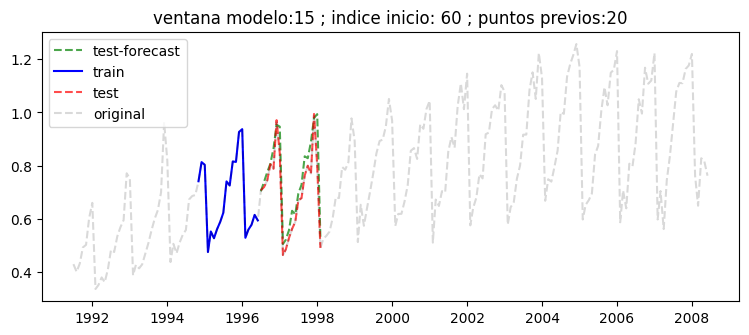

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


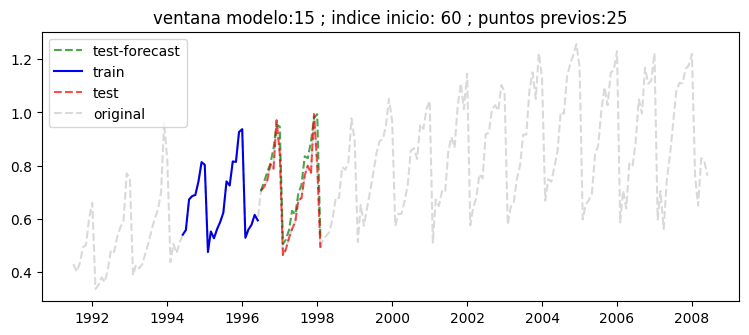

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050
---------------------------------------------


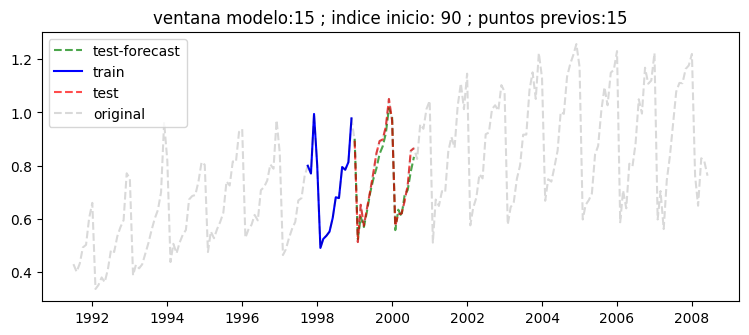

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


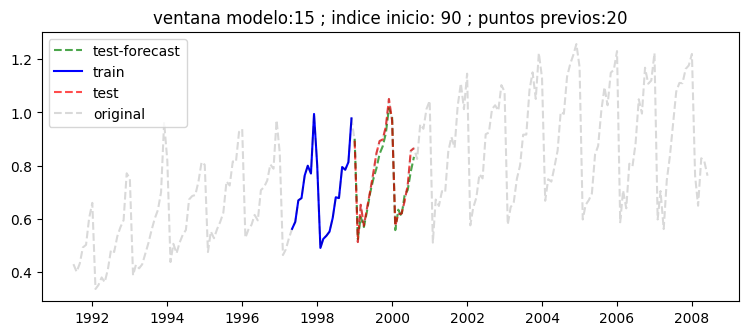

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025


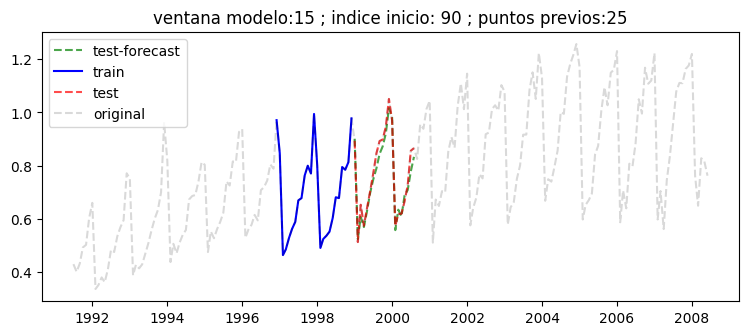

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.025
---------------------------------------------


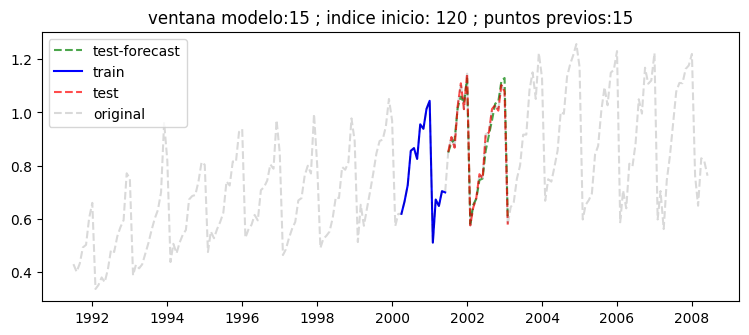

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


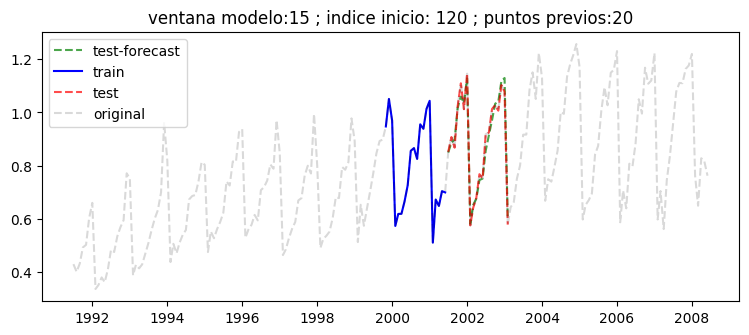

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022


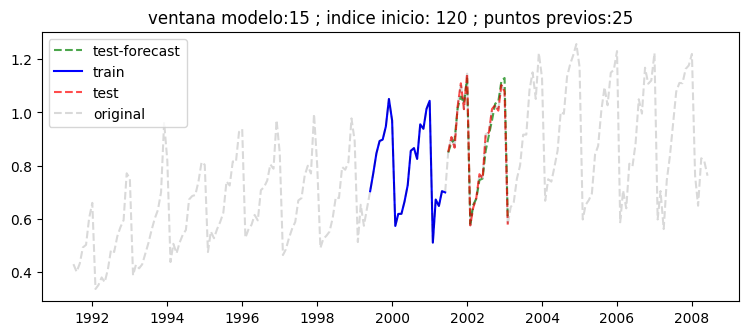

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.022
---------------------------------------------


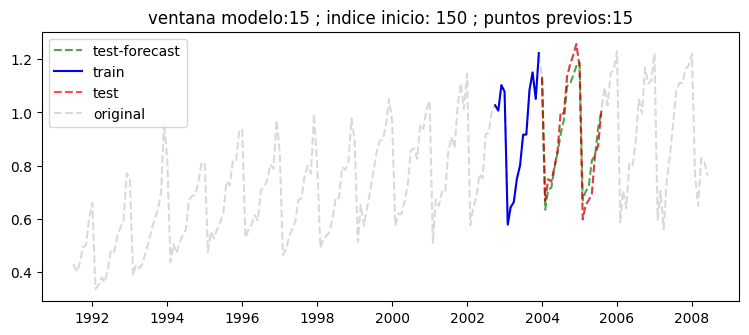

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.044


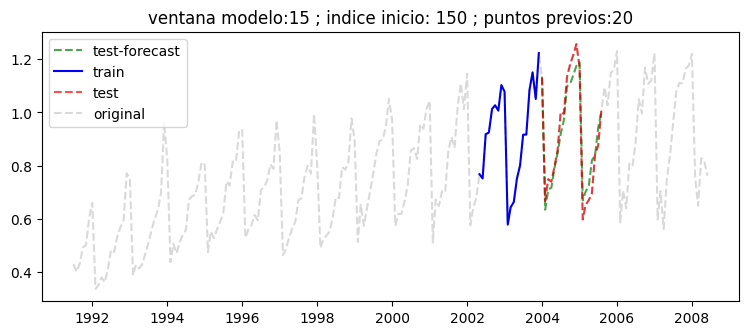

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.044


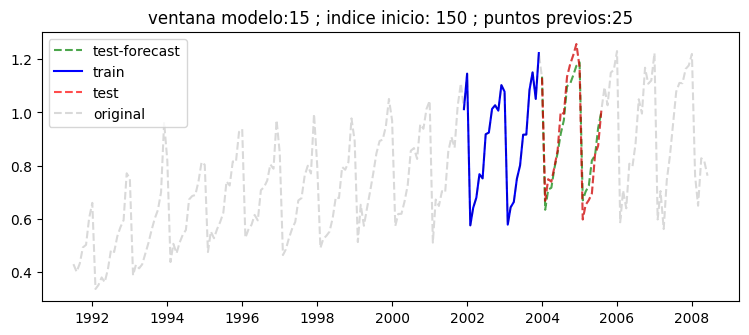

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.044
---------------------------------------------


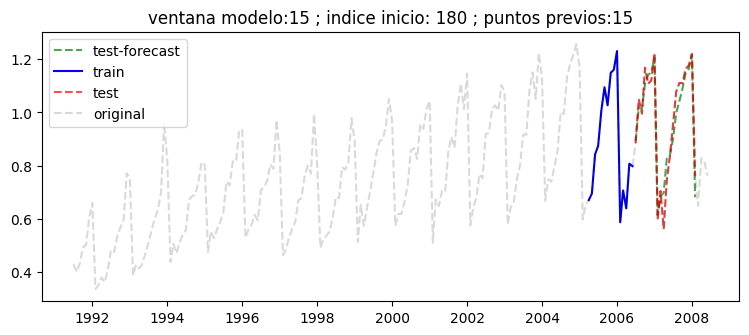

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.040


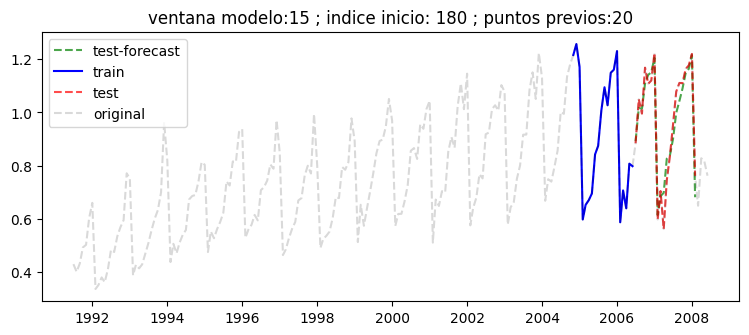

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.040


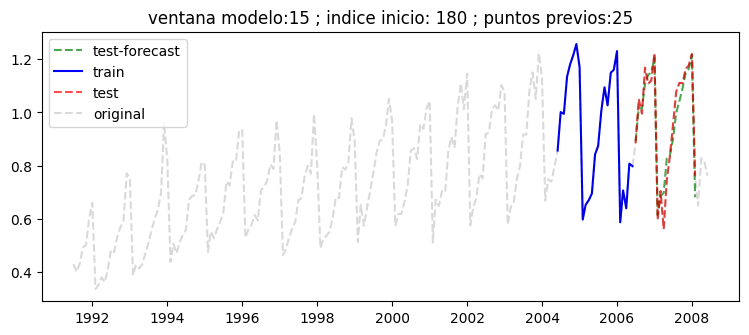

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.040


In [73]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster.max_lag,forecaster.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo - Valores Y (output) - Valores input exogenas
            df_previos = df.iloc[ii-largo:ii]["y"]
            df_exog = df[df.columns.tolist()[1:]].iloc[ii:ii+largo_test]
            
            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster.predict(steps=largo_test, last_window=df_previos, exog=df_exog)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))

            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris

            plt.title('ventana modelo:' + str(forecaster.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

# Parte 3 - Modelo simple con datos faltantes

La idea aqui es remover aleatoriamente algunos puntos de los datos con el fin de ver el efecto en la predicción.

## Manipulacion de datos en tiempo como puntos

El concepto aqui es que el modelo de forecasting no evalua segun el indice (timestamp), sino que los ve como puntos secuenciales (en orden). La diferencia es critica aqui en el sentido que los datos faltantes no son evidenciados.

In [74]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


In [75]:
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

# no considerar puntos de forma aleatoria
puntos_remueve = 70
print('Puntos a remover: ',puntos_remueve)

# copia de datos originales
train_df_orig = train_df.copy()

train_df = train_df[~train_df.index.isin(train_df.sample(puntos_remueve).index.tolist())].copy()
train_df.shape, test_df.shape

Puntos a remover:  70


((114, 1), (20, 1))

### Ejemplo con CatboostRegressor

In [76]:
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])
forecaster

ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280FA5C6400> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [0, 113] 
Training index type: RangeIndex 
Training index frequency: 1 
Regressor parameters: {'iterations': 500, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': False, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:19:07 
Last fit date: 2022-11-13 10:19:07 
Skforecast version: 0.5.1 
Python version: 3.9.13 

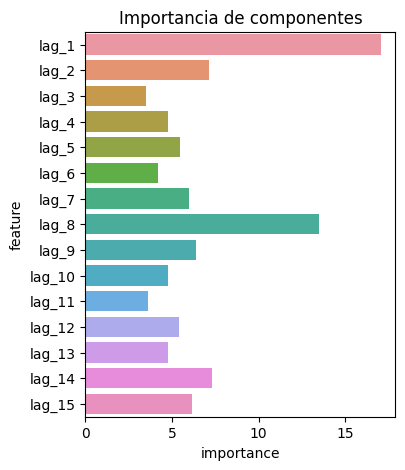

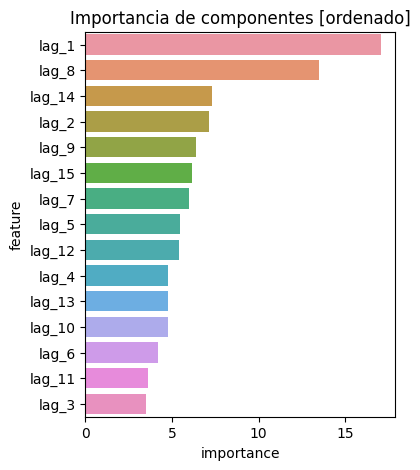

In [77]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [78]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

15    1.055158
16    1.029773
17    1.191136
18    1.003165
19    0.807739
20    0.841575
21    0.992108
22    1.007366
23    1.077699
24    1.136215
25    1.101616
26    0.952780
27    0.785019
28    0.832171
29    0.957984
30    1.064158
31    1.113785
32    1.115493
33    1.005931
34    0.803881
Name: pred, dtype: float64

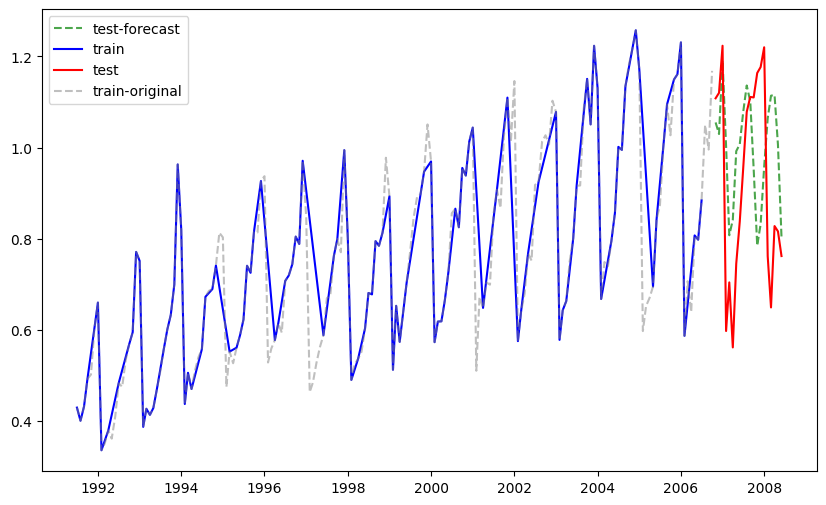

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.213


In [79]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()
v4 = train_df_orig.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.plot(v4.index,v4.values,'--',color='gray',label='train-original',alpha=0.5)
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

### Ejemplo con RandomForest

In [80]:
# Entrenar modelo - RandomForest

forecaster = ForecasterAutoreg(
    regressor = RandomForestRegressor(random_state=123),
    lags = 15)

forecaster.fit(y=train_df["y"])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [0, 113] 
Training index type: RangeIndex 
Training index frequency: 1 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
Creation date: 2022-11-13 10:19:14 
Last fit date: 2022-11-13 10:19:14 
Skforecast version: 0.5.1 
Python version: 3.9.13 

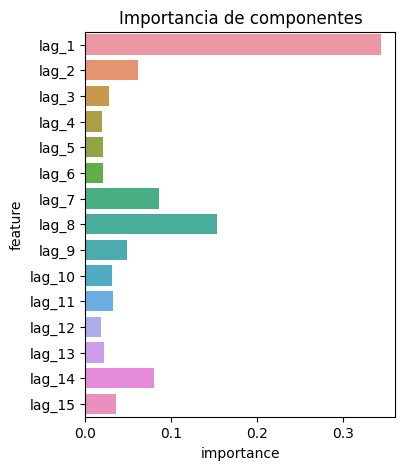

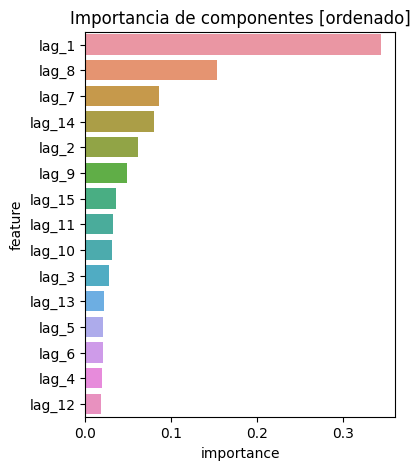

In [81]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [82]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

15    1.045439
16    1.085730
17    1.167558
18    1.013678
19    0.793513
20    0.841188
21    0.998017
22    1.030388
23    1.096855
24    1.154757
25    1.053067
26    0.948222
27    0.857023
28    0.884486
29    1.024512
30    1.080203
31    1.151161
32    1.142569
33    0.964201
34    0.897076
Name: pred, dtype: float64

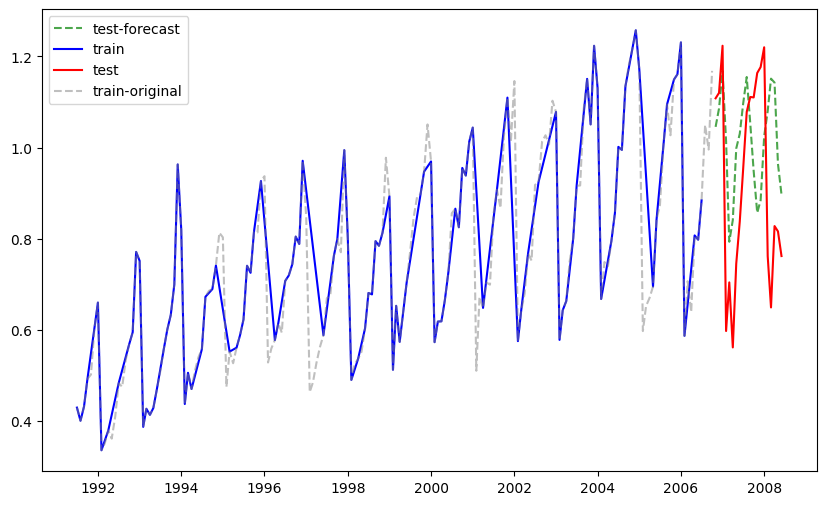

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.214


In [83]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()
v4 = train_df_orig.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.plot(v4.index,v4.values,'--',color='gray',label='train-original',alpha=0.5)
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

Se observa que en ambos modelos el rendimiento de predicción fue malo. Por lo que la extracción o falta de puntos en la serie de tiempo puede afectar significativamente el modelo de forecasting.

## Manipulacion de datos en tiempo como frecuencia (con imputacion)

Aqui es importante recalcar que mediante "asfreq" se indica la frecuencia a la cual estan espaciados los datos, por lo que aparecerán datos nulos en aquellas estampas de tiempo sin dato. El modelo tendrá problemas para evaluar ello indicando "falta de datos". Tecnicas para imputar estos datos (llenarlos) son mediante la aplicación de alguna técnica de llenado como "forward filling" o "backward filling".

In [84]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


### Metodo de imputación de datos con metodo interpolación lineal

In [89]:
# Remover datos aleatorios en Train - Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

#################################

# no considerar puntos de forma aleatoria
puntos_remueve = 70
print('Puntos a remover: ',puntos_remueve)

# copia de datos originales
train_df_orig = train_df.copy()

train_df = train_df[~train_df.index.isin(train_df.sample(puntos_remueve,random_state=123).index.tolist())].copy()

##################################

# Actualizar datos de tiempo
train_df = train_df.asfreq("MS")

# Interpolar
train_df= train_df.interpolate(method="linear",limit_direction="forward")

# ver df
train_df

Puntos a remover:  70


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.547597
...,...
2006-06-01,0.797970
2006-07-01,0.884312
2006-08-01,1.049648


Ejemplo con CatboostRegressor

In [90]:
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])
forecaster

ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280F8C1B700> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'iterations': 500, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': False, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:20:37 
Last fit date: 2022-11-13 10:20:37 
Skforecast version: 0.5.1 
Python version: 3.9.13 

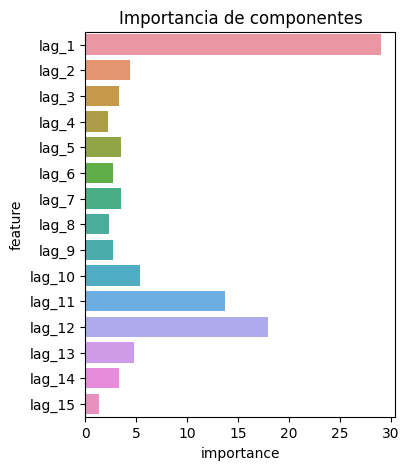

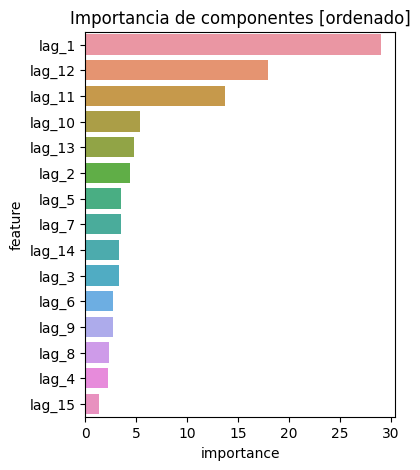

In [91]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [92]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

2006-11-01    1.166348
2006-12-01    1.180422
2007-01-01    1.146185
2007-02-01    1.045261
2007-03-01    0.867849
2007-04-01    0.753415
2007-05-01    0.745150
2007-06-01    0.803683
2007-07-01    0.895800
2007-08-01    0.999924
2007-09-01    1.015242
2007-10-01    1.073851
2007-11-01    1.118905
2007-12-01    1.156621
2008-01-01    1.184509
2008-02-01    1.082735
2008-03-01    0.915433
2008-04-01    0.771665
2008-05-01    0.753970
2008-06-01    0.789541
Freq: MS, Name: pred, dtype: float64

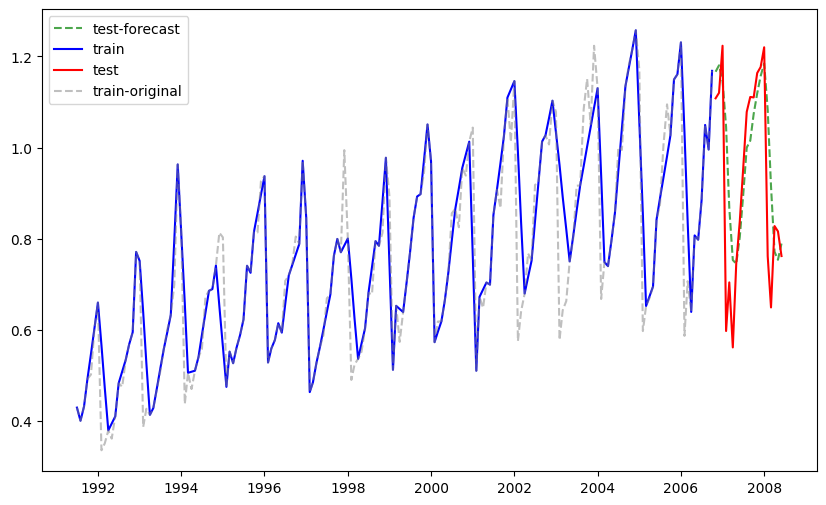

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.222


In [93]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()
v4 = train_df_orig.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.plot(v4.index,v4.values,'--',color='gray',label='train-original',alpha=0.5)
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

### Metodo de imputación de datos con metodo interpolacion polinomica

In [95]:
# Remover datos aleatorios en Train - Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

#########################

# no considerar puntos de forma aleatoria
puntos_remueve = 70
print('Puntos a remover: ',puntos_remueve)

# copia de datos originales
train_df_orig = train_df.copy()

train_df = train_df[~train_df.index.isin(train_df.sample(puntos_remueve,random_state=123).index.tolist())].copy()

#########################

# Actualizar datos de tiempo
train_df = train_df.asfreq("MS")

# Interpolar
orden_polinomio = 5
train_df= train_df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion:',orden_polinomio)

# ver df
train_df

Puntos a remover:  70
Orden polinomio interpolacion: 5


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.543665
...,...
2006-06-01,0.797970
2006-07-01,0.884312
2006-08-01,1.049648


Ejemplo con CatboostRegressor

In [96]:
# Entrenar modelo - Catboost

forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

forecaster.fit(y=train_df["y"])
forecaster

ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280F8D85430> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
Transformer for y: None 
Transformer for exog: None 
Window size: 15 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1991-07-01 00:00:00'), Timestamp('2006-10-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'iterations': 500, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': False, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:21:05 
Last fit date: 2022-11-13 10:21:05 
Skforecast version: 0.5.1 
Python version: 3.9.13 

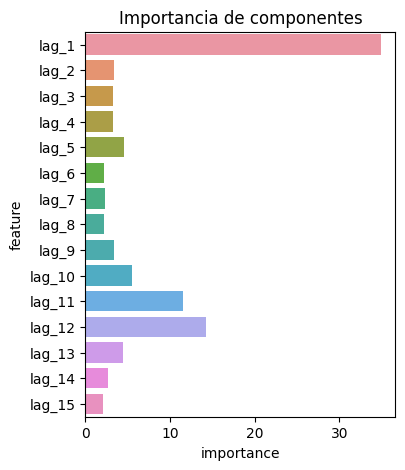

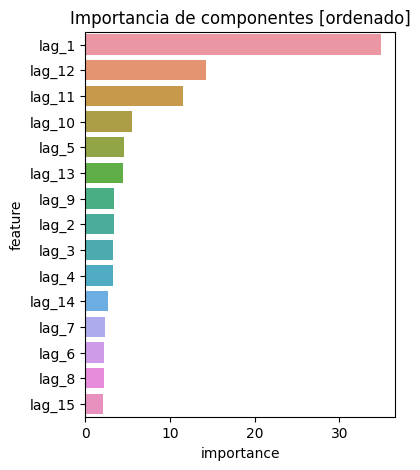

In [97]:
# Ver importancias

importancia = forecaster.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

In [98]:
# Prediccion de nuevos valores

pred_df = forecaster.predict(steps=test_df.shape[0])
pred_df

2006-11-01    1.190594
2006-12-01    1.233928
2007-01-01    1.179043
2007-02-01    1.046224
2007-03-01    0.770269
2007-04-01    0.673693
2007-05-01    0.731614
2007-06-01    0.800045
2007-07-01    0.904646
2007-08-01    1.006995
2007-09-01    1.020390
2007-10-01    1.097304
2007-11-01    1.138020
2007-12-01    1.179699
2008-01-01    1.221451
2008-02-01    1.124847
2008-03-01    0.886015
2008-04-01    0.706903
2008-05-01    0.695101
2008-06-01    0.765465
Freq: MS, Name: pred, dtype: float64

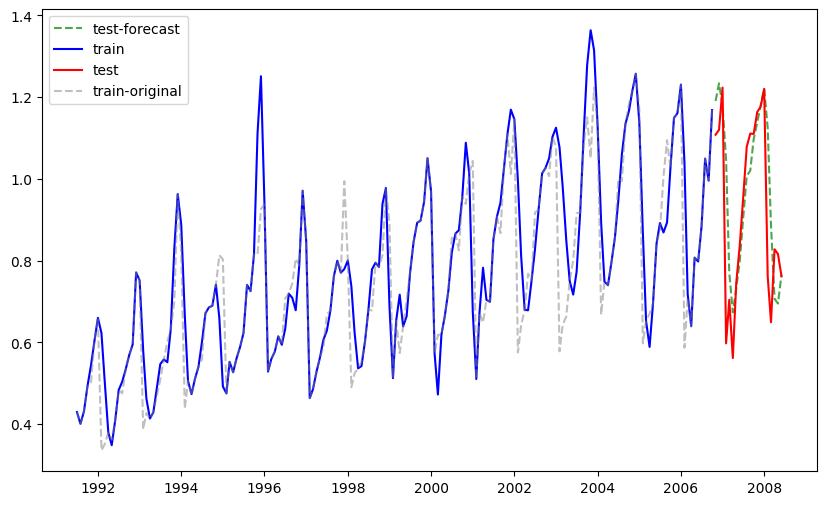

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.238


In [99]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()
v4 = train_df_orig.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.plot(v4.index,v4.values,'--',color='gray',label='train-original',alpha=0.5)
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

# Parte 5 - Busqueda de hiperparametros

In [102]:
# Datos 3 - produccion de cerveza en australia

url = "https://raw.githubusercontent.com/Mishagk/codigos-variados/main/monthly-beer-production-in-austr.csv"
df = pd.read_csv(url)

# Columna de tiempo
var_tiempo = "Month"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo],format="%Y-%m")

# Dar formato a estampa de tiempo
formato = '%Y-%m'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Monthly beer production":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

df

Cantidad registros inicio raw : 476
Cantidad registros seteo freq : 476


,y
datetime,
1956-01-01,93.2
1956-02-01,96.0
1956-03-01,95.2
1956-04-01,77.1
1956-05-01,70.9
...,...
1995-04-01,127.0
1995-05-01,151.0
1995-06-01,130.0


## 5.1. Opcion 1 - Catboost

In [104]:
# (Opcion 1) Busqueda de hiperparametros - Catboost

# Hiperparametros de estimador
param_grid = {'depth': [3,5,6,7,8,9,10],
              'l2_leaf_reg':[1.0,0.5,0.1]}

# Retrasos (lags) usados
lags_grid = [15,20,25,30]


# Definir modelo de regresion de sklearn (se usa RandomForestRegressor)
forecaster = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=500,
                  l2_leaf_reg=0.5,
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=15)

# Busqueda de hiperparametros (Cuidado: initial_train_size no puede ser igual de largo que datos "y")
results_grid = grid_search_forecaster(
       forecaster = forecaster,
       y = pd.concat([train_df["y"],test_df["y"]]),
       param_grid = param_grid,
       lags_grid = lags_grid,
       steps = 10,
       refit = True,
       metric = 'mean_absolute_error',
       initial_train_size = train_df.shape[0],
       fixed_train_size = False,
       return_best = True,
       verbose = False)

Number of models compared: 84.


loop lags_grid: 100%|██████████████████████████████████████| 4/4 [09:56<00:00, 149.08s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30] 
  Parameters: {'depth': 5, 'l2_leaf_reg': 0.5}
  Backtesting metric: 8.20657997225501



In [105]:
results_grid # opcion 1

,lags,params,mean_absolute_error,depth,l2_leaf_reg
67,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 5, 'l2_leaf_reg': 0.5}",8.206580,5.0,0.5
80,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 9, 'l2_leaf_reg': 0.1}",8.278825,9.0,0.1
54,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 8, 'l2_leaf_reg': 1.0}",8.375424,8.0,1.0
77,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 8, 'l2_leaf_reg': 0.1}",8.400176,8.0,0.1
81,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 10, 'l2_leaf_reg': 1.0}",8.447614,10.0,1.0
...,...,...,...,...,...
40,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 10, 'l2_leaf_reg': 0.5}",9.387848,10.0,0.5
30,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 7, 'l2_leaf_reg': 1.0}",9.412805,7.0,1.0
8,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 6, 'l2_leaf_reg': 0.1}",9.471028,6.0,0.1
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'depth': 6, 'l2_leaf_reg': 0.5}",9.483607,6.0,0.5


In [106]:
# Entrenar modelo segun ranking top

# seleccionar el orden de ranking, empezando de 0 (mejor) a n-1 (peor)
top_n = 0

print('Top ranking (0 es el mejor):',top_n)

forecaster_mejor = ForecasterAutoreg(
    regressor = CatBoostRegressor(random_state=123,
                  verbose=False,
                  iterations=500,
                  depth = results_grid.iloc[top_n ,:]["depth"],
                  l2_leaf_reg=results_grid.iloc[top_n ,:]["l2_leaf_reg"],
                  allow_writing_files=False,
                  early_stopping_rounds=30),
    lags=results_grid.iloc[top_n ,:]["lags"])

forecaster_mejor.fit(y=train_df["y"])
forecaster_mejor

Top ranking (0 es el mejor): 0


ForecasterAutoreg 
Regressor: <catboost.core.CatBoostRegressor object at 0x00000280F7F10DC0> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30] 
Transformer for y: None 
Transformer for exog: None 
Window size: 30 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1956-01-01 00:00:00'), Timestamp('1993-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'iterations': 500, 'depth': 5.0, 'l2_leaf_reg': 0.5, 'loss_function': 'RMSE', 'verbose': False, 'allow_writing_files': False, 'random_state': 123, 'early_stopping_rounds': 30} 
Creation date: 2022-11-13 10:36:00 
Last fit date: 2022-11-13 10:36:00 
Skforecast version: 0.5.1 
Python version: 3.9.13 

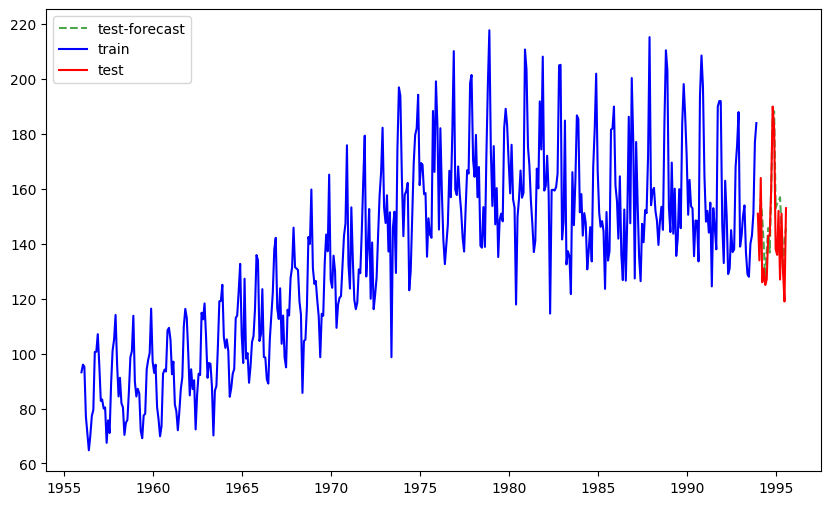

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 19.569


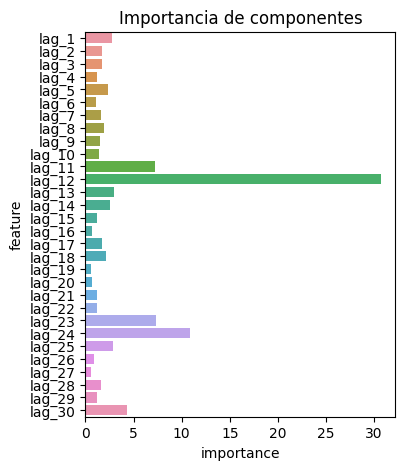

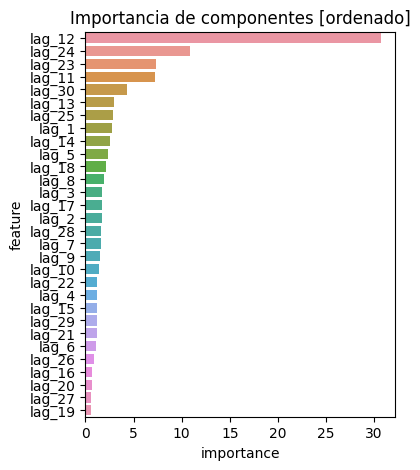

In [107]:
# Visualizar prediccion

# Prediccion de nuevos valores
pred_df = forecaster_mejor.predict(steps=test_df.shape[0])

#########################

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

############################
# Ver importancias

importancia = forecaster_mejor.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

---------------------------------------------


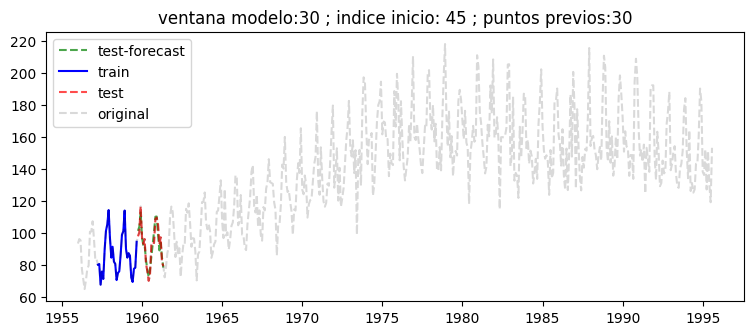

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.027


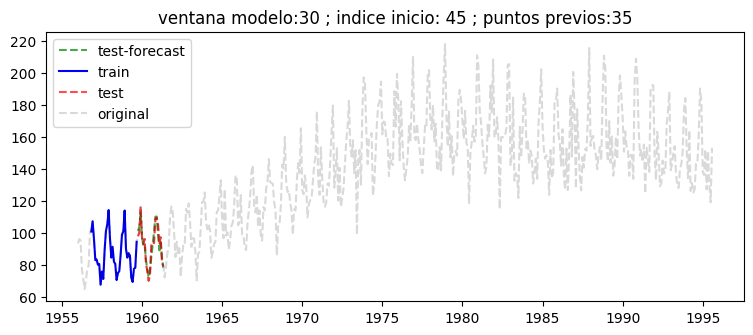

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.027


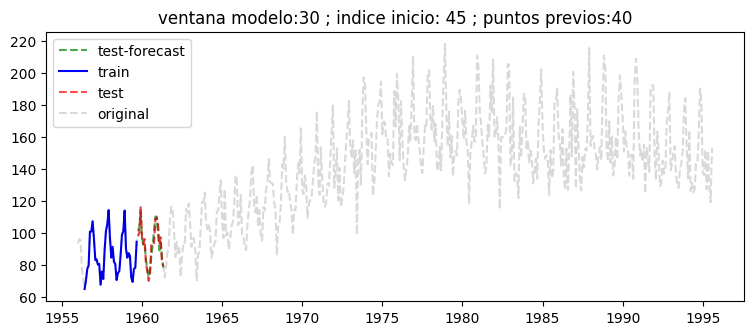

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.027
---------------------------------------------


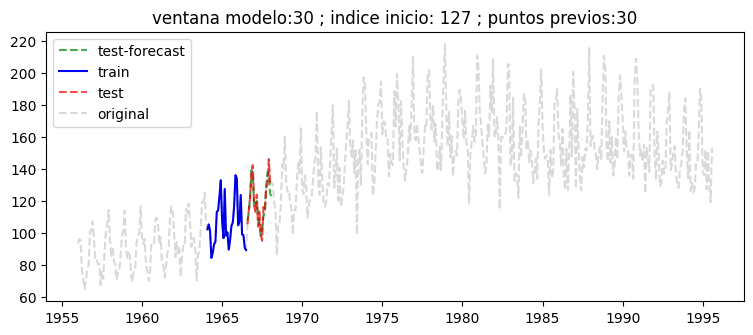

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.399


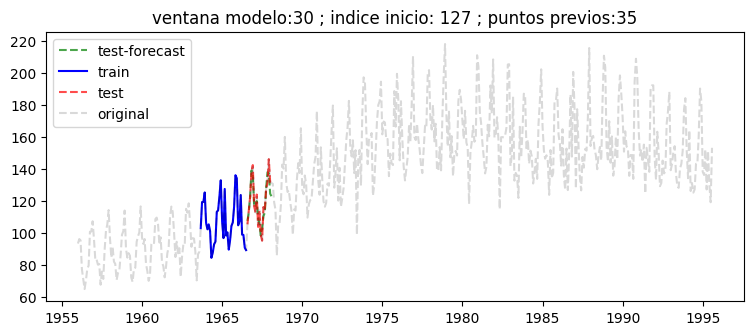

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.399


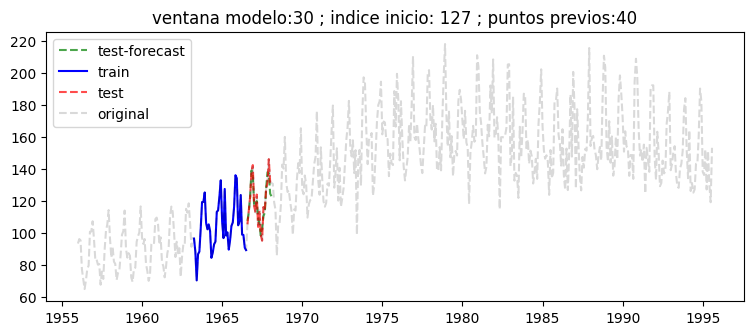

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.399
---------------------------------------------


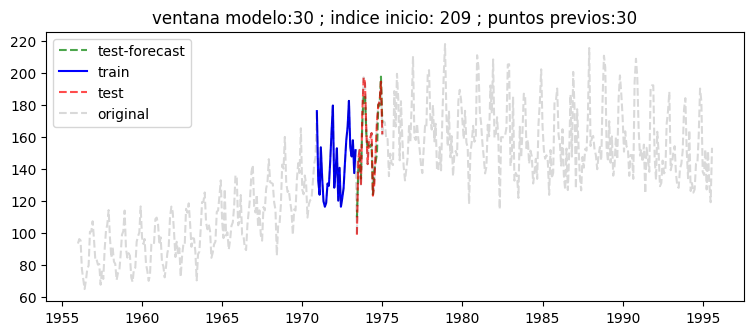

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.508


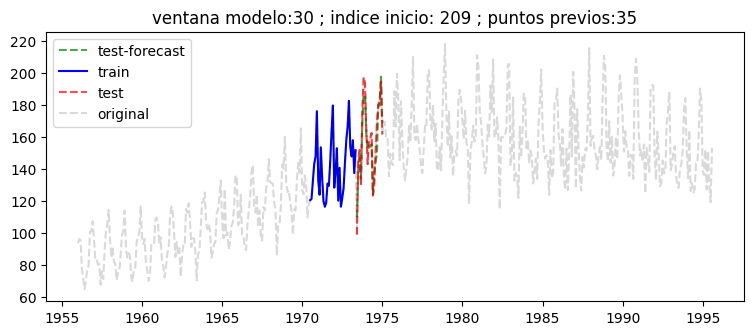

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.508


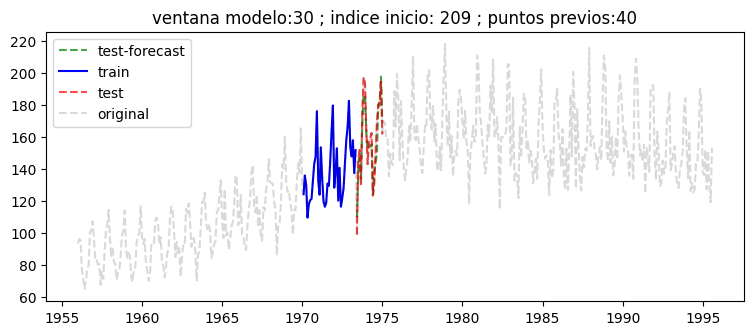

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.508
---------------------------------------------


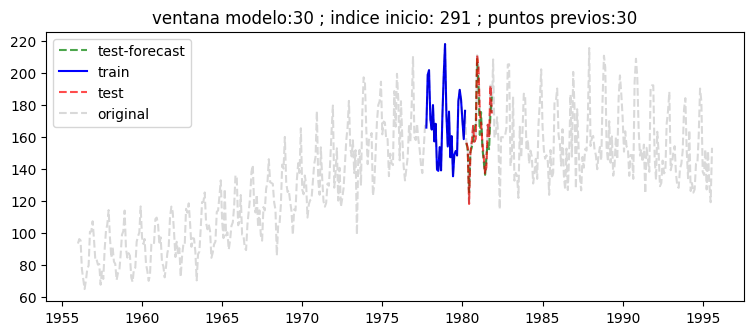

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.755


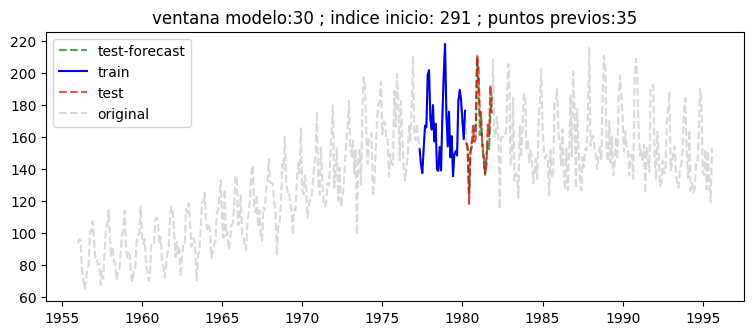

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.755


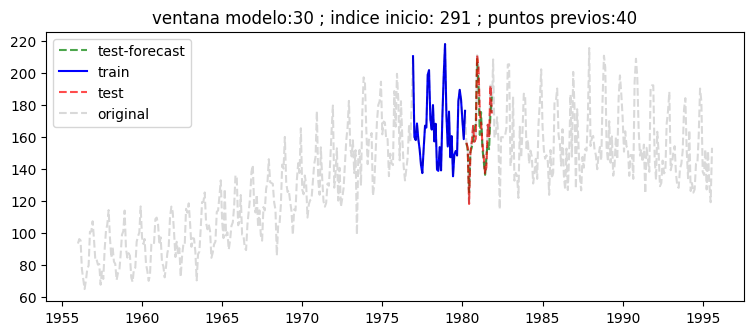

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.755
---------------------------------------------


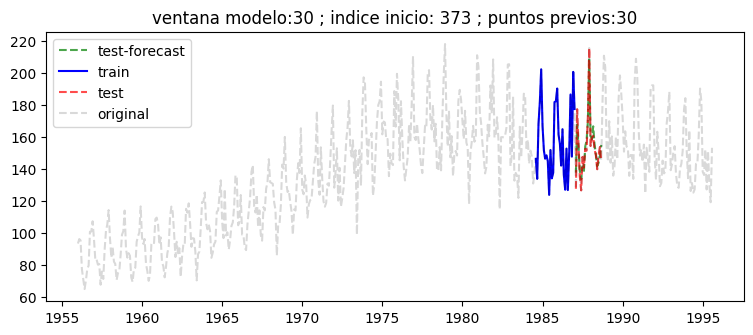

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.820


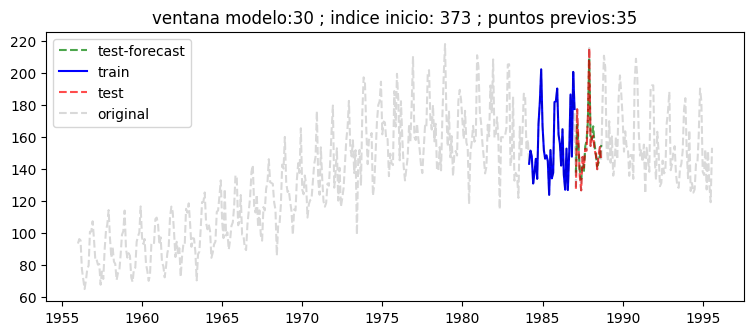

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.820


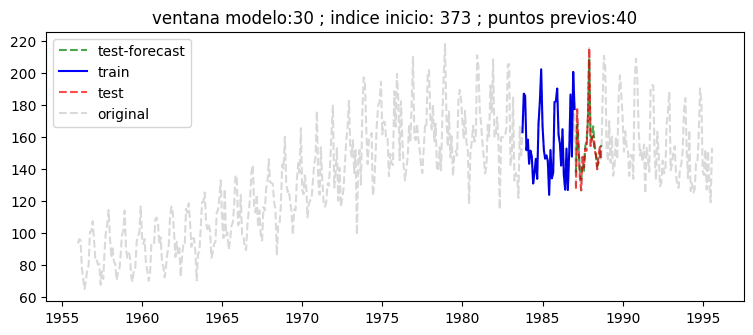

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 4.820
---------------------------------------------


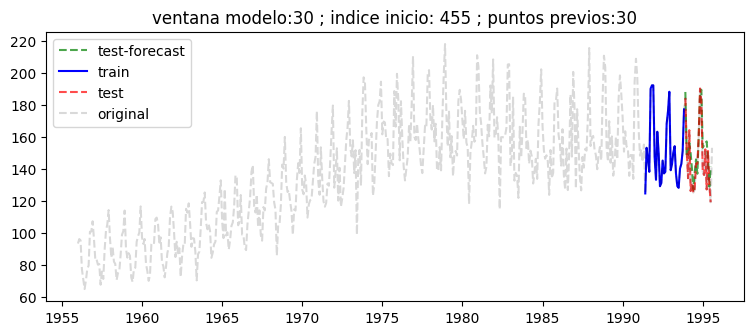

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.454


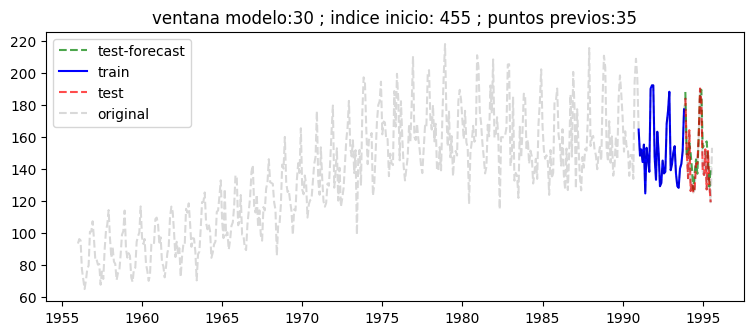

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.454


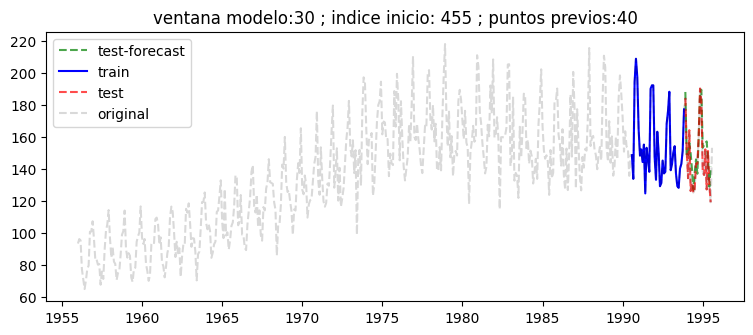

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.454


In [109]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster_mejor.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster_mejor.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster_mejor.max_lag,forecaster_mejor.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster_mejor.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster_mejor.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

## 5.2. Opcion 2 - RandomForest

In [110]:
# (Opcion 2) Busqueda de hiperparametros - RandomForest

# Hiperparametros de estimador
param_grid = {'n_estimators': [50, 100],
              'max_depth': [5, 10, 15]}

# Retrasos (lags) usados
lags_grid = [1,2,3,4,5,8,10,12,15,18,20,25,30,40]


# Definir modelo de regresion de sklearn (se usa RandomForestRegressor)
forecaster = ForecasterAutoreg(
    regressor = RandomForestRegressor(random_state=123),
    lags  = 15)

# Busqueda de hiperparametros (Cuidado: initial_train_size no puede ser igual de largo que datos "y")
results_grid = grid_search_forecaster(
       forecaster = forecaster,
       y = pd.concat([train_df["y"],test_df["y"]]),
       param_grid = param_grid,
       lags_grid = lags_grid,
       steps = 10,
       refit = True,
       metric = 'mean_absolute_error',
       initial_train_size = train_df.shape[0],
       fixed_train_size = False,
       return_best = True,
       verbose = False)

Number of models compared: 84.


loop lags_grid: 100%|█████████████████████████████████████| 14/14 [00:25<00:00,  1.82s/it]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30] 
  Parameters: {'max_depth': 10, 'n_estimators': 50}
  Backtesting metric: 8.720228140759337



In [112]:
results_grid # opcion 2

,lags,params,mean_absolute_error,max_depth,n_estimators
74,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 10, 'n_estimators': 50}",8.720228,10,50
65,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 15, 'n_estimators': 100}",8.764893,15,100
76,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 15, 'n_estimators': 50}",8.809954,15,50
54,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 5, 'n_estimators': 50}",8.813191,5,50
49,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 5, 'n_estimators': 100}",8.835203,5,100
...,...,...,...,...,...
1,[1],"{'max_depth': 5, 'n_estimators': 100}",25.056210,5,100
9,"[1, 2]","{'max_depth': 10, 'n_estimators': 100}",25.172939,10,100
17,"[1, 2, 3]","{'max_depth': 15, 'n_estimators': 100}",26.087029,15,100
4,[1],"{'max_depth': 15, 'n_estimators': 50}",29.586285,15,50


In [113]:
# Entrenar modelo segun ranking top

# seleccionar el orden de ranking, empezando de 0 (mejor) a n-1 (peor)
top_n = 0

print('Top ranking (0 es el mejor):',top_n)

forecaster_mejor = ForecasterAutoreg(
    regressor = RandomForestRegressor(
        random_state=123,
        max_depth = results_grid.iloc[top_n ,:]["max_depth"],
        n_estimators = results_grid.iloc[top_n ,:]["n_estimators"]),
    lags = results_grid.iloc[top_n ,:]["lags"])

forecaster_mejor.fit(y=train_df["y"])
forecaster_mejor

Top ranking (0 es el mejor): 0


ForecasterAutoreg 
Regressor: RandomForestRegressor(max_depth=10, n_estimators=50, random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30] 
Transformer for y: None 
Transformer for exog: None 
Window size: 30 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variables names: None 
Training range: [Timestamp('1956-01-01 00:00:00'), Timestamp('1993-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 10, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 50, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
Creation date: 2022-11-13 10:38:44 
Last fit date: 2022-11-13 10:38:44 
Skforecast ver

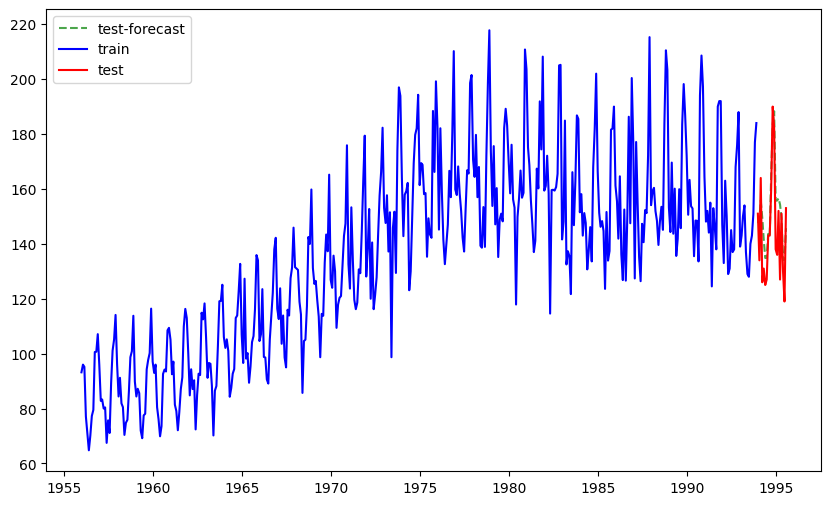

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 19.457


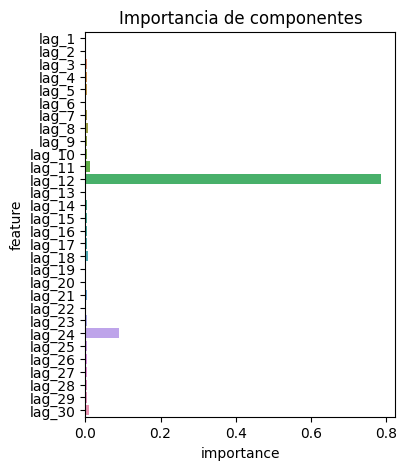

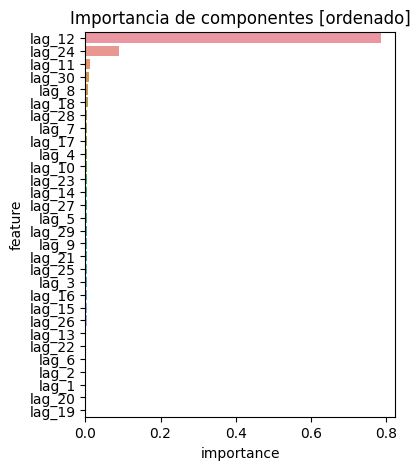

In [114]:
# Visualizar prediccion

# Prediccion de nuevos valores
pred_df = forecaster_mejor.predict(steps=test_df.shape[0])

#########################

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

############################
# Ver importancias

importancia = forecaster_mejor.get_feature_importance()

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes')
plt.show()

importancia.sort_values('importance',ascending=False,inplace=True)

plt.figure(figsize=(4,5))
sns.barplot(data=importancia,x="importance",y="feature")
plt.title('Importancia de componentes [ordenado]')
plt.show()

---------------------------------------------


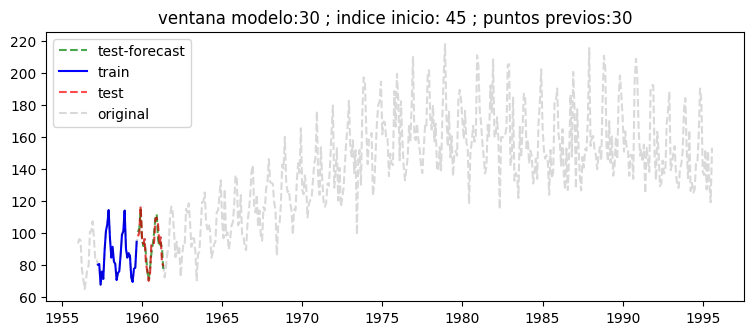

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.242


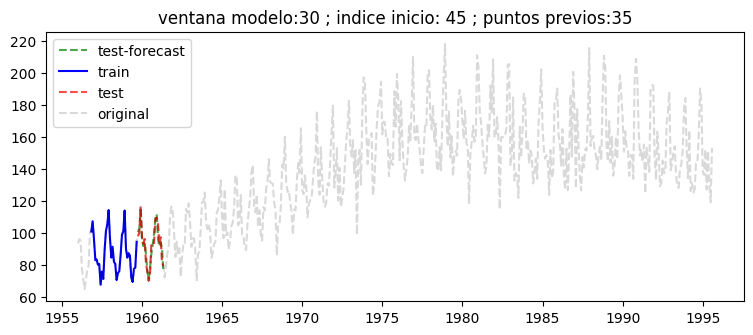

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.242


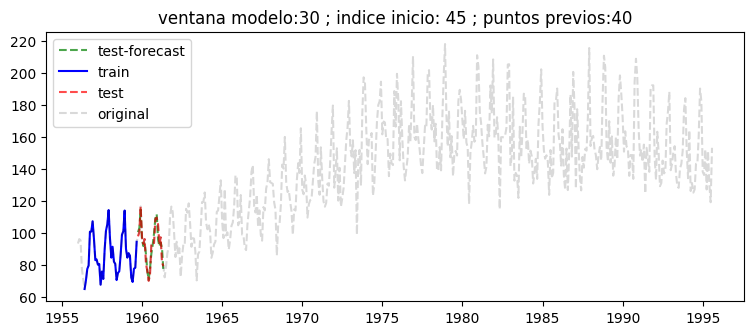

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.242
---------------------------------------------


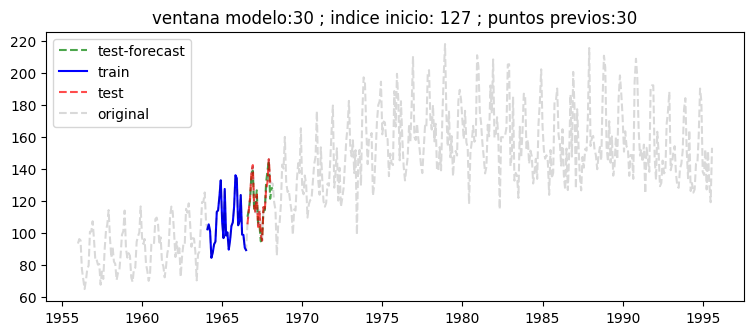

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.429


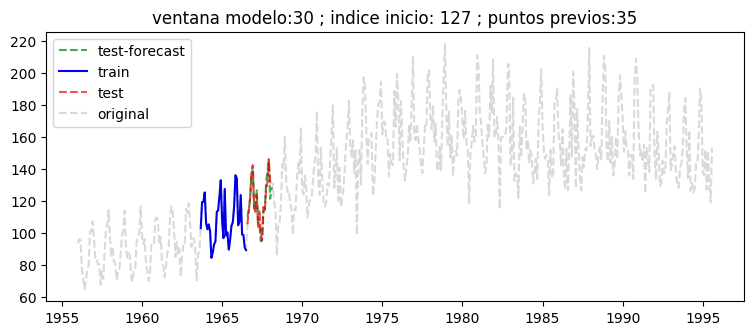

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.429


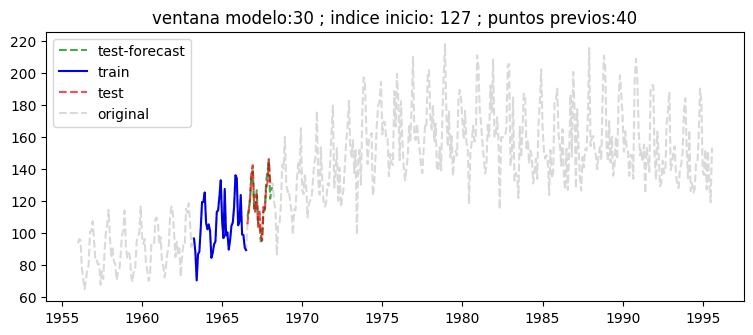

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 3.429
---------------------------------------------


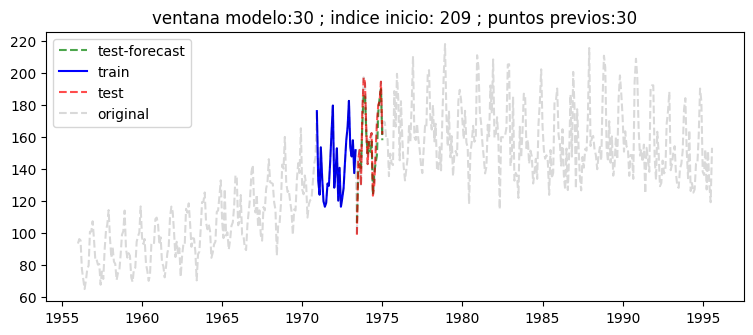

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.813


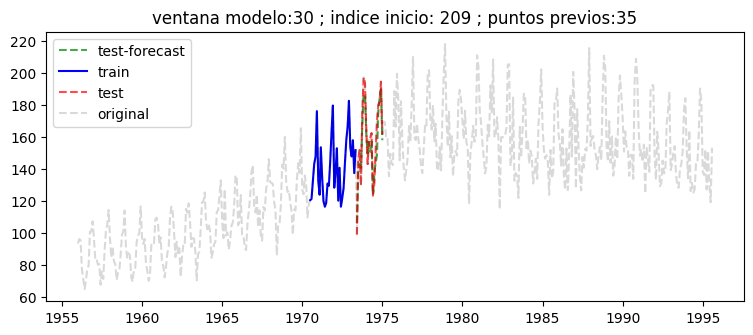

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.813


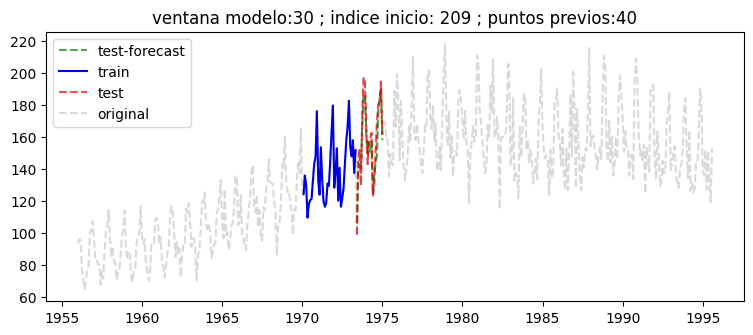

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 6.813
---------------------------------------------


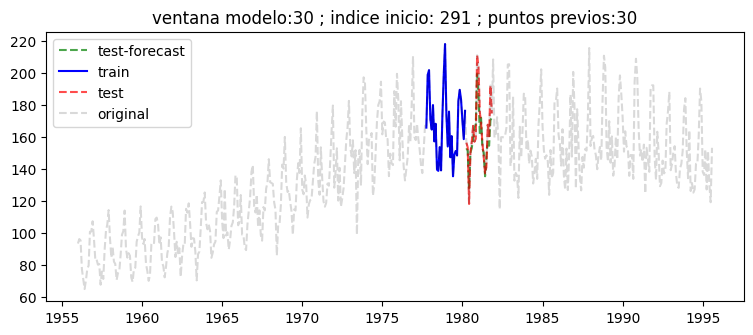

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 7.240


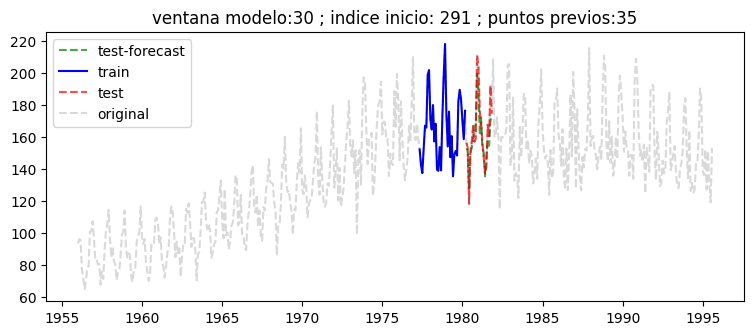

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 7.240


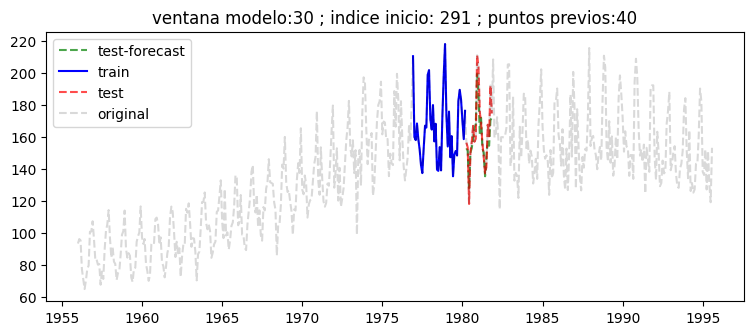

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 7.240
---------------------------------------------


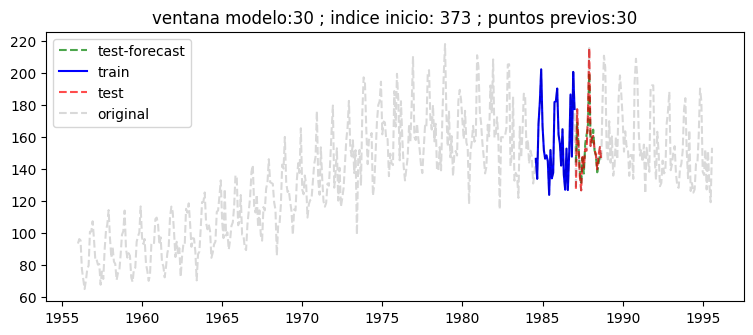

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.064


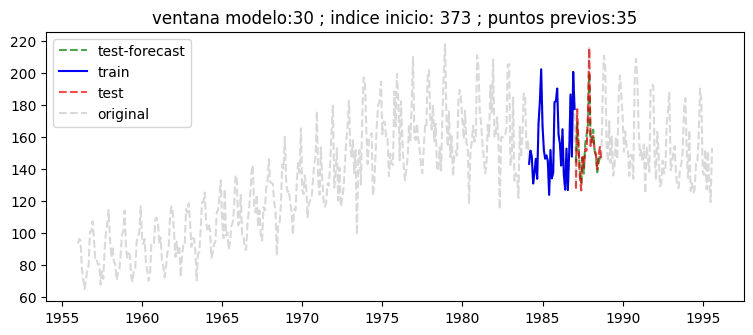

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.064


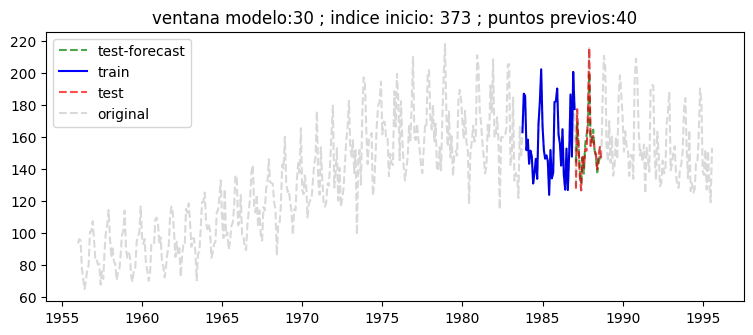

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 5.064
---------------------------------------------


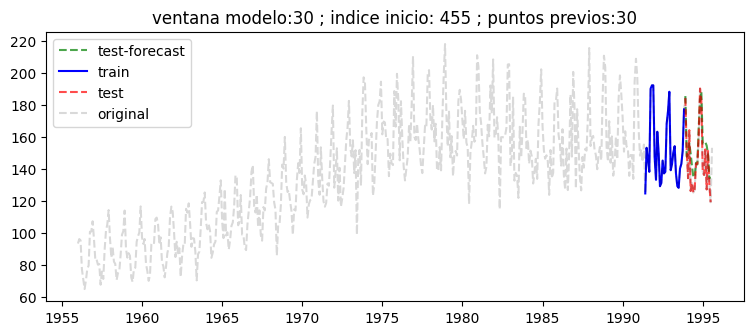

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.457


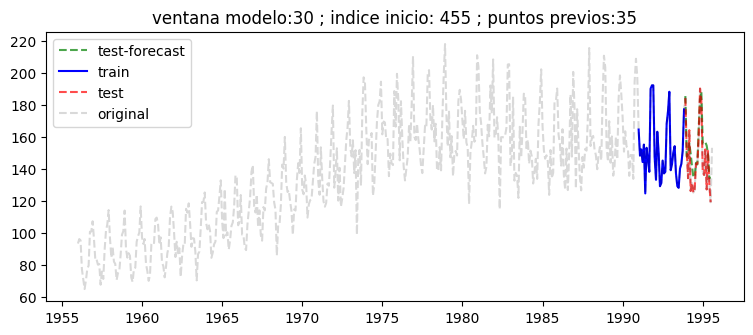

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.457


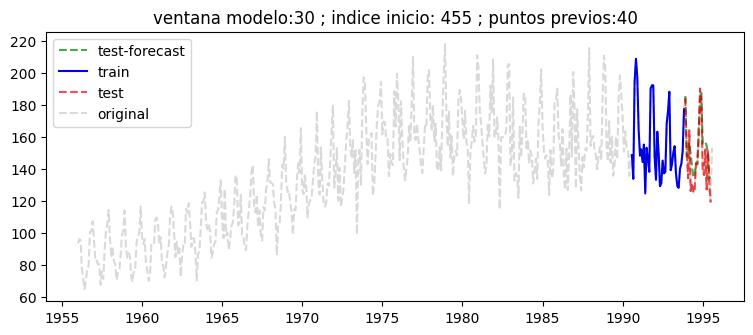

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 9.457


In [115]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana movil de puntos a predecir
for ii in range(max_lag+forecaster_mejor.max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-forecaster_mejor.max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(forecaster_mejor.max_lag,forecaster_mejor.max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]

            #forecaster.predict(steps=largo_test,last_window=df_previos)
            pred_df_new = forecaster_mejor.predict(steps=largo_test,last_window=df_previos)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(forecaster_mejor.max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

Observamos que mediante la busqueda de hiperparametros logramos un mejor rendimiento en el Test

# Parte 6 - Modelos ARIMA/SARIMA/SARIMAX

In [37]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


In [38]:
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

train_df.shape, test_df.shape

((184, 1), (20, 1))

Descomposición segun modelo aditivo


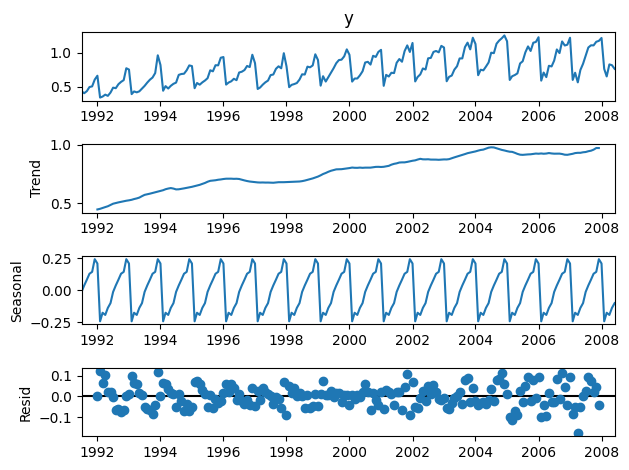

In [5]:
# [modelo Aditivo] Descomposicion de señal

from statsmodels.tsa.seasonal import seasonal_decompose

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

Descomposición segun modelo multiplicativo


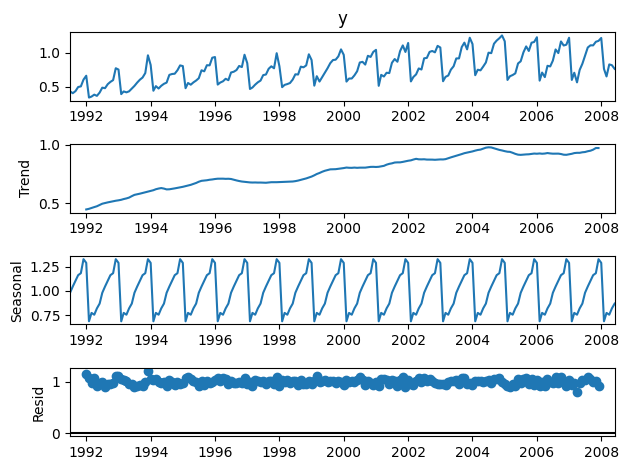

In [6]:
# [modelo Multiplicativo] Descomposicion de señal

from statsmodels.tsa.seasonal import seasonal_decompose

decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

In [40]:
# Busqueda de parametros modelo SARIMAX

from skforecast.model_selection_statsmodels import grid_search_sarimax

param_grid = {
    'order': [(14,0,0),(14,1,0),(16,0,0),(16,1,0),(18,0,0),(18,1,0)],
    'seasonal_order': [(0, 0, 0, 0)],
    'trend': [None, 'n', 'c','t','ct']
}

############################

steps_predict = test_df.shape[0]
results_grid = grid_search_sarimax(
                y = df["y"],
                param_grid = param_grid,
                initial_train_size = train_df.shape[0],
                fixed_train_size = False,
                steps = steps_predict,
                metric = 'mean_absolute_error',
                refit = False,
                verbose = False,
                fit_kwargs = {'maxiter': 700, 'disp': 0}
               )

print(results_grid.to_markdown(tablefmt="github", index=False))

root       INFO  Number of models compared: 30
100%|█████████████████████████████████████████████████████| 30/30 [02:39<00:00,  5.31s/it]

| params                                                               |    metric | order      | seasonal_order   | trend   |
|----------------------------------------------------------------------|-----------|------------|------------------|---------|
| {'order': (14, 1, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': None} | 0.0533385 | (14, 1, 0) | (0, 0, 0, 0)     |         |
| {'order': (14, 1, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'n'}  | 0.0533385 | (14, 1, 0) | (0, 0, 0, 0)     | n       |
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'c'}  | 0.0533561 | (18, 0, 0) | (0, 0, 0, 0)     | c       |
| {'order': (16, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'c'}  | 0.0535277 | (16, 0, 0) | (0, 0, 0, 0)     | c       |
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': None} | 0.0539989 | (18, 0, 0) | (0, 0, 0, 0)     |         |
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'n'}  | 0.0539989 | (18, 0, 0) | (0, 0, 0, 0) 

Informacion sobre SARIMAX de statsmodel: https://www.statsmodels.org/stable/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html#statsmodels.tsa.statespace.sarimax.SARIMAX

In [41]:
# Mejores parametros
results_grid.iloc[0].params

{'order': (14, 1, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': None}

In [42]:
# Entrenar modelo SARIMAX con parametros

import statsmodels.api as sm

# Definir y entrenar modelo segun mejores parametros encontrados (GridSearch)
modelo_base = sm.tsa.SARIMAX(endog = train_df["y"],
                             exog = None,
                             simple_differencing=False,
                             time_varying_regression=False,
                             **results_grid.iloc[0].params)

# Ajustar modelo
modelo = modelo_base.fit()

# Resumen
print(modelo.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  184
Model:              SARIMAX(14, 1, 0)   Log Likelihood                 263.061
Date:                Thu, 17 Nov 2022   AIC                           -496.122
Time:                        08:53:44   BIC                           -447.980
Sample:                    07-01-1991   HQIC                          -476.608
                         - 10-01-2006                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7546      0.078     -9.661      0.000      -0.908      -0.601
ar.L2         -0.3138      0.091     -3.433      0.001      -0.493      -0.135
ar.L3         -0.0365      0.074     -0.496      0.6

In [ ]:
# [INGRESO MANUAL] Entrenar modelo SARIMAX con parametros

import statsmodels.api as sm

order=(18, 0, 0)
seasonal_order=(0, 0, 0, 0)
trend='c'

# Definir y entrenar modelo segun mejores parametros encontrados (GridSearch)
modelo_base = sm.tsa.SARIMAX(endog = train_df["y"],
                             exog = None,
                             simple_differencing=False,
                             time_varying_regression=False,
                             order=order,
                             seasonal_order=seasonal_order,
                             trend = trend)

# Ajustar modelo
modelo = modelo_base.fit()

# Resumen
print(modelo.summary())

Evaluar modelo entrenado

In [43]:
# Prediccion de valores con SARIMAX entrenado

int_conf = 0.95 
print('Intervalo de confianza de:',np.round(100.*int_conf,1),'%')

pred_detalle = modelo.get_forecast(steps=test_df.shape[0],conf_int=int_conf)
print(pred_detalle.summary_frame())

Intervalo de confianza de: 95.0 %
y               mean   mean_se  mean_ci_lower  mean_ci_upper
2006-11-01  1.128604  0.053977       1.022812       1.234397
2006-12-01  1.202038  0.055578       1.093107       1.310970
2007-01-01  1.227566  0.061809       1.106422       1.348709
2007-02-01  0.648397  0.067626       0.515852       0.780942
2007-03-01  0.719518  0.071304       0.579765       0.859271
2007-04-01  0.675668  0.075772       0.527158       0.824177
2007-05-01  0.839046  0.079542       0.683146       0.994946
2007-06-01  0.827408  0.082927       0.664875       0.989942
2007-07-01  0.925455  0.086169       0.756566       1.094343
2007-08-01  1.060987  0.089638       0.885300       1.236674
2007-09-01  1.042177  0.092154       0.861559       1.222796
2007-10-01  1.190889  0.095959       1.002813       1.378966
2007-11-01  1.147700  0.119618       0.913253       1.382148
2007-12-01  1.237087  0.125647       0.990823       1.483350
2008-01-01  1.211935  0.134716       0.947898      

In [44]:
# [Con forecast()] Prediccion de datos test

pred_df = modelo.forecast(steps=test_df.shape[0])
pred_df

2006-11-01    1.128604
2006-12-01    1.202038
2007-01-01    1.227566
2007-02-01    0.648397
2007-03-01    0.719518
2007-04-01    0.675668
2007-05-01    0.839046
2007-06-01    0.827408
2007-07-01    0.925455
2007-08-01    1.060987
2007-09-01    1.042177
2007-10-01    1.190889
2007-11-01    1.147700
2007-12-01    1.237087
2008-01-01    1.211935
2008-02-01    0.709139
2008-03-01    0.728181
2008-04-01    0.706886
2008-05-01    0.865569
2008-06-01    0.854930
Freq: MS, Name: predicted_mean, dtype: float64

In [45]:
# [Con predict()] Prediccion de datos test

pred_df = modelo.predict(start=test_df.index[0],end=test_df.index[-1])
pred_df

2006-11-01    1.128604
2006-12-01    1.202038
2007-01-01    1.227566
2007-02-01    0.648397
2007-03-01    0.719518
2007-04-01    0.675668
2007-05-01    0.839046
2007-06-01    0.827408
2007-07-01    0.925455
2007-08-01    1.060987
2007-09-01    1.042177
2007-10-01    1.190889
2007-11-01    1.147700
2007-12-01    1.237087
2008-01-01    1.211935
2008-02-01    0.709139
2008-03-01    0.728181
2008-04-01    0.706886
2008-05-01    0.865569
2008-06-01    0.854930
Freq: MS, Name: predicted_mean, dtype: float64

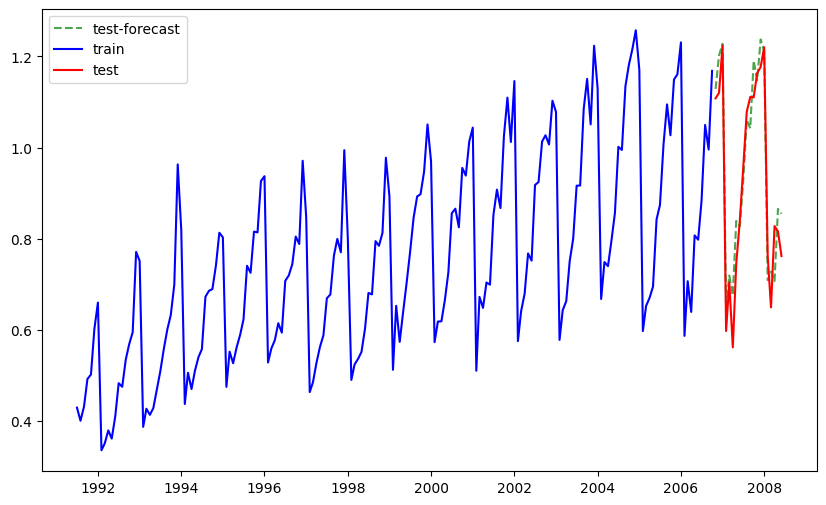

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.244


In [46]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1.values,'-b',label='train')
plt.plot(v2.index,v2.values,'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

---------------------------------------------


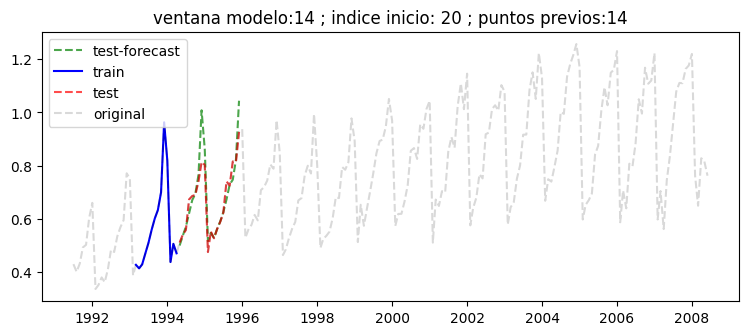

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.035


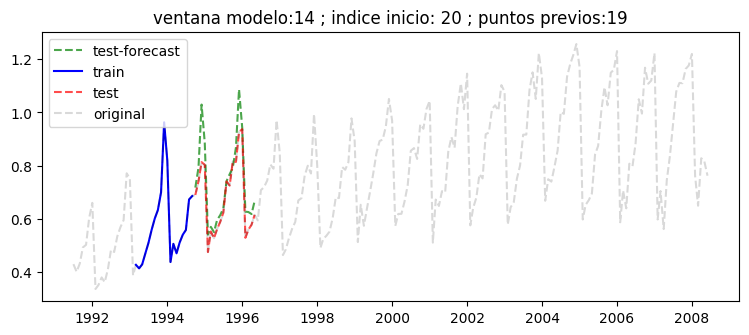

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.055


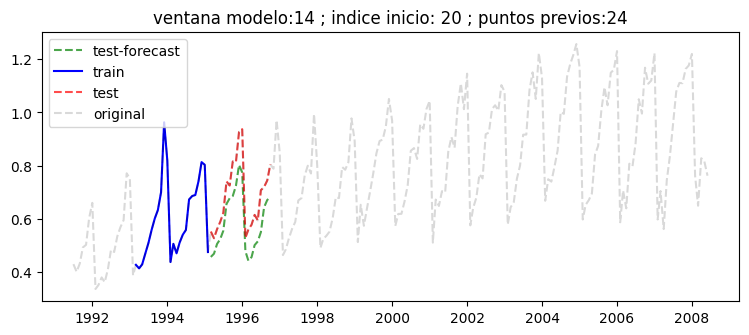

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.095
---------------------------------------------


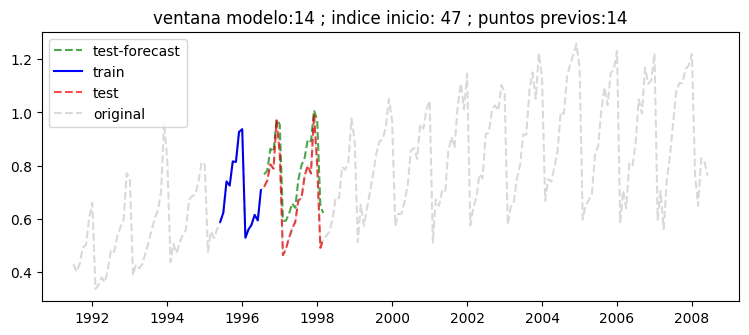

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.086


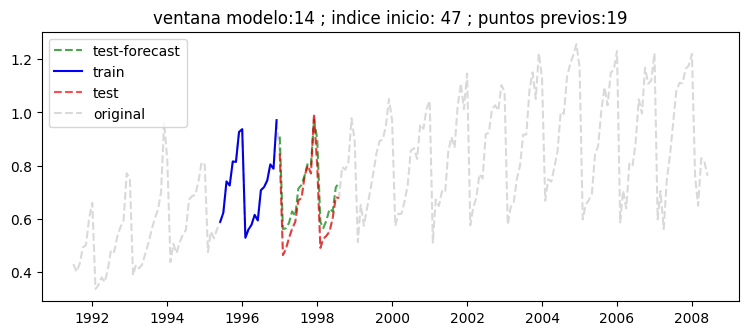

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.052


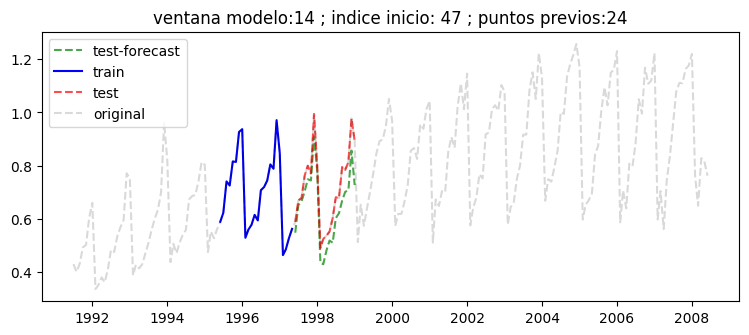

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.069
---------------------------------------------


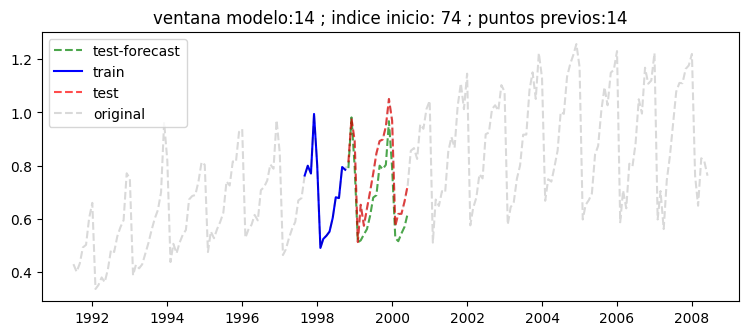

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.087


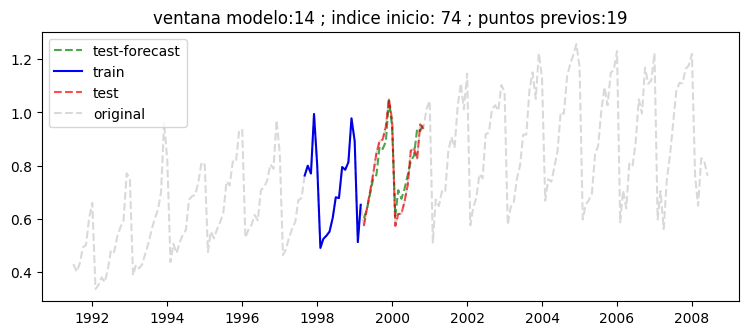

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.039


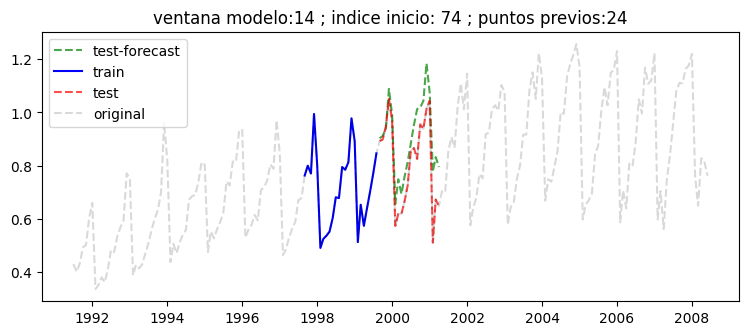

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.090
---------------------------------------------


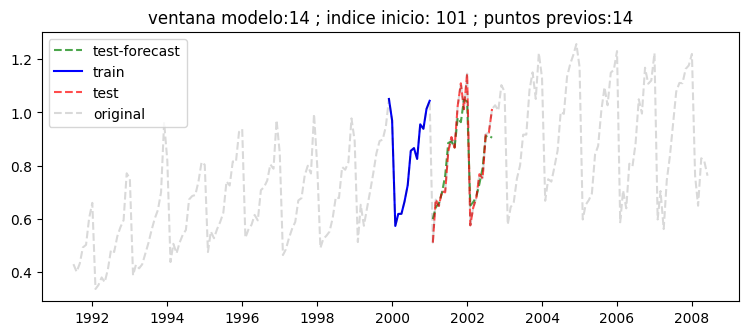

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.044


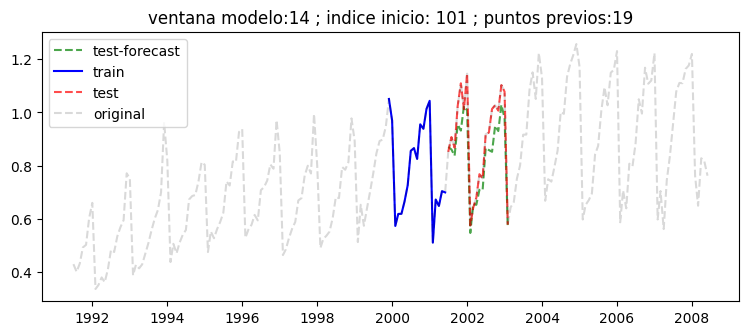

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.064


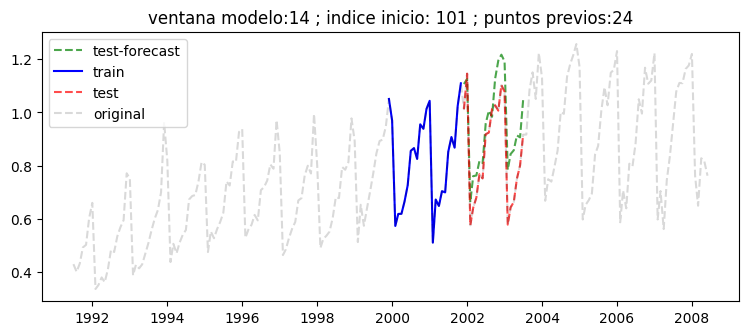

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.109
---------------------------------------------


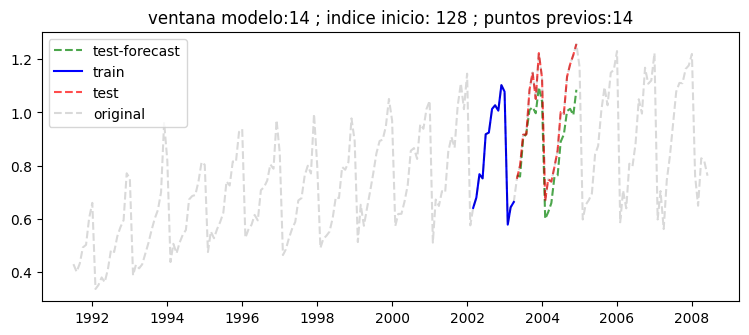

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.092


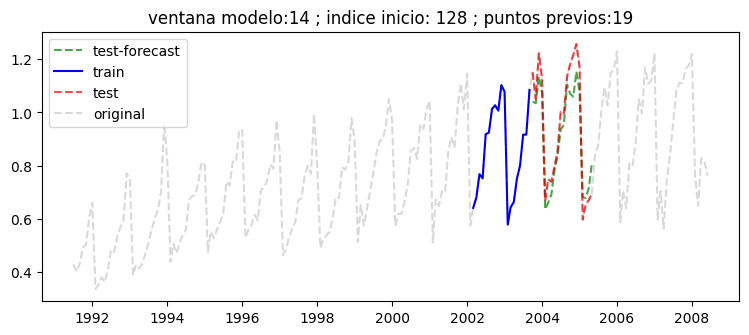

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.067


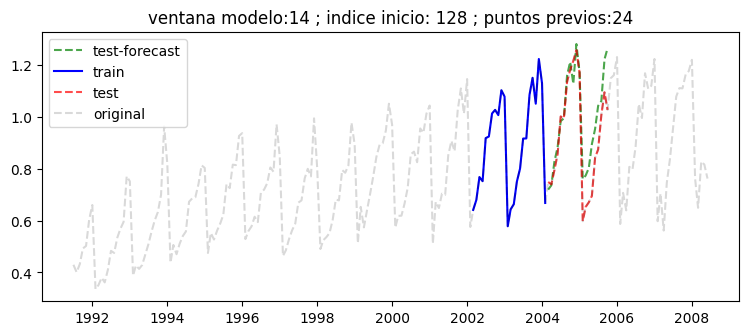

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.080


In [47]:
# (Opcion 1) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana mas grande
modelo_max_lag = np.max([modelo.model_orders["ar"],modelo.model_orders["ma"]])

# Ventana movil de puntos a predecir
for ii in range(largo_test,df.shape[0]-largo_test-max_lag-modelo_max_lag,int((df.shape[0]-2*largo_test-max_lag-modelo_max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(modelo_max_lag,modelo_max_lag + max_lag,paso_lags):

        # extraer datos input al modelo
        df_previos = df.iloc[ii:ii+largo]["y"]
        
        # Prediccion de valores
        start_time = df.iloc[ii:ii+largo+1].index[-1]
        end_time = df.iloc[ii:ii+largo+largo_test].index[-1]
        pred_df_new = modelo.predict(start=start_time,end=end_time,dynamic=True)
        
        ##############################

        # Visualizar prediccion
        v1 = df_previos.copy()
        v2 = df.iloc[ii+largo:ii+largo+largo_test]["y"].copy()
        v3 = pred_df_new.copy()

        # definir figura
        plt.figure(figsize=(9,3.5))

        plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
        plt.plot(v1.index,v1.values,'-b',label='train')
        plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
        plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original')  # señal original completa en gris

        plt.title('ventana modelo:' + str(modelo_max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
        plt.legend()
        plt.show()

        ######################################
        # Evaluar el rendimiento del modelo

        # MAE: Valor de error absoluto promedio
        def mae(y_hat, y_true):
            return np.mean(np.abs(y_hat-y_true))

        # MAPE: Valor de error porcentual absoluto promedio
        def mape(y_hat, y_true):
            return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

        print(' *** Resultados en el horizonte (Test) *** ')
        print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))


---------------------------------------------


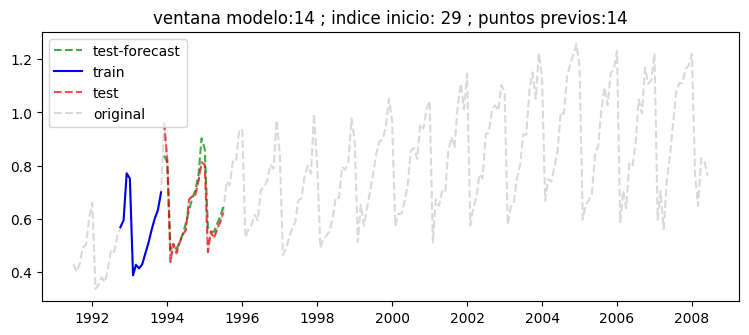

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.033


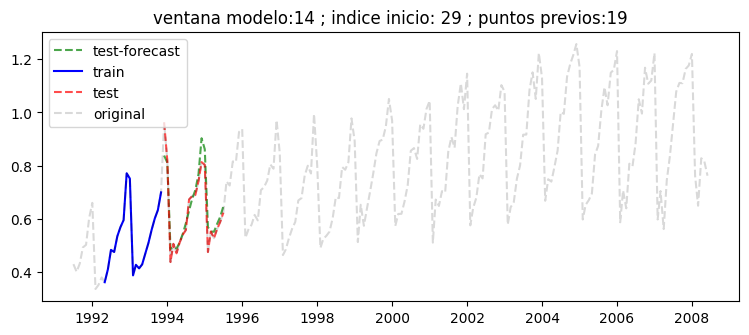

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.033


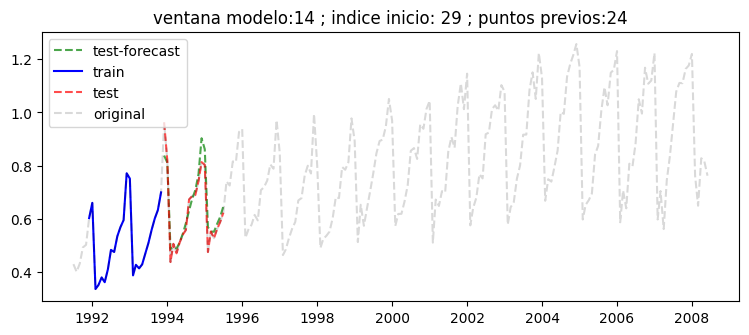

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.033
---------------------------------------------


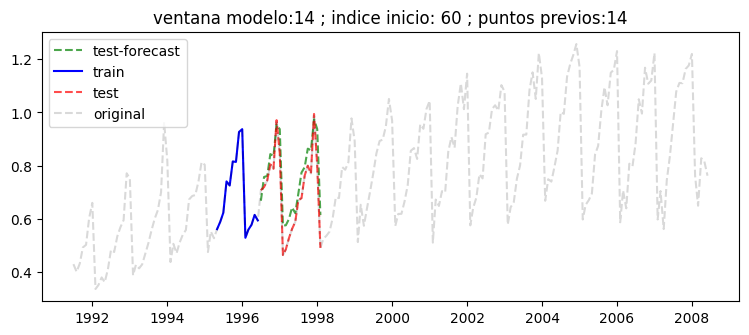

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.063


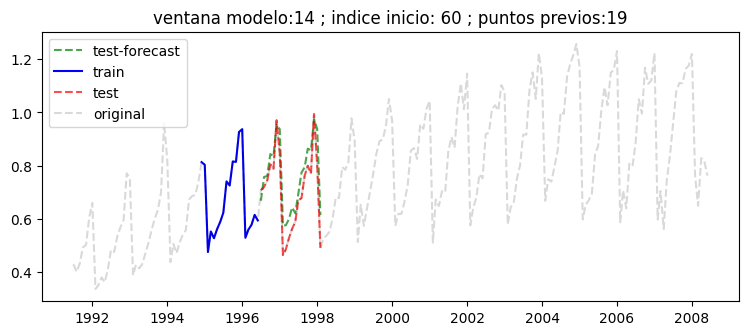

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.063


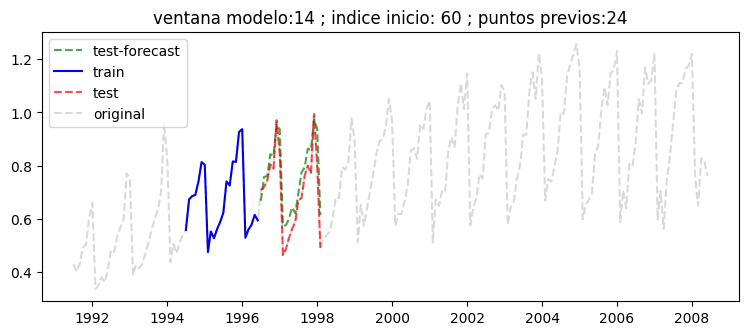

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.063
---------------------------------------------


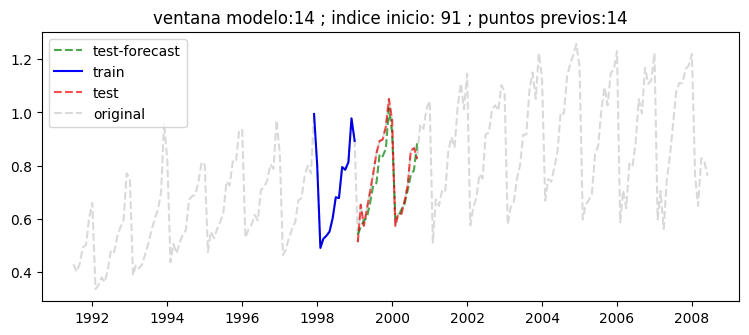

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.048


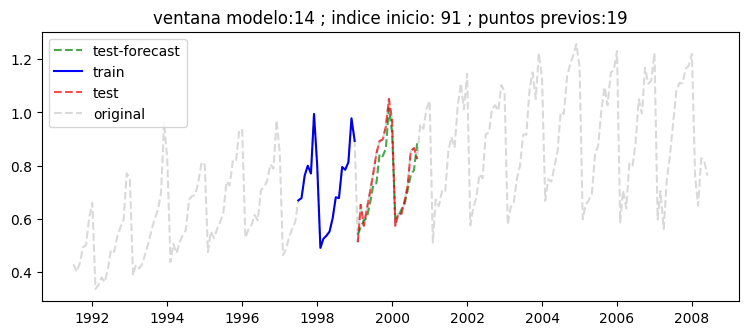

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.048


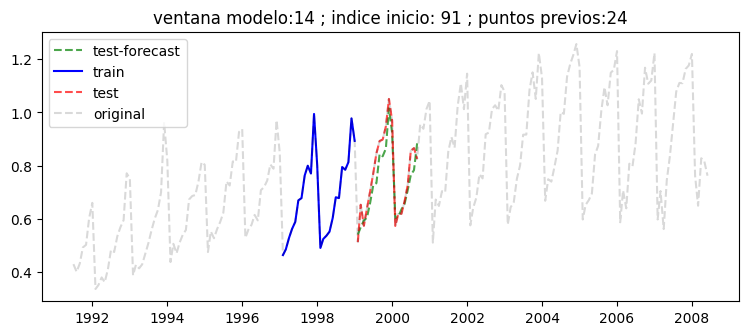

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.048
---------------------------------------------


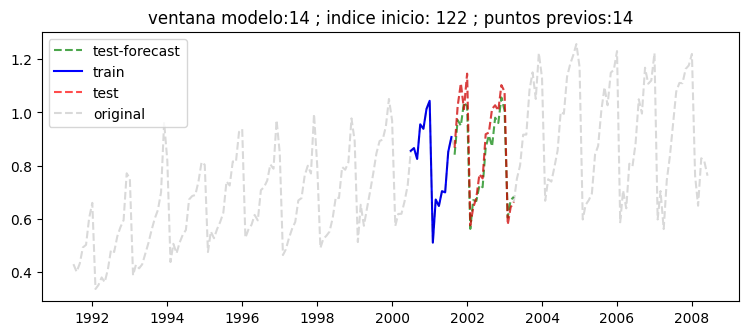

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


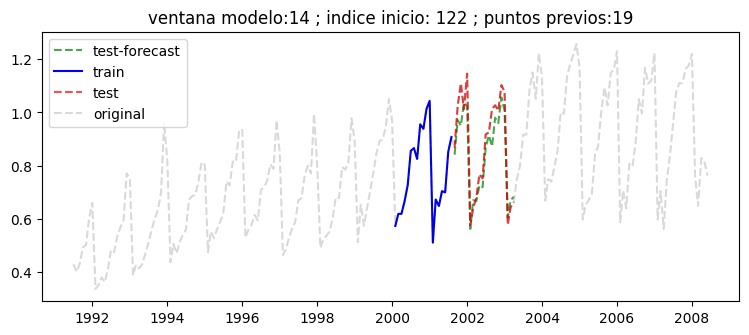

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


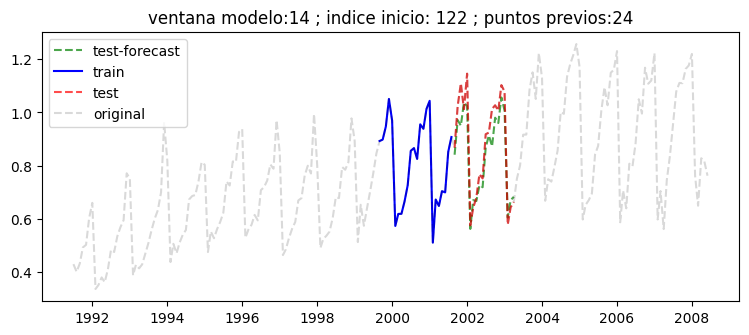

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050
---------------------------------------------


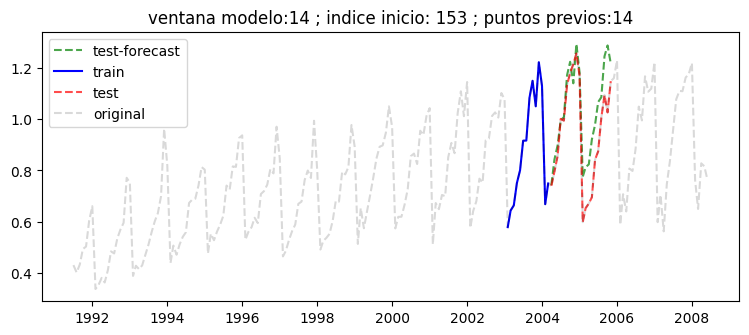

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.096


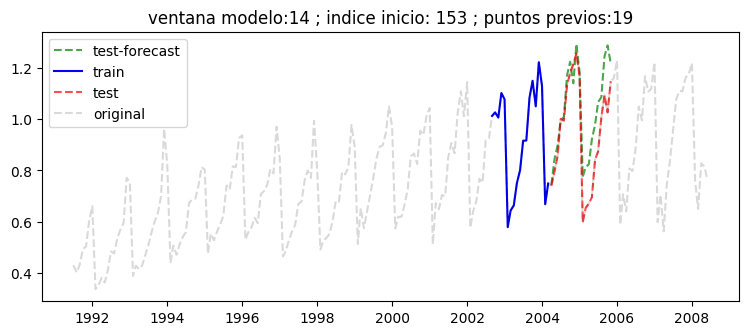

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.096


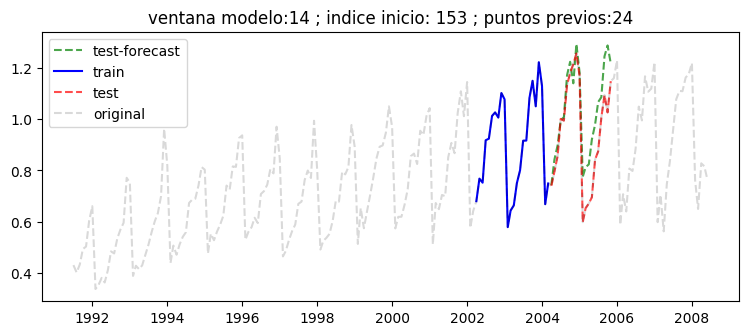

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.096


In [48]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana mas grande
modelo_max_lag = np.max([modelo.model_orders["ar"],modelo.model_orders["ma"]])

# Ventana movil de puntos a predecir
for ii in range(max_lag+modelo_max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-modelo_max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(modelo_max_lag,modelo_max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]
            
            # Prediccion de valores
            start_time = df.iloc[ii-largo:ii+1].index[-1]
            end_time = df.iloc[ii-largo:ii+largo_test].index[-1]
            pred_df_new = modelo.predict(start=start_time,end=end_time,dynamic=True)
            

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(modelo_max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass

# Parte 7 - Modelos ARIMA/SARIMA/SARIMAX con variables exogenas

In [6]:
# Datos 5 - Ejemplo datos de prediccion h2o

url = ('https://raw.githubusercontent.com/JoaquinAmatRodrigo/skforecast/master/data/h2o.csv')
df = pd.read_csv(url, sep=',', header=0, names=['y', 'datetime'])

########################
# Dar formato a datos

# Columna de tiempo
var_tiempo = "datetime"

# Formato de datos
df['datetime'] = pd.to_datetime(df[var_tiempo])

# Dar formato a estampa de tiempo
formato = '%Y/%m/%d'
df["datetime"] = df["datetime"].dt.strftime(formato)
df['datetime'] = pd.to_datetime(df["datetime"],format=formato)

# Seteo como indice de estampa de tiempo
df = df.set_index("datetime")

# eliminar columna
try:
    df.drop(columns=[var_tiempo],inplace=True)
except:
    pass

# cambiar de nombre
df.rename(columns={"Daily minimum temperatures":"y"},inplace=True)

# Convertir a tipo numerico
df["y"] = pd.to_numeric(df["y"],errors="coerce")

# ordenar segun indice
df = df.sort_index()

##################

print('Cantidad registros inicio raw :',df.shape[0])

# Setear frecuencia
df = df.asfreq(freq="MS")

print('Cantidad registros seteo freq :',df.shape[0])

###################

# Completar registros con NaN (Nulos)
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - pre datos raw :',df_nan.shape[0])

# Interpolar - en caso existan datos faltantes
orden_polinomio = 5
df= df.interpolate(method="polynomial",order=orden_polinomio,limit_direction="forward")
print('Orden polinomio interpolacion :',orden_polinomio)

# Posterior a interpolacion
df_nan = df[df.isnull().any(axis=1)].copy()
print('Datos con NaN - post interpola:',df_nan.shape[0])

###################

df

Cantidad registros inicio raw : 204
Cantidad registros seteo freq : 204
Datos con NaN - pre datos raw : 0
Orden polinomio interpolacion : 5
Datos con NaN - post interpola: 0


,y
datetime,
1991-07-01,0.429795
1991-08-01,0.400906
1991-09-01,0.432159
1991-10-01,0.492543
1991-11-01,0.502369
...,...
2008-02-01,0.761822
2008-03-01,0.649435
2008-04-01,0.827887


Descomposición segun modelo aditivo


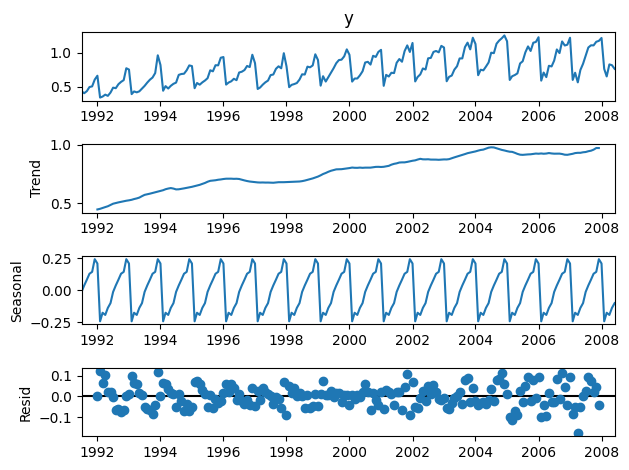

In [5]:
# [modelo Aditivo] Descomposicion de señal

from statsmodels.tsa.seasonal import seasonal_decompose

decomp = seasonal_decompose(df["y"],model="additive")

print('Descomposición segun modelo aditivo')
decomp.plot()
plt.show()

Descomposición segun modelo multiplicativo


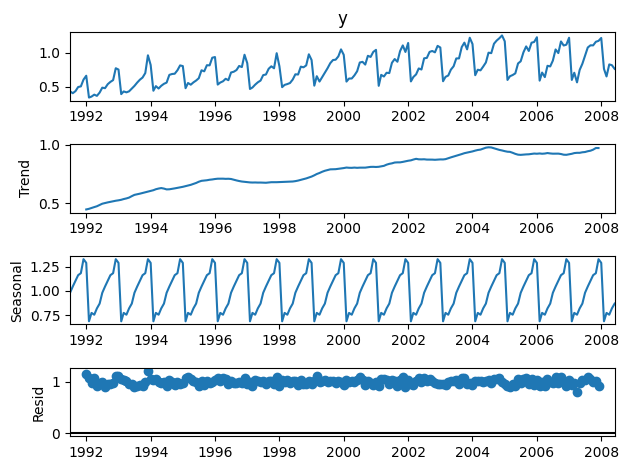

In [6]:
# [modelo Multiplicativo] Descomposicion de señal

from statsmodels.tsa.seasonal import seasonal_decompose

decomp = seasonal_decompose(df["y"],model="multiplicative")

print('Descomposición segun modelo multiplicativo')
decomp.plot()
plt.show()

In [7]:
# Crear nuevas columnas

# Variables numericas
df["x1"] = [1.5*np.cos(i) for i in range(df.shape[0])]
df["x2"] = [0.76*np.sin(i) for i in range(df.shape[0])]
df["x3"] = [0.85*(0.95*np.sin(0.875*i) + 1.16*np.cos(1.34*i)) for i in range(df.shape[0])]

# Variable categorica - Se deben convertir a numericos (one-hot encoder o similar)
#aleatorio = pd.DataFrame({"aleatorio":["A","B","C"]})
#df["x3"] = [aleatorio.sample(1)["aleatorio"].values[0] for i in range(df.shape[0])]

df

,y,x1,x2,x3
datetime,,,,
1991-07-01,0.429795,1.500000,0.000000,0.986000
1991-08-01,0.400906,0.810453,0.639518,0.845342
1991-09-01,0.432159,-0.624220,0.691066,-0.088241
1991-10-01,0.492543,-1.484989,0.107251,-0.230600
1991-11-01,0.502369,-0.980465,-0.575170,0.311579
...,...,...,...,...
2008-02-01,0.761822,-0.707439,-0.670167,-1.702951
2008-03-01,0.649435,0.730782,-0.663706,-1.208666
2008-04-01,0.827887,1.497124,-0.047037,0.616605


In [8]:
# Separacion datos Train-Test

puntos_test = 20
train_df = df[:-puntos_test].copy()
test_df = df[-puntos_test:].copy()

train_df.shape, test_df.shape

((184, 4), (20, 4))

In [27]:
# Busqueda de parametros modelo SARIMAX

from skforecast.model_selection_statsmodels import grid_search_sarimax

param_grid = {
    'order': [(14,0,0),(14,1,0),(16,0,0),(16,1,0),(18,0,0),(18,1,0),(20,0,0),(20,1,0)],
    'seasonal_order': [(0, 0, 0, 0)],
    'trend': [None, 'n', 'c','t','ct']
}

############################

steps_predict = test_df.shape[0]
results_grid = grid_search_sarimax(
                y = df["y"],
                exog = df.loc[:,"x1":],
                param_grid = param_grid,
                initial_train_size = train_df.shape[0],
                fixed_train_size = False,
                steps = steps_predict,
                metric = 'mean_absolute_error',
                refit = False,
                verbose = False,
                fit_kwargs = {'maxiter': 700, 'disp': 0}
               )

print(results_grid.to_markdown(tablefmt="github", index=False))

root       INFO  Number of models compared: 40
100%|█████████████████████████████████████████████████████| 40/40 [07:57<00:00, 11.94s/it]

| params                                                               |    metric | order      | seasonal_order   | trend   |
|----------------------------------------------------------------------|-----------|------------|------------------|---------|
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'c'}  | 0.0528625 | (18, 0, 0) | (0, 0, 0, 0)     | c       |
| {'order': (16, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'c'}  | 0.0530165 | (16, 0, 0) | (0, 0, 0, 0)     | c       |
| {'order': (16, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': None} | 0.0532525 | (16, 0, 0) | (0, 0, 0, 0)     |         |
| {'order': (16, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'n'}  | 0.0532525 | (16, 0, 0) | (0, 0, 0, 0)     | n       |
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': None} | 0.053279  | (18, 0, 0) | (0, 0, 0, 0)     |         |
| {'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'n'}  | 0.053279  | (18, 0, 0) | (0, 0, 0, 0) 

In [29]:
# Mejores parametros
results_grid.iloc[0].params

{'order': (18, 0, 0), 'seasonal_order': (0, 0, 0, 0), 'trend': 'c'}

In [30]:
# Entrenar modelo SARIMAX con parametros

import statsmodels.api as sm

# Definir y entrenar modelo segun mejores parametros encontrados (GridSearch)
modelo_base = sm.tsa.SARIMAX(endog = train_df["y"],
                             exog = train_df.loc[:,"x1":],
                             simple_differencing=False,
                             time_varying_regression=False,
                             **results_grid.iloc[0].params)

# Ajustar modelo
modelo = modelo_base.fit()

# Resumen
print(modelo.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  184
Model:              SARIMAX(18, 0, 0)   Log Likelihood                 265.012
Date:                Thu, 17 Nov 2022   AIC                           -484.025
Time:                        08:43:48   BIC                           -410.081
Sample:                    07-01-1991   HQIC                          -454.054
                         - 10-01-2006                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0149      0.017      0.875      0.382      -0.018       0.048
x1            -0.0008      0.005     -0.149      0.881      -0.011       0.009
x2             0.0007      0.010      0.063      0.9

In [22]:
# [INGRESO MANUAL] Entrenar modelo SARIMAX con parametros

import statsmodels.api as sm

order=(18, 0, 0)
seasonal_order=(0, 0, 0, 0)
trend='c'

# Definir y entrenar modelo segun mejores parametros encontrados (GridSearch)
modelo_base = sm.tsa.SARIMAX(endog = train_df["y"],
                             exog = train_df.loc[:,"x1":],
                             simple_differencing=False,
                             time_varying_regression=False,
                             order=order,
                             seasonal_order=seasonal_order,
                             trend = trend)

# Ajustar modelo
modelo = modelo_base.fit()

# Resumen
print(modelo.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  184
Model:              SARIMAX(18, 0, 0)   Log Likelihood                 265.012
Date:                Thu, 17 Nov 2022   AIC                           -484.025
Time:                        08:29:26   BIC                           -410.081
Sample:                    07-01-1991   HQIC                          -454.054
                         - 10-01-2006                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0149      0.017      0.875      0.382      -0.018       0.048
x1            -0.0008      0.005     -0.149      0.881      -0.011       0.009
x2             0.0007      0.010      0.063      0.9

Evaluar modelo entrenado

In [31]:
# Prediccion de valores con SARIMAX entrenado

int_conf = 0.95 
print('Intervalo de confianza de:',np.round(100.*int_conf,1),'%')

pred_detalle = modelo.get_forecast(steps=test_df.shape[0],conf_int=int_conf,exog=test_df.loc[:,"x1":])
print(pred_detalle.summary_frame())

Intervalo de confianza de: 95.0 %
y               mean   mean_se  mean_ci_lower  mean_ci_upper
2006-11-01  1.078330  0.053609       0.973258       1.183401
2006-12-01  1.193395  0.053647       1.088249       1.298541
2007-01-01  1.169432  0.059193       1.053416       1.285449
2007-02-01  0.625753  0.061026       0.506145       0.745361
2007-03-01  0.697959  0.062641       0.575186       0.820733
2007-04-01  0.648795  0.064688       0.522009       0.775581
2007-05-01  0.801330  0.065277       0.673390       0.929271
2007-06-01  0.791856  0.066240       0.662028       0.921684
2007-07-01  0.904658  0.066743       0.773843       1.035472
2007-08-01  1.012586  0.067349       0.880584       1.144588
2007-09-01  1.014660  0.067519       0.882325       1.146995
2007-10-01  1.129232  0.068287       0.995391       1.263072
2007-11-01  1.077546  0.085817       0.909347       1.245744
2007-12-01  1.185428  0.086560       1.015774       1.355083
2008-01-01  1.117726  0.090117       0.941101      

In [32]:
# [Con forecast()] Prediccion de datos test

pred_df = modelo.forecast(steps=test_df.shape[0],exog = test_df.loc[:,"x1":])
pred_df

2006-11-01    1.078330
2006-12-01    1.193395
2007-01-01    1.169432
2007-02-01    0.625753
2007-03-01    0.697959
2007-04-01    0.648795
2007-05-01    0.801330
2007-06-01    0.791856
2007-07-01    0.904658
2007-08-01    1.012586
2007-09-01    1.014660
2007-10-01    1.129232
2007-11-01    1.077546
2007-12-01    1.185428
2008-01-01    1.117726
2008-02-01    0.639124
2008-03-01    0.641498
2008-04-01    0.660587
2008-05-01    0.780813
2008-06-01    0.794685
Freq: MS, Name: predicted_mean, dtype: float64

In [33]:
# [Con predict()] Prediccion de datos test

pred_df = modelo.predict(start=test_df.index[0],end=test_df.index[-1],exog=test_df.loc[:,"x1":])
pred_df

2006-11-01    1.078330
2006-12-01    1.193395
2007-01-01    1.169432
2007-02-01    0.625753
2007-03-01    0.697959
2007-04-01    0.648795
2007-05-01    0.801330
2007-06-01    0.791856
2007-07-01    0.904658
2007-08-01    1.012586
2007-09-01    1.014660
2007-10-01    1.129232
2007-11-01    1.077546
2007-12-01    1.185428
2008-01-01    1.117726
2008-02-01    0.639124
2008-03-01    0.641498
2008-04-01    0.660587
2008-05-01    0.780813
2008-06-01    0.794685
Freq: MS, Name: predicted_mean, dtype: float64

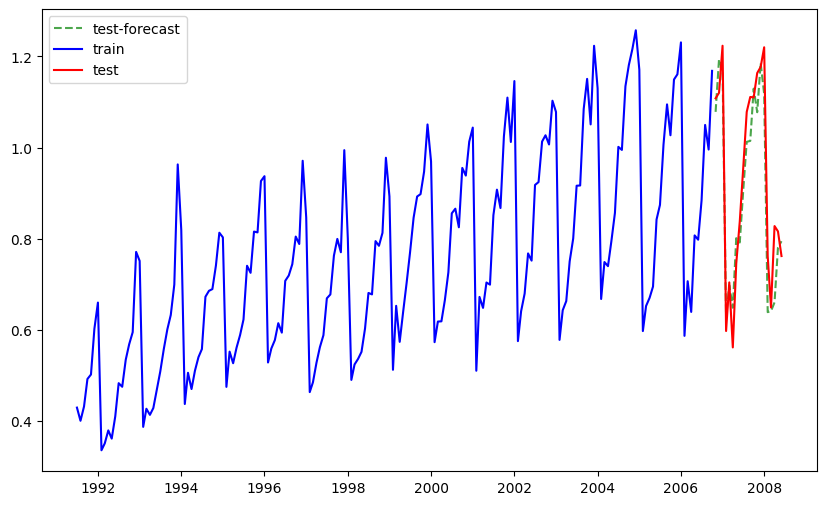

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.059


In [34]:
# Visualizar prediccion

v1 = train_df.copy()
v2 = test_df.copy()
v3 = pred_df.copy()

plt.figure(figsize=(10,6))
plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
plt.plot(v1.index,v1["y"],'-b',label='train')
plt.plot(v2.index,v2["y"],'-r',label='test')
plt.legend()
plt.show()

######################################
# Evaluar el rendimiento del modelo

# MAE: Valor de error absoluto promedio
def mae(y_hat, y_true):
    return np.mean(np.abs(y_hat-y_true))

# MAPE: Valor de error porcentual absoluto promedio
def mape(y_hat, y_true):
    return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

print(' *** Resultados en el horizonte (Test) *** ')
print('Forecast MAE : %0.3f' % mae(v3.values, v2["y"].values))

---------------------------------------------


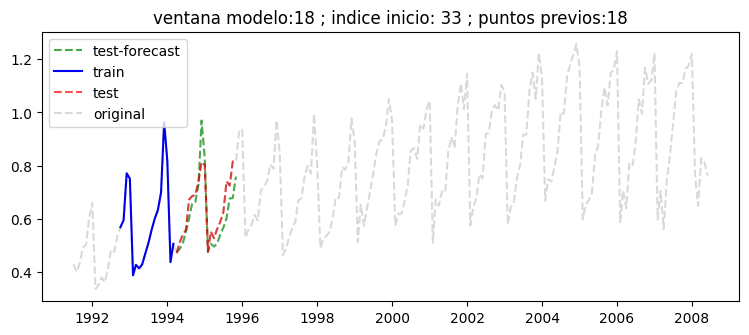

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


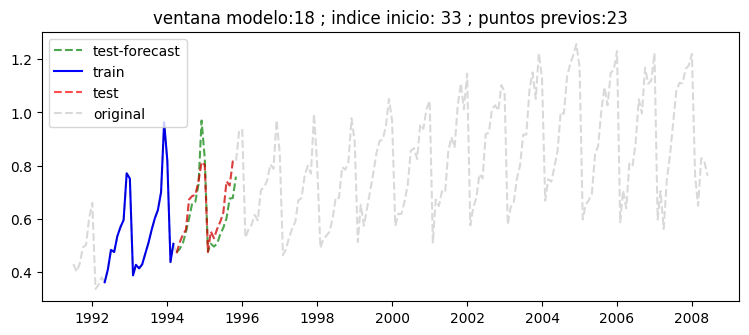

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050


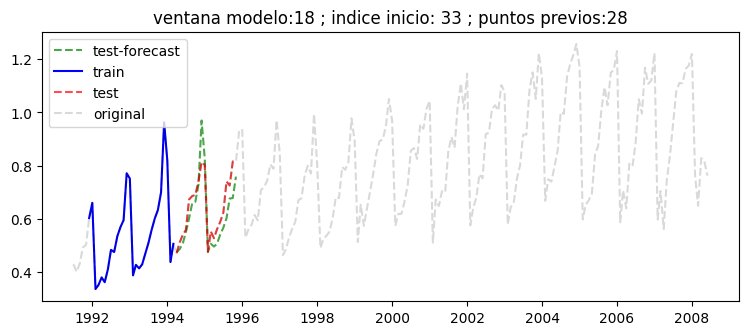

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.050
---------------------------------------------


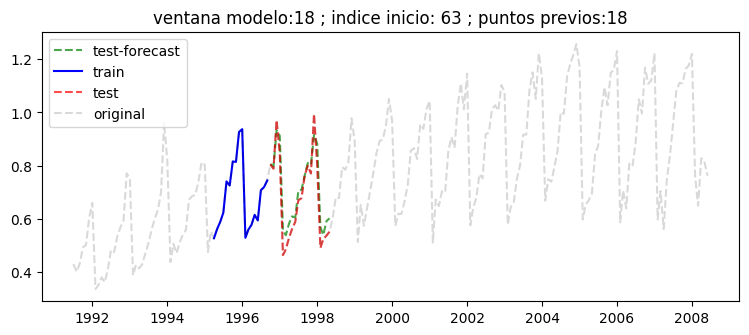

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.042


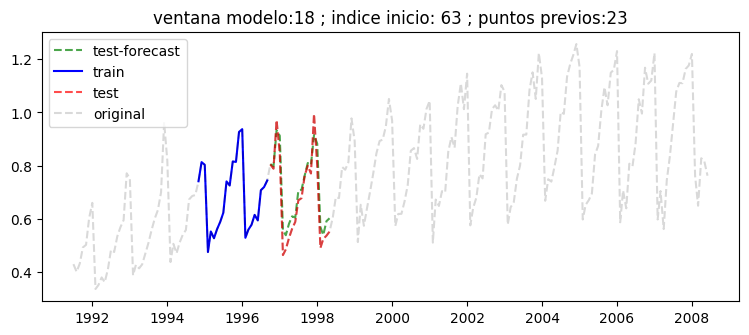

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.042


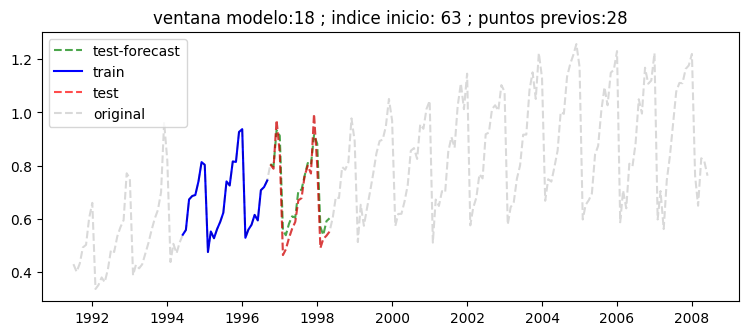

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.042
---------------------------------------------


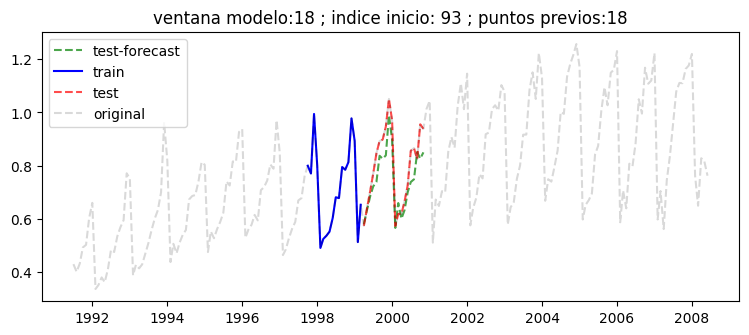

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058


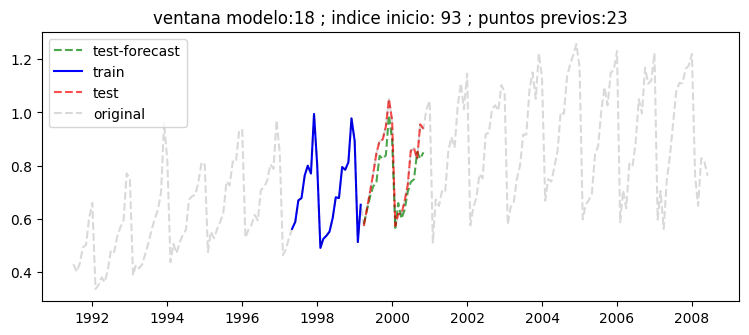

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058


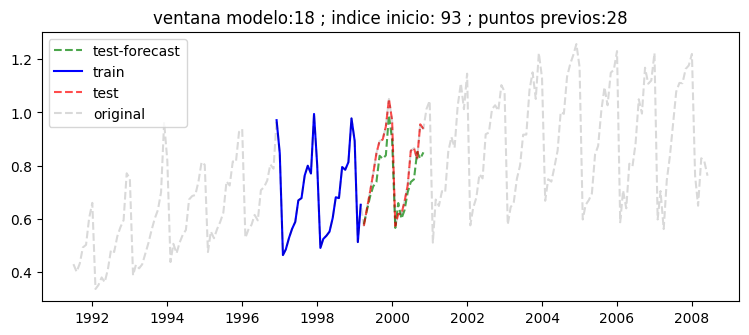

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058
---------------------------------------------


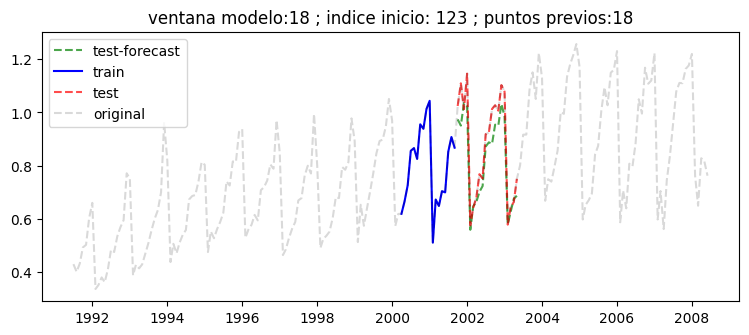

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.054


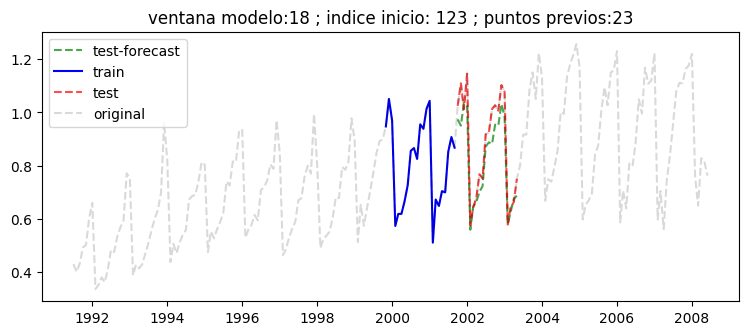

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.054


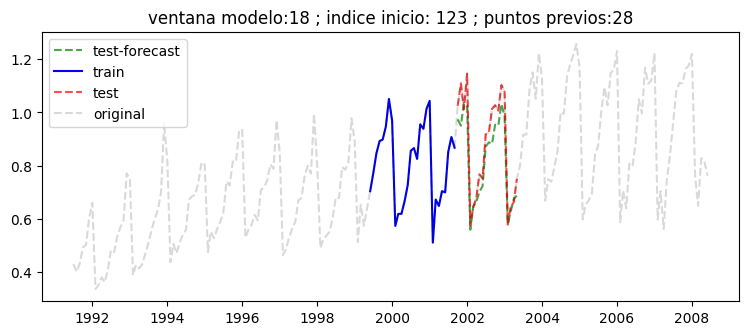

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.054
---------------------------------------------


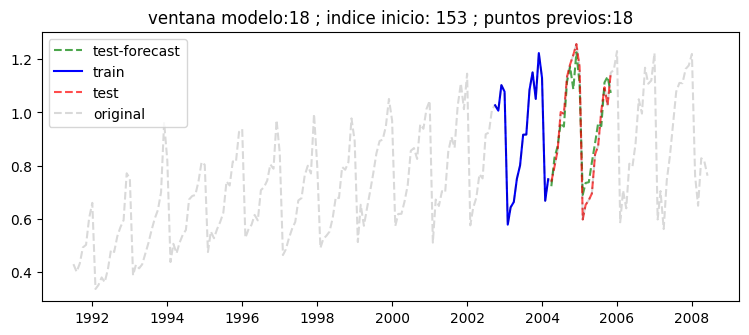

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058


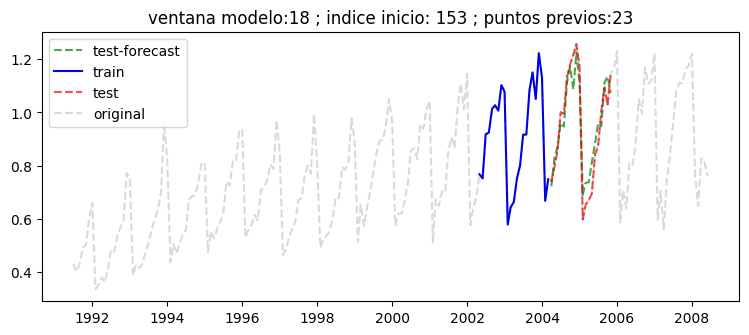

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058


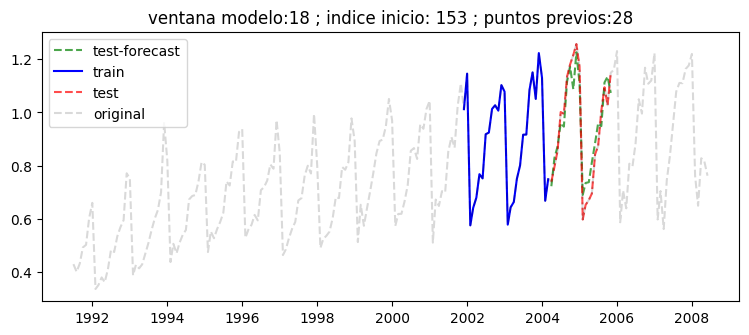

 *** Resultados en el horizonte (Test) *** 
Forecast MAE : 0.058
---------------------------------------------


In [36]:
# (Opcion 2) Predicción con rango variados de valores previos de input

# cantidad de puntos a predecir
largo_test = 20

# maximo valor de retraso adicional a aplicar
max_lag = 15

# Cantidad de lags por cada largo de input (bucle secundario)
paso_lags = 5

# Cantidd de ventanas a mover (bucle principal)
ventanas = 5

# Ventana mas grande
modelo_max_lag = np.max([modelo.model_orders["ar"],modelo.model_orders["ma"]])

# Ventana movil de puntos a predecir
for ii in range(max_lag+modelo_max_lag,df.shape[0]-largo_test,int((df.shape[0]-largo_test-max_lag-modelo_max_lag)/ventanas)):
    
    print('---------------------------------------------') # separador
    
    # Largo de puntos input previos (ver parametro en predict de "last_window")
    for largo in range(modelo_max_lag,modelo_max_lag + max_lag,paso_lags):
        try:

            # extraer datos input al modelo
            df_previos = df.iloc[ii-largo:ii]["y"]
            
            # Prediccion de valores
            start_time = df.iloc[ii-largo:ii+1].index[-1]
            end_time = df.iloc[ii-largo:ii+largo_test].index[-1]
            exog = df.loc[start_time:end_time,"x1":].copy()
            pred_df_new = modelo.predict(start=start_time,end=end_time,exog=exog,dynamic=True)

            ##############################

            # Visualizar prediccion
            v1 = df_previos.copy()
            v2 = df.iloc[ii:ii+largo_test]["y"].copy()
            v3 = pred_df_new.copy()

            # definir figura
            plt.figure(figsize=(9,3.5))
            
            plt.plot(v2.index,v3.values,'--g',label='test-forecast',alpha=0.7)
            plt.plot(v1.index,v1.values,'-b',label='train')
            plt.plot(v2.index,v2.values,'--r',label='test',alpha=0.7)
            plt.plot(df.index,df["y"],'--k',alpha=0.15,label='original') # señal original completa en gris
            
            plt.title('ventana modelo:' + str(modelo_max_lag) + ' ; indice inicio: ' + str(ii) + ' ; puntos previos:' + str(largo))
            plt.legend()
            plt.show()

            ######################################
            # Evaluar el rendimiento del modelo

            # MAE: Valor de error absoluto promedio
            def mae(y_hat, y_true):
                return np.mean(np.abs(y_hat-y_true))

            # MAPE: Valor de error porcentual absoluto promedio
            def mape(y_hat, y_true):
                return np.mean(np.abs(100.*(y_hat-y_true)/(y_true + 1e-5)))

            print(' *** Resultados en el horizonte (Test) *** ')
            print('Forecast MAE : %0.3f' % mae(v3.values, v2.values))

        except:
            pass